<a href="https://colab.research.google.com/github/RachelRamirez/CIFAR-10/blob/main/CombiningGroups_CIFAR10.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Last changed 11/11 13:09
Reminder to self, please save over AllRuns.ipynb in github/rr/cifar10/collectionoftests

Description:  batches are mixing well, but horrible accuracy for certain images, maybe thats a "good" test result?  About to pass all the groups through the augmentation, maybe 1 hour * 10 groups?  

Still need to do the CSV output

### Imports

In [110]:
 # I don't want to accidentally restart my notebook so I have a break here. 
# I'm only working from the last part of the notebook where I import the results


#@title import libraries set time
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import copy
import os
import PIL
import PIL.Image
from tensorflow import keras 
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
# import keras.utils -- dont do this!! it causes problems, 
from tensorflow.keras.utils import to_categorical  #do this instead!!
import random
import sklearn
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
import time
import pickle
from google.colab import files
import datetime # to display the current time hh:mm:ss



tic = time.time()  # Start the timer
initial_run = 0

AUTOTUNE = tf.data.experimental.AUTOTUNE
np.set_printoptions(precision=4)

#### Set Random Seeds

In [111]:
#@title
seed = 42
random.seed(seed)
tf.random.set_seed(seed)
np.random.seed()  # https://stackoverflow.com/questions/11526975/set-random-seed-programwide-in-python
shuffle_seed = seed

# Possibly Need IMGAUG to set seed in ALbumentations
# GitHub Issue: https://github.com/albumentations-team/albumentations/issues/93
import imgaug
imgaug.seed(123)


## ------------------

Set Logic-Values


In [112]:
run_model = False  #When Im looking at augmentations, I don't want to keep refitting a model, I want to just get the database of images loaded

Make Image Datasets

One of my biggest learning curves was learning how to load  the dataset with tdfs.load() and then filter on images by label.  

The second biggest was using the created model to make predictions on the test set.   

Current but "skipped" problem is trying to view misclassifeid images of results.


Another area of problems is rerunning when you've already specified a batch on your dataset creates another "batch" split so it can cause problems to rerun a cell that says how to define a dataset.  Unbatch may be needed first.    

# Create all needed DataSets

### Load Dataset

In [113]:
#@title


# A weird problem happened where it said the toronto website cant be reached, if that ever happens again make sure to go to SO for this advice https://stackoverflow.com/questions/36805640/this-error-while-downloading-datasets-valueerror-i-o-operation-on-closed-file

# How do I set IDs on: read_config.add_tfds_id = True
read_config = tfds.ReadConfig(shuffle_seed=seed) 
read_config.add_tfds_id = True  ## This didnt update ReadConfig 

dataset, info = tfds.load('cifar10', as_supervised=True, with_info=True, read_config=read_config)
x_test =  dataset["test"]
dataset  = dataset["train"]
assert isinstance(x_test, tf.data.Dataset)
#x_test = [(example.numpy(), label.numpy()) for example, label in x_test]
# once broken into numpy arrays, my model still doesn't handle it, it seems to be expecting a tensor
# So i think i have to break it into two tensors?  test_x, test_y?
# x_test[0][0]
# x_test[0][1]
# x_test = pd.DataFrame(x_test, columns=['example', 'label'])
# x_test = tf.data.Dataset.from_generator(lambda: x_test, (tf.int64, tf.int16))
# x_list = list(x_test.as_numpy_iterator())  # Crashes Google Colab!
# print(x_list[:5])


#  I got this from stack-overflow.  Need this code to define y_test, the labels of testset

def get_labels_from_tfdataset(tfdataset, batched=False):
    labels = list(map(lambda x: x[1], tfdataset)) # Get labels 
    if not batched:
        return tf.concat(labels, axis=0) # concat the list of batched labels
    return labels
y_test = get_labels_from_tfdataset(x_test)

# tfds.as_dataframe(dataset.take(5), info)  #does not display image ID :-( )

dataset_airplanes   = dataset.filter(lambda img, label: label == 0)
dataset_automobiles = dataset.filter(lambda img, label: label == 1)
dataset_birds       = dataset.filter(lambda img, label: label == 2)
dataset_cats        = dataset.filter(lambda img, label: label == 3)
dataset_deers       = dataset.filter(lambda img, label: label == 4)
dataset_dogs        = dataset.filter(lambda img, label: label == 5)
dataset_frogs       = dataset.filter(lambda img, label: label == 6)
dataset_horses      = dataset.filter(lambda img, label: label == 7)
dataset_ships       = dataset.filter(lambda img, label: label == 8)
dataset_trucks      = dataset.filter(lambda img, label: label == 9)

##  Ways to count the number of images in the sets:
print("There are ways to count and verify the number per training set which i have hidden because they are costly")
print("Entire Training Dataset was originally cardinality:", tf.data.experimental.cardinality(dataset).numpy()) #   prints 50,000, correct
print("Entire Airplane Training Dataset was originally cardinality:", tf.data.experimental.cardinality(dataset_airplanes).numpy()) #   prints -2 this is a "feature" in tf when a set takes too long to count
# print(dataset_airplanes.reduce(np.int64(0), lambda x,_ : x + 1).numpy()) #prints 5000, correct

##  This is a way of asserting that all the images have the same label in a set
# for img, label in dataset_dogs:
#   assert label == 5
 

There are ways to count and verify the number per training set which i have hidden because they are costly
Entire Training Dataset was originally cardinality: 50000
Entire Airplane Training Dataset was originally cardinality: -2


### Show Examples in the Three Train/Val/Test Sets.  Count CIFAR 10 Functions

In [114]:
#@title 'count_cifar10_class' { form-width: "1px" }
# define a fuction to count the numbre of each class
# I'm not going to worry about it now, but if i had time to cleanup code I would 
# Try to use this type of if/zip structure  https://stackoverflow.com/questions/57784643/if-statement-and-zip



 
def count_cifar10_class(datasetpassed):
  # takes the datasetpassed and returns the number of each category as a ten-tupple
  num_airplanes, num_automobiles, num_birds, num_cats, num_deers = 0,0,0,0,0
  num_dogs, num_frogs, num_horses, num_ships, num_trucks= 0, 0, 0,0,0


  # print("Unbatched?" , check_if_unbatched(datasetpassed))
  # print("Take?", check_if_take(datasetpassed))
  # print("Unbatched or Take?", ( check_if_unbatched(datasetpassed) or  check_if_take(datasetpassed)))

  if ( check_if_unbatched(datasetpassed) or  check_if_take(datasetpassed)):
    if check_if_take(datasetpassed):
      datasetpassed = make_unbatched(datasetpassed)

    for img, label in datasetpassed:
      if label == 0:
        num_airplanes += 1

      if label == 1:
        num_automobiles += 1

      if label == 2:
        num_birds +=1

      if label == 3:
        num_cats +=1

      if label ==4: 
        num_deers += 1

      if label == 5:
        num_dogs += 1 

      if label == 6:
          num_frogs += 1

      if label == 7:
        num_horses += 1

      if label == 8:
        num_ships +=1 

      if label == 9: 
        num_trucks +=1
    
    return num_airplanes, num_automobiles, num_birds, num_cats, num_deers, num_dogs, num_frogs, num_horses, num_ships, num_trucks 
  # else if the dataset is not batched or if one batch from take is being passed, proceed to counting thing below 
  else:
    print(" ** Dataset is batched, please pass 1 batch at a time to cifar10 to see metrics ** ")



  




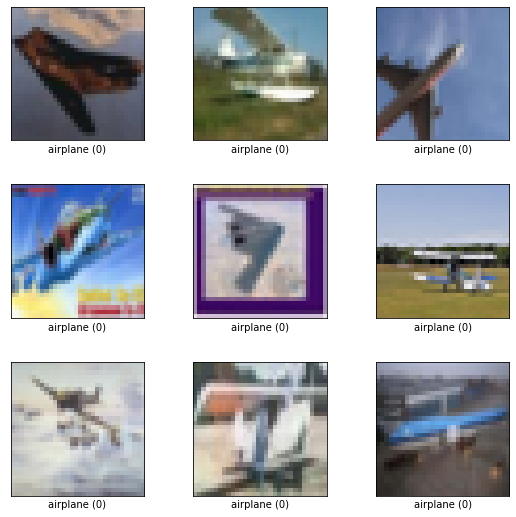

In [115]:
#@title ShowExamplesofDatasetAirplanes
## Tfds.show_examples is a matplotlib funnction that only works on image ds's, and you have to pass it the "info" for some reason
fig = tfds.show_examples(dataset_airplanes, info)

How to display one picture of a dataset using `next(iter(dataset)`

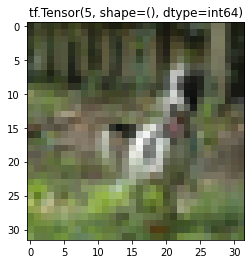

In [116]:
#@title ShowExampleofOneIterations of DatasetDogs { form-width: "20px" }
# I wish I could display ID!!

img, label = next(iter(dataset_dogs))
plt.title(str(label))
plt.imshow(img)

#0x7f6e309eff10?


## Create validation set of 10,000 images

In [117]:
#@title
# I want 10 un replicated samples from dataset_airplanes + dataset_automobiles... dataset_trucks.

# There are 5000 images of each Class 
# I want 10 equal sets A, B, C, D, ... J plus a validation set
# I want 10,000 total images in the validation set with 1000 of each class
# and I want 10 sets of training images  4000 total images, so 400 images in each class

N = 1000
dataset_airplanes_val   = dataset_airplanes.take(N)
dataset_automobiles_val  = dataset_automobiles.take(N)
dataset_birds_val       = dataset_birds.take(N)  
dataset_cats_val        = dataset_cats.take(N)
dataset_deers_val       = dataset_deers.take(N)
dataset_dogs_val        = dataset_dogs.take(N)
dataset_frogs_val       = dataset_frogs.take(N)
dataset_horses_val      = dataset_horses.take(N)
dataset_ships_val       = dataset_ships.take(N)
dataset_trucks_val      = dataset_trucks.take(N)


# Make sure to skip the next 1000 images in each data set before making training set
dataset_airplanes   = dataset_airplanes.skip(N)
dataset_automobiles  = dataset_automobiles.skip(N)
dataset_birds      = dataset_birds.skip(N)  
dataset_cats        = dataset_cats.skip(N)
dataset_deers       = dataset_deers.skip(N)
dataset_dogs        = dataset_dogs.skip(N)
dataset_frogs       = dataset_frogs.skip(N)
dataset_horses      = dataset_horses.skip(N)
dataset_ships       = dataset_ships.skip(N)
dataset_trucks      = dataset_trucks.skip(N)

# # Check that remaining dataset does not have validation data
# fig = tfds.show_examples(dataset_ships, info)
# fig = tfds.show_examples(dataset_ships_val, info)
# # I checked and they dont.


# NOW, How do I combine my val sets?

# Hint1 its not this... 
# val = dataset_airplanes_val + dataset_automobile_val + dataset_birds_val

# #  Hint2 its also not this implementation of zip because the info file doesn't match it
# val = tf.data.Dataset.zip((dataset_airplanes_val,
#                     dataset_automobile_val,
#                     dataset_birds_val,
#                     dataset_cats_val,
#                     dataset_deers_val,
#                     dataset_dogs_val,
#                     dataset_frogs_val,
#                     dataset_horses_val,
#                     dataset_ships_val,
#                     dataset_trucks_val ))
 
# fig = tfds.show_examples(val, info)   # Returns a warning that the info file is not compatible


# is it concatenate? YESSSSSSSSSSSSSSSSSSSSSS
val = dataset_airplanes_val.concatenate(dataset_automobiles_val)
# This is how I checked that it worked
# fig = tfds.show_examples(val.skip(999), info)    # shows 1 airplane and then 8 automobiles

val = val.concatenate(dataset_birds_val)
val = val.concatenate(dataset_cats_val)
val = val.concatenate(dataset_deers_val)
val = val.concatenate(dataset_dogs_val)
val = val.concatenate(dataset_frogs_val)
val = val.concatenate(dataset_horses_val)
val = val.concatenate(dataset_ships_val)
val = val.concatenate(dataset_trucks_val)
  
# print(val.reduce(np.int32(0), lambda x,_ : x + 1))  # this shows 10000! Thank goodness! :-)



## Create smaller training groups of each CIFAR Class sets (set Shard)

After removing the 10,000 validation set from the training-data, the remaining set has 40,000 images, 4000 images of each class.  To create smaller training-datasets of similar sizes, shard the dataset into equal pieces.

For the initial days of testing I decided on **250 images** per class for my first couple runs, which equates to 16 shards (40,000/16 = 250) .  When I wanted to study what was going on more beneath the hood for my augmentations, I decided to make the training set even more tiny so I could view all the images per training set I decided to try 1 image per class so I could easily view all the images augmeted and not augmented.  This meant I needed **4000 shards!** for troubleshooting.



In [118]:
SHARDS=16

#### Airplanes (airplanes_A, ... airplanes_P)

In [119]:
#@title
# https://www.tensorflow.org/api_docs/python/tf/data/Dataset#shard

# Check that each of the remaining 10 datasets has only 4000 images 
# print(dataset_airplanes.reduce(np.int32(0), lambda x,_ : x + 1))  # 4000 check!

# Shard each of the remaining 10 datasets into 16 smaller groups
airplanes_A = dataset_airplanes.shard(num_shards=SHARDS, index = 0)
airplanes_B = dataset_airplanes.shard(num_shards=SHARDS, index = 1)
airplanes_C = dataset_airplanes.shard(num_shards=SHARDS, index = 2)
airplanes_D = dataset_airplanes.shard(num_shards=SHARDS, index = 3)
airplanes_E = dataset_airplanes.shard(num_shards=SHARDS, index = 4)
airplanes_F = dataset_airplanes.shard(num_shards=SHARDS, index = 5)
airplanes_G = dataset_airplanes.shard(num_shards=SHARDS, index = 6)
airplanes_H = dataset_airplanes.shard(num_shards=SHARDS, index = 7)
airplanes_I = dataset_airplanes.shard(num_shards=SHARDS, index = 8)
airplanes_J = dataset_airplanes.shard(num_shards=SHARDS, index = 9)
airplanes_K = dataset_airplanes.shard(num_shards=SHARDS, index = 10)
airplanes_L = dataset_airplanes.shard(num_shards=SHARDS, index = 11)
airplanes_M = dataset_airplanes.shard(num_shards=SHARDS, index = 12)
airplanes_N = dataset_airplanes.shard(num_shards=SHARDS, index = 13)
airplanes_O = dataset_airplanes.shard(num_shards=SHARDS, index = 14)
airplanes_P = dataset_airplanes.shard(num_shards=SHARDS, index = 15)

#check that a random airplane dataset only has 250 images
# print(airplanes_M.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!


#### Automobiles

In [120]:
#@title
# dataset_automobile

# Check that each of the remaining 10 datasets has only 4000 images 
# print(dataset_automobile.reduce(np.int32(0), lambda x,_ : x + 1))  # 4000 check!

# Shard each of the remaining 10 datasets into 16 smaller groups
automobiles_A = dataset_automobiles.shard(num_shards=SHARDS, index = 0)
automobiles_B = dataset_automobiles.shard(num_shards=SHARDS, index = 1)
automobiles_C = dataset_automobiles.shard(num_shards=SHARDS, index = 2)
automobiles_D = dataset_automobiles.shard(num_shards=SHARDS, index = 3)
automobiles_E = dataset_automobiles.shard(num_shards=SHARDS, index = 4)
automobiles_F = dataset_automobiles.shard(num_shards=SHARDS, index = 5)
automobiles_G = dataset_automobiles.shard(num_shards=SHARDS, index = 6)
automobiles_H = dataset_automobiles.shard(num_shards=SHARDS, index = 7)
automobiles_I = dataset_automobiles.shard(num_shards=SHARDS, index = 8)
automobiles_J = dataset_automobiles.shard(num_shards=SHARDS, index = 9)
automobiles_K = dataset_automobiles.shard(num_shards=SHARDS, index = 10)
automobiles_L = dataset_automobiles.shard(num_shards=SHARDS, index = 11)
automobiles_M = dataset_automobiles.shard(num_shards=SHARDS, index = 12)
automobiles_N = dataset_automobiles.shard(num_shards=SHARDS, index = 13)
automobiles_O = dataset_automobiles.shard(num_shards=SHARDS, index = 14)
automobiles_P = dataset_automobiles.shard(num_shards=SHARDS, index = 15)


#check that a random airplane dataset only has 250 images
# print(airplanes_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

#### Birds

In [121]:
#@title
# dataset_birds

# Shard each of the remaining 10 datasets into 16 smaller groups
birds_A = dataset_birds.shard(num_shards=SHARDS, index = 0)
birds_B = dataset_birds.shard(num_shards=SHARDS, index = 1)
birds_C = dataset_birds.shard(num_shards=SHARDS, index = 2)
birds_D = dataset_birds.shard(num_shards=SHARDS, index = 3)
birds_E = dataset_birds.shard(num_shards=SHARDS, index = 4)
birds_F = dataset_birds.shard(num_shards=SHARDS, index = 5)
birds_G = dataset_birds.shard(num_shards=SHARDS, index = 6)
birds_H = dataset_birds.shard(num_shards=SHARDS, index = 7)
birds_I = dataset_birds.shard(num_shards=SHARDS, index = 8)
birds_J = dataset_birds.shard(num_shards=SHARDS, index = 9)
birds_K = dataset_birds.shard(num_shards=SHARDS, index = 10)
birds_L = dataset_birds.shard(num_shards=SHARDS, index = 11)
birds_M = dataset_birds.shard(num_shards=SHARDS, index = 12)
birds_N = dataset_birds.shard(num_shards=SHARDS, index = 13)
birds_O = dataset_birds.shard(num_shards=SHARDS, index = 14)
birds_P = dataset_birds.shard(num_shards=SHARDS, index = 15)

#check that a random airplane dataset only has 250 images
# print(airplanes_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

#### Cats

In [122]:
#@title
# dataset_cats

# Shard each of the remaining 10 datasets into 16 smaller groups
cats_A = dataset_cats.shard(num_shards=SHARDS, index = 0)
cats_B = dataset_cats.shard(num_shards=SHARDS, index = 1)
cats_C = dataset_cats.shard(num_shards=SHARDS, index = 2)
cats_D = dataset_cats.shard(num_shards=SHARDS, index = 3)
cats_E = dataset_cats.shard(num_shards=SHARDS, index = 4)
cats_F = dataset_cats.shard(num_shards=SHARDS, index = 5)
cats_G = dataset_cats.shard(num_shards=SHARDS, index = 6)
cats_H = dataset_cats.shard(num_shards=SHARDS, index = 7)
cats_I = dataset_cats.shard(num_shards=SHARDS, index = 8)
cats_J = dataset_cats.shard(num_shards=SHARDS, index = 9)
cats_K = dataset_cats.shard(num_shards=SHARDS, index = 10)
cats_L = dataset_cats.shard(num_shards=SHARDS, index = 11)
cats_M = dataset_cats.shard(num_shards=SHARDS, index = 12)
cats_N = dataset_cats.shard(num_shards=SHARDS, index = 13)
cats_O = dataset_cats.shard(num_shards=SHARDS, index = 14)
cats_P = dataset_cats.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(cats_P.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

#### Deer(s)

In [123]:
#@title
# dataset_deers
# Shard each of the remaining 10 datasets into 16 smaller groups
deers_A = dataset_deers.shard(num_shards=SHARDS, index = 0)
deers_B = dataset_deers.shard(num_shards=SHARDS, index = 1)
deers_C = dataset_deers.shard(num_shards=SHARDS, index = 2)
deers_D = dataset_deers.shard(num_shards=SHARDS, index = 3)
deers_E = dataset_deers.shard(num_shards=SHARDS, index = 4)
deers_F = dataset_deers.shard(num_shards=SHARDS, index = 5)
deers_G = dataset_deers.shard(num_shards=SHARDS, index = 6)
deers_H = dataset_deers.shard(num_shards=SHARDS, index = 7)
deers_I = dataset_deers.shard(num_shards=SHARDS, index = 8)
deers_J = dataset_deers.shard(num_shards=SHARDS, index = 9)
deers_K = dataset_deers.shard(num_shards=SHARDS, index = 10)
deers_L = dataset_deers.shard(num_shards=SHARDS, index = 11)
deers_M = dataset_deers.shard(num_shards=SHARDS, index = 12)
deers_N = dataset_deers.shard(num_shards=SHARDS, index = 13)
deers_O = dataset_deers.shard(num_shards=SHARDS, index = 14)
deers_P = dataset_deers.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(deers_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

In [124]:
#@title


In [125]:
#@title


#### Dogs

In [126]:
#@title
# dataset_dogs
# Shard each of the remaining 10 datasets into 16 smaller groups
dogs_A = dataset_dogs.shard(num_shards=SHARDS, index = 0)
dogs_B = dataset_dogs.shard(num_shards=SHARDS, index = 1)
dogs_C = dataset_dogs.shard(num_shards=SHARDS, index = 2)
dogs_D = dataset_dogs.shard(num_shards=SHARDS, index = 3)
dogs_E = dataset_dogs.shard(num_shards=SHARDS, index = 4)
dogs_F = dataset_dogs.shard(num_shards=SHARDS, index = 5)
dogs_G = dataset_dogs.shard(num_shards=SHARDS, index = 6)
dogs_H = dataset_dogs.shard(num_shards=SHARDS, index = 7)
dogs_I = dataset_dogs.shard(num_shards=SHARDS, index = 8)
dogs_J = dataset_dogs.shard(num_shards=SHARDS, index = 9)
dogs_K = dataset_dogs.shard(num_shards=SHARDS, index = 10)
dogs_L = dataset_dogs.shard(num_shards=SHARDS, index = 11)
dogs_M = dataset_dogs.shard(num_shards=SHARDS, index = 12)
dogs_N = dataset_dogs.shard(num_shards=SHARDS, index = 13)
dogs_O = dataset_dogs.shard(num_shards=SHARDS, index = 14)
dogs_P = dataset_dogs.shard(num_shards=SHARDS, index = 15)

#check that a random airplane dataset only has 250 images
# print(dogs_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!


#### Frogs

In [127]:
#@title
# dataset_frogs
# Shard each of the remaining 10 datasets into 16 smaller groups
frogs_A = dataset_frogs.shard(num_shards=SHARDS, index = 0)
frogs_B = dataset_frogs.shard(num_shards=SHARDS, index = 1)
frogs_C = dataset_frogs.shard(num_shards=SHARDS, index = 2)
frogs_D = dataset_frogs.shard(num_shards=SHARDS, index = 3)
frogs_E = dataset_frogs.shard(num_shards=SHARDS, index = 4)
frogs_F = dataset_frogs.shard(num_shards=SHARDS, index = 5)
frogs_G = dataset_frogs.shard(num_shards=SHARDS, index = 6)
frogs_H = dataset_frogs.shard(num_shards=SHARDS, index = 7)
frogs_I = dataset_frogs.shard(num_shards=SHARDS, index = 8)
frogs_J = dataset_frogs.shard(num_shards=SHARDS, index = 9)
frogs_K = dataset_frogs.shard(num_shards=SHARDS, index = 10)
frogs_L = dataset_frogs.shard(num_shards=SHARDS, index = 11)
frogs_M = dataset_frogs.shard(num_shards=SHARDS, index = 12)
frogs_N = dataset_frogs.shard(num_shards=SHARDS, index = 13)
frogs_O = dataset_frogs.shard(num_shards=SHARDS, index = 14)
frogs_P = dataset_frogs.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(frogs_A.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

#### Horses

In [128]:
#@title
# dataset_horses
# Shard each of the remaining 10 datasets into 16 smaller groups
horses_A = dataset_horses.shard(num_shards=SHARDS, index = 0)
horses_B = dataset_horses.shard(num_shards=SHARDS, index = 1)
horses_C = dataset_horses.shard(num_shards=SHARDS, index = 2)
horses_D = dataset_horses.shard(num_shards=SHARDS, index = 3)
horses_E = dataset_horses.shard(num_shards=SHARDS, index = 4)
horses_F = dataset_horses.shard(num_shards=SHARDS, index = 5)
horses_G = dataset_horses.shard(num_shards=SHARDS, index = 6)
horses_H = dataset_horses.shard(num_shards=SHARDS, index = 7)
horses_I = dataset_horses.shard(num_shards=SHARDS, index = 8)
horses_J = dataset_horses.shard(num_shards=SHARDS, index = 9)
horses_K = dataset_horses.shard(num_shards=SHARDS, index = 10)
horses_L = dataset_horses.shard(num_shards=SHARDS, index = 11)
horses_M = dataset_horses.shard(num_shards=SHARDS, index = 12)
horses_N = dataset_horses.shard(num_shards=SHARDS, index = 13)
horses_O = dataset_horses.shard(num_shards=SHARDS, index = 14)
horses_P = dataset_horses.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(horses_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

#### Ships

In [129]:
#@title
# dataset_ships
# Shard each of the remaining 10 datasets into 16 smaller groups
ships_A = dataset_ships.shard(num_shards=SHARDS, index = 0)
ships_B = dataset_ships.shard(num_shards=SHARDS, index = 1)
ships_C = dataset_ships.shard(num_shards=SHARDS, index = 2)
ships_D = dataset_ships.shard(num_shards=SHARDS, index = 3)
ships_E = dataset_ships.shard(num_shards=SHARDS, index = 4)
ships_F = dataset_ships.shard(num_shards=SHARDS, index = 5)
ships_G = dataset_ships.shard(num_shards=SHARDS, index = 6)
ships_H = dataset_ships.shard(num_shards=SHARDS, index = 7)
ships_I = dataset_ships.shard(num_shards=SHARDS, index = 8)
ships_J = dataset_ships.shard(num_shards=SHARDS, index = 9)
ships_K = dataset_ships.shard(num_shards=SHARDS, index = 10)
ships_L = dataset_ships.shard(num_shards=SHARDS, index = 11)
ships_M = dataset_ships.shard(num_shards=SHARDS, index = 12)
ships_N = dataset_ships.shard(num_shards=SHARDS, index = 13)
ships_O = dataset_ships.shard(num_shards=SHARDS, index = 14)
ships_P = dataset_ships.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(ships_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

#### Trucks


In [130]:
#@title
# dataset_trucks
# Shard each of the remaining 10 datasets into 16 smaller groups
trucks_A = dataset_trucks.shard(num_shards=SHARDS, index = 0)
trucks_B = dataset_trucks.shard(num_shards=SHARDS, index = 1)
trucks_C = dataset_trucks.shard(num_shards=SHARDS, index = 2)
trucks_D = dataset_trucks.shard(num_shards=SHARDS, index = 3)
trucks_E = dataset_trucks.shard(num_shards=SHARDS, index = 4)
trucks_F = dataset_trucks.shard(num_shards=SHARDS, index = 5)
trucks_G = dataset_trucks.shard(num_shards=SHARDS, index = 6)
trucks_H = dataset_trucks.shard(num_shards=SHARDS, index = 7)
trucks_I = dataset_trucks.shard(num_shards=SHARDS, index = 8)
trucks_J = dataset_trucks.shard(num_shards=SHARDS, index = 9)
trucks_K = dataset_trucks.shard(num_shards=SHARDS, index = 10)
trucks_L = dataset_trucks.shard(num_shards=SHARDS, index = 11)
trucks_M = dataset_trucks.shard(num_shards=SHARDS, index = 12)
trucks_N = dataset_trucks.shard(num_shards=SHARDS, index = 13)
trucks_O = dataset_trucks.shard(num_shards=SHARDS, index = 14)
trucks_P = dataset_trucks.shard(num_shards=SHARDS, index = 15)


#check that a random airplane dataset only has 250 images
# print(trucks_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!


## Concatenate the smaller CIFAR classes sets into 10 independent small  training Groups: 

This is the `train_A`, `train_B`, `train_C`... `train_J`  datasets of 1 image each class, 10 images total, currently ao 11/10/21. and will be updated to  whatever the current SHARD is later

#### Group A  (train_A)

In [131]:
#@title
# {A}
X = birds_A, cats_A, deers_A, dogs_A, frogs_A, horses_A, ships_A, trucks_A
train_A = airplanes_A.concatenate(automobiles_A)

for i in list(X):
  train_A = train_A.concatenate(i) 

print(train_A.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

tf.Tensor(2500, shape=(), dtype=int32)


Show Example of Images in Train_A

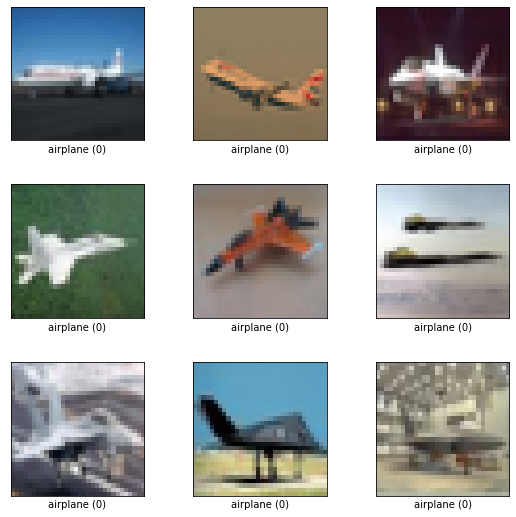

In [132]:
fig = tfds.show_examples(train_A,info)
#if you do not assign it to fig, it will show twice!


#### Group B

In [133]:
#@title
# {B}
X = birds_B, cats_B, deers_B, dogs_B, frogs_B, horses_B, ships_B, trucks_B
train_B = airplanes_B.concatenate(automobiles_B)

for i in list(X):
  train_B = train_B.concatenate(i)

# print(train_B.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group C

In [134]:
#@title
# {C}
X = birds_C, cats_C, deers_C, dogs_C, frogs_C, horses_C, ships_C, trucks_C
train_C = airplanes_C.concatenate(automobiles_C)

for i in list(X):
  train_C = train_C.concatenate(i)

# print(train_C.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group D

In [135]:
#@title
# {D}
X = birds_D, cats_D, deers_D, dogs_D, frogs_D, horses_D, ships_D, trucks_D
train_D = airplanes_D.concatenate(automobiles_D)

for i in list(X):
  train_D = train_D.concatenate(i)

# print(train_D.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group E

In [136]:
#@title
# {E}
X = birds_E, cats_E, deers_E, dogs_E, frogs_E, horses_E, ships_E, trucks_E
train_E = airplanes_E.concatenate(automobiles_E)

for i in list(X):
  train_E = train_E.concatenate(i)

# print(train_E.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group F

In [137]:
#@title
# {F}
X = birds_F, cats_F, deers_F, dogs_F, frogs_F, horses_F, ships_F, trucks_F
train_F = airplanes_F.concatenate(automobiles_F)

for i in list(X):
  train_F = train_F.concatenate(i)

# print(train_F.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group G

In [138]:
#@title
# {G}
X = birds_G, cats_G, deers_G, dogs_G, frogs_G, horses_G, ships_G, trucks_G
train_G = airplanes_G.concatenate(automobiles_G)

for i in list(X):
  train_G = train_G.concatenate(i)

# print(train_G.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group H

In [139]:
#@title
# {H}
X = birds_H, cats_H, deers_H, dogs_H, frogs_H, horses_H, ships_H, trucks_H
train_H = airplanes_H.concatenate(automobiles_H)

for i in list(X):
  train_H = train_H.concatenate(i)

# print(train_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group I

In [140]:
#@title
# {I}
X = birds_I, cats_I, deers_I, dogs_I, frogs_I, horses_I, ships_I, trucks_I
train_I = airplanes_I.concatenate(automobiles_I)

for i in list(X):
  train_I = train_I.concatenate(i)

# print(train_I.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

#### Group J

In [141]:
# #@title
# # {J}
# X = birds_J, cats_J, deers_J, dogs_J, frogs_J, horses_J, ships_J, trucks_J
# train_J = airplanes_J.concatenate(automobiles_J)

# for i in list(X):
#   train_J = train_J.concatenate(i)

# # print(train_J.reduce(np.int32(0), lambda x,_ : x + 1))  # 250*10 = 2500? 

Testing out whether I can see IDs again...

I added some code before the lines to load dataset, they are as follows#
from https://www.tensorflow.org/datasets/api_docs/python/tfds/load#args
and https://www.tensorflow.org/datasets/determinism



> read_config code added


```
read_config = tfds.ReadConfig(shuffle_seed=seed) 
read_config.add_tfds_id = True
dataset, info = tfds.load('cifar10', as_supervised=True, with_info=True, read_config=read_config)
```


I want to make sure the rest of my scripts run fine before any more tinkering!

In [142]:
# # I believe I need to define the shuffle number for the Train_A set by using the total number of images in it, not just an arbitrarily large number?
# # count = count_images(train_A)
# # unbatch_train_A = (tf.data.Dataset.unbatch(train_A))
# # count = count_images(unbatch_train_A)

# #this changes everytime i run it

# # for id, img, label in unbatch_train_A:
# #   print(label)  # this appears to be the labels of the image in unbatchtrain_A (7, 6, 4, 2, 1, 3, 9, 5, 8, 0)
# #   #print(img)  # these are each of the images 32*32*3
# #   print(id)
 
# tfds.as_dataframe(dataset.take(5), info)  #it doesn't look like IDS is being returned in info

# print(info)


### Adding Batches, Buffers, Shuffles and Caches to Val, Test, and Train_A

The following is necessary to run the datasets through the CNN models  Do not run the following more than once because it'll try to make an additional "batch" dimension in your datasets

The result of running `print(info)`:

> CIFAR10 Info
```
tfds.core.DatasetInfo(    
    name='cifar10',
    version=3.0.2,    
    description='The CIFAR-10 dataset consists of 60000 32x32 colour images in 10 classes, with 6000 images per class. There are 50000 training images and 10000 test images.',   
    homepage='https://www.cs.toronto.edu/~kriz/cifar.html',   
    features=FeaturesDict({   
        'id': Text(shape=(), dtype=tf.string),   
        'image': Image(shape=(32, 32, 3), dtype=tf.uint8),   
        'label': ClassLabel(shape=(), dtype=tf.int64, num_classes=10),   
    }),   
    total_num_examples=60000,   
    splits={   
        'test': 10000,   
        'train': 50000,   
    },   
    supervised_keys=('image', 'label'),   
    citation="""@TECHREPORT{Krizhevsky09learningmultiple,   
        author = {Alex Krizhevsky},   
        title = {Learning multiple layers of features from tiny images},   
        institution = {},  
        year = {2009}   
    }""",   
    redistribution_info=,   
)
```
 




### Cache/Shuffle/Batch Train A, Val, and Test Set

This step is needed to create batch sizes on val and test set to feed through model

*Troubleshooting 11/16/21** 

I figured out that what I did to Train_A was not done to Train_B... etc.  So up here I had cached.prefetched(buffer=whole training set)
then shuffled, then didn't reshuffle_each_iterations, then batched.  I believe when train_B through train_J went through, they may not have been shuffled.  So I have modified the code below to "strikeout" the code that used to show train_A, and moved it down into my more generalized code to run through all train_"X" sets, to include combinations of groups



```
#@title

train_A_shuffle_num = 2500
tran_A_batch_num    = 100

if initial_run == 0: 
    
  # AUTOTUNE = tf.data.AUTOTUNE # results in -1 which i think is code for the whole database
  ~~train_A = train_A.cache().prefetch(buffer_size=AUTOTUNE)~~
  ~~train_A = train_A.shuffle(train_A_shuffle_num, reshuffle_each_iteration=False)  #, seed=seed)~~
  ~~train_A = train_A.batch(tran_A_batch_num)~~

  val = val.cache().prefetch(buffer_size=AUTOTUNE)
  val = val.shuffle(1000)  #shuffle one time 
  val = val.batch(500)

  x_test = x_test.cache().prefetch(AUTOTUNE)
  x_test = x_test.batch(500)

else:
  pass

initial_run = initial_run+1
```



In [143]:


if initial_run == 0: 
    
  # AUTOTUNE = tf.data.AUTOTUNE # results in -1 which i think is code for the whole database
  # train_A = train_A.cache().prefetch(buffer_size=AUTOTUNE)
  # train_A = train_A.shuffle(train_A_shuffle_num, reshuffle_each_iteration=False)  #, seed=seed)
  # train_A = train_A.batch(tran_A_batch_num)  

  val = val.cache().prefetch(buffer_size=AUTOTUNE)
  val = val.shuffle(10000)  #shuffle one time 
  val = val.batch(500)

  x_test = x_test.cache().prefetch(AUTOTUNE)
  x_test = x_test.batch(500)

else:
  pass

initial_run = initial_run+1

I removed tinkering with Train_A and decided that the following code does what I want nicely



```
 
trainA_subsets = (airplanes_A, automobiles_A, birds_A, cats_A, deers_A, dogs_A, frogs_A, horses_A, ships_A, trucks_A)
  
trainA_combined = tf.data.Dataset.zip((airplanes_A, automobiles_A, birds_A, cats_A, deers_A, dogs_A, frogs_A, horses_A, ships_A, trucks_A)).flat_map(
    lambda x0, x1, x2, x3, x4, x5,x6,x7,x8,x9:
     tf.data.Dataset.from_tensors(x0).concatenate(
        tf.data.Dataset.from_tensors(x1).concatenate(
            tf.data.Dataset.from_tensors(x2).concatenate(
                tf.data.Dataset.from_tensors(x3).concatenate(
                     tf.data.Dataset.from_tensors(x4).concatenate(
                          tf.data.Dataset.from_tensors(x5).concatenate(
                               tf.data.Dataset.from_tensors(x6).concatenate(
                                    tf.data.Dataset.from_tensors(x7).concatenate(
                                         tf.data.Dataset.from_tensors(x8).concatenate(
                                              tf.data.Dataset.from_tensors(x9))
                               )
                          )
                     )
                )
            )
          )
      )
    ))
fig = tfds.show_examples(trainA_combined, info)  #works
trainA_combined_batched = make_zipped_batched(trainA_combined, 10)
pretty_display_of_dataset(trainA_combined_batched) #fails because it chcks inputdata and zip doesnt have inputdata
```



## Time required to create datasets:  23 seconds

In [144]:
#@title

toc = time.time()  
print(f"Made datasets in {toc - tic:0.4f} seconds")
!mkdir -p saved_model


Made datasets in 29.0265 seconds


Get min-max values of dataset to see whata the range is

In [145]:

def get_min_max(tfdata, text):
  print(str(text), "is ", tfdata)
  image, _ = next(iter(tfdata))
  print("test")
  print(np.min(image[0]), np.max(image[0]), "\n")


# I've decided to hide the following code, which was merely to let me see what the range of the pixel values were, and it was usually around 2-253 or so
# get_min_max(train_A, "train_A")
# get_min_max(x_test, "x_test")
# get_min_max(val, "val")



# Build CNN 

## Train the model function :


In [186]:
#@title Make a Vanilla CNN Function { form-width: "20px" }
# Make a Vanilla CNN
# One thing I'd like to add is residual connections, as Cholet mentions that is a standard practice in computer vision


def makemodel(DROPOUT):  #returns model
  num_classes = 10
  input_shape = (32, 32, 3)

  # For Reference these are the defaults
  # kernel_initializer="glorot_uniform",
  # bias_initializer="zeros",
  # padding="valid",  #valid = no padding
  # kernel_regularizer=None,
  # bias_regularizer=None,
  # activity_regularizer=None,

  initializer = tf.keras.initializers.HeUniform(seed)  #this alows the model to start from the same weights each time

  model = tf.keras.Sequential(
  [
      #keras.Input(),
      tf.keras.Input(shape=input_shape),

      layers.experimental.preprocessing.Rescaling(1./255),
      #data_augmentation,   
      layers.Conv2D(32, kernel_size=(3, 3), activation="relu", kernel_initializer=initializer, name="ConvLayer1"),
      layers.MaxPooling2D(pool_size=(2, 2), name="MaxPool1"),
      layers.BatchNormalization(name="BN1"),
   
      layers.Conv2D(64, kernel_size=(3, 3), activation="relu", kernel_initializer=initializer, name="ConvLayer2"),
      layers.MaxPooling2D(pool_size=(2, 2), name="MaxPool2"),
      layers.BatchNormalization(name="BN2"),
   
      layers.Conv2D(128, kernel_size=(3, 3), activation="relu", kernel_initializer=initializer, name="ConvLayer3"),
      layers.MaxPooling2D(pool_size=(2, 2), name="MaxPool3"),
      layers.BatchNormalization(name="BN3"),
   
      layers.Flatten(),
      layers.Dropout(DROPOUT),
      layers.Dense(512, activation="relu", kernel_initializer=initializer),
      layers.Dropout(DROPOUT),
      layers.Dense(num_classes, activation="softmax")

  ])


  model.compile(
    optimizer='adam',
    loss=tf.losses.SparseCategoricalCrossentropy(),
    metrics=['accuracy'])  #changed, added to val_accuracy
  
  print(" ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ ")
  print("Dropout:  ", DROPOUT)
  model.save_weights('saved_model/blank_model')  # Enables a fresh-restart between runs
  model.load_weights('saved_model/blank_model')

  return model

# -----------------------------------------

# I need to understand tf.function better 
# @tf.function

def trainmodel(MODEL, TRAININGDATA):   # returns TRAINEDMODEL

  history = MODEL.fit(
    TRAININGDATA,
    validation_data=(val),
    epochs=100,
    callbacks = keras.callbacks.EarlyStopping(monitor= 'val_loss', patience=15, restore_best_weights=True), 
    verbose=0# 
  )

  #I've entered show plot-loss twice to force another plot to move down the screen
  #this code would be improved if i could simply make this appear under /
  # the view_images command that displays 10 to 20 images


  # # summarize history for loss
  # x = 0
  # y = 0
  # plt.plot(x)
  # plt.plot(y)
  # plt.show()
 

  # summarize history for loss
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()
  
  plt.plot(history.history['accuracy'])
  plt.plot(history.history['val_accuracy'])
  plt.title('model accuracy')
  plt.ylabel('accuracy')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()

  val_acc_array = history.history['val_accuracy']
  val_loss_array = history.history['val_loss']

  n_epochs_best = np.argmax(val_acc_array)
  n_epochs_bestloss = np.argmin(val_loss_array)
  print("Early-Stop is on Val-Loss with patience = 15")

  
  
  print("Early Stop Epoch was: ", n_epochs_bestloss, "when  Val Loss was: ", np.min(val_loss_array), ", and Val Acc happened to be", val_acc_array[n_epochs_bestloss])
  print("Additionally, the best val acc epoch happened to be ", n_epochs_best, "when val acc was: ",  val_acc_array[n_epochs_best], "and Val Loss happened to be ",  val_loss_array[n_epochs_best] )
  if (n_epochs_bestloss > 90) or (n_epochs_best >90 ) :
    print("This is a pretty high epoch number! ********************************")

  # model.save('saved_model/my_model')




  return MODEL



# Transition to Augmentations


In [147]:
#@title Start Augmentations Timer

start_augmentations = time.time()

## Prepare the Google Colab environment for Albumentations



#### Install the latest version of Albumentations

Google Colab has an outdated version of Albumentations so we will install the latest stable version from PyPi.

In [148]:
#@title  instal augmentations
# !pip install -q -U albumentations
# !echo "$(pip freeze | grep albumentations) is successfully installed"

!pip install -U git+https://github.com/albumentations-team/albumentations -q
# necessary imports
from functools import partial
import albumentations as A
import cv2 as cv2

import tensorflow as tf
AUTOTUNE = tf.data.experimental.AUTOTUNE


## Define Augmentation Factors' Order and Levels

The following are 21 factors: 20 data-augmentation techniques and one regularization factor "*Dropout*" Percent Level, to compare with.  The order is what seemed to give each factor the most opportunity to add to the image, and more "destructive" factors were ordered later, like "ToGray" and Crop or ZoomIn since they take away image data permanently.  Zoom Out was order 11 because I wanted to make sure noise, blur, zoom, sharpen, contrast, did not have a over-magnified effect if after ZoomOut.  FlipHorizontal and FlipVertical are at the bottom not because they are destructive, but because I wanted to keep the categorical variables grouped as much as possible for consistent coding practices.

|Order | Factors | Role | Low | High |
| -: | :- | :-: | :-: | :-: |
1|*dropout*|Continuous|0.4  |0.6
2|shiftX|Continuous|0 | 0.1
3|shiftY|Continuous|0|  0.1
4|noise|Continuous|0  |24
5|blur|Continuous|0 | 7**
6|sharpen|Continuous|0 | 0.1
7|contrast|Continuous|0 | 0.2
8|brighten|Continuous|0|  0.2
9|darken (negative brightness)|Continuous|0 | -0.2 *
10|gamma|Continuous|100|  120
11|zoomOut (negative zoomin) |Continuous| 0 | -0.16*
12|rotate|Continuous|0|  14
13|crop|Continuous|32* | 24*
14|zoomin|Continuous|0  |0.16
15|flipH|Categorical|0 | 1
16|flipV|Categorical|0 | 1
17|fancyPCA|Categorical|0 | 1
18|equalize|Categorical|0 | 1
19|channelShuffle|Categorical|0 | 1
20|elasticTransform|Categorical|0 | 1
21|togray|Categorical|0 | 1

* Values with asterisks are for emphasis since they seem counterintuitive

** Blur values can only be odd so a center point will be rounded down from 3.5 to 3 - four center points were changed

A 50-run definitive screening design with 2 blocks is used to see which main effects are most important.  The JMP Metrics for this design are below:

 | Definitive Screening Design Diagnostics  | | 
| --- | --- | 
 | D Efficiency| 92.46019| 
| G Efficiency | 81.68744 | 
| A Efficiency | 91.32396 | 
| Average Variance of Prediction	 | 0.298038 |


## Define Randomized Definitive Screening Design 

**Block 1**
 
 xRun|Block|dropout|shiftX|shiftY|noise|blur|sharpen|contrast|brighten|darken|gamma|zoomOut|rotate|crop|zoomin|flipH|flipV|fancyPCA|equalize|channelShuffle|elasticTransform|togray
:-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-
1|1|0.4|0.1|0|24|7|0.1|0.2|0.2|-0.2|100|-0.08|14|24|0.16|1|1|0|1|0|1|0
2|1|0.4|0.1|0|24|7|0|0|0|0|100|-0.16|0|32|0|1|1|1|1|1|1|0
3|1|0.5|0|0|24|7|0.1|0|0.2|-0.2|100|-0.16|14|32|0.16|0|0|0|0|1|0|1
4|1|0.4|0|0.1|24|3|0.1|0|0|-0.2|100|0|0|32|0|1|1|0|0|0|1|1
5|1|0.6|0|0|0|0|0|0.2|0.2|-0.2|100|0|0|32|0.16|1|1|1|0|1|0|0
6|1|0.6|0.1|0|24|0|0.1|0.2|0|-0.2|120|-0.16|0|24|0.08|1|0|1|0|0|1|1
7|1|0.4|0|0|0|7|0|0.2|0.2|0|120|0|7|24|0|0|1|0|0|0|1|1
8|1|0.4|0.1|0.1|0|0|0.1|0.2|0.2|-0.2|100|0|0|32|0|0|0|1|1|1|1|1
9|1|0.6|0|0|24|7|0|0|0|0|120|-0.16|14|24|0.16|1|1|0|0|0|0|0
10|1|0.5|0.05|0.05|12|3|0.05|0.1|0.1|-0.1|110|-0.08|7|28|0.08|0|0|0|0|0|0|0
11|1|0.4|0|0|24|7|0.1|0.2|0.1|-0.2|120|0|0|24|0|0|0|1|1|1|0|0
12|1|0.4|0.1|0.1|24|0|0|0.2|0.2|-0.2|120|-0.16|0|32|0.16|0|1|0|1|0|0|0
13|1|0.6|0|0|0|7|0.1|0|0|0|100|0|14|24|0|1|0|1|0|1|1|1
14|1|0.6|0.05|0.1|24|7|0.1|0.2|0.2|0|120|0|14|32|0.16|1|1|1|1|1|1|1
15|1|0.4|0|0|0|7|0|0|0.2|-0.2|120|-0.16|0|32|0.16|1|0|1|1|0|1|1
16|1|0.4|0.05|0|0|0|0|0|0|-0.2|100|-0.16|0|24|0|0|0|0|0|0|0|0
17|1|0.4|0.1|0.1|24|7|0.1|0|0|0|120|-0.16|14|24|0|0|0|0|1|0|1|1
18|1|0.6|0.1|0.1|24|0|0.1|0|0|-0.2|100|-0.16|7|32|0.16|1|0|1|1|1|0|0
19|1|0.6|0|0.1|0|0|0|0|0|0|120|-0.08|0|32|0|0|0|1|0|1|0|1
20|1|0.6|0|0.1|0|0|0.1|0.2|0.2|-0.2|120|0|14|24|0.16|0|0|0|0|0|0|1
21|1|0.6|0.1|0.1|0|0|0|0|0.1|0|100|-0.16|14|32|0.16|1|1|0|0|0|1|1
22|1|0.5|0.05|0.05|12|3|0.05|0.1|0.1|-0.1|110|-0.08|7|28|0.08|1|1|1|1|1|1|1
23|1|0.6|0.1|0.1|24|0|0.1|0.2|0|0|100|0|14|24|0|0|1|0|0|1|0|0
24|1|0.6|0.1|0|0|3|0|0.2|0.2|0|120|-0.16|14|24|0.16|0|0|1|1|1|0|0
25|1|0.5|0.1|0.1|0|0|0|0.2|0|0|120|0|0|24|0|1|1|1|1|0|1|0
26|1|0.4|0|0.1|0|7|0|0|0.2|0|100|0|14|32|0.08|0|1|0|1|1|0|0


**Block 2**

xRun|Block|dropout|shiftX|shiftY|noise|blur|sharpen|contrast|brighten|darken|gamma|zoomOut|rotate|crop|zoomin|flipH|flipV|fancyPCA|equalize|channelShuffle|elasticTransform|togray
:-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-
27|2|0.6|0.1|0|12|6|0.1|0.2|0.2|0|100|-0.16|0|32|0|0|1|1|0|0|0|1
28|2|0.6|0.1|0|0|6|0|0.2|0|-0.2|100|0|14|32|0|1|0|0|1|0|0|1
29|2|0.4|0|0|24|0|0.05|0.2|0|0|100|0|14|32|0.16|0|0|1|0|0|1|0
30|2|0.6|0.1|0|24|0|0|0|0.2|0|100|0|0|24|0.16|0|0|0|1|1|1|1
31|2|0.6|0|0.1|24|6|0|0.2|0.2|-0.1|100|-0.16|0|24|0|1|0|0|0|1|1|0
32|2|0.6|0|0.1|24|6|0|0.1|0|-0.2|100|0|0|24|0.16|0|1|1|1|0|0|1
33|2|0.4|0.1|0.1|0|6|0|0.2|0|-0.2|100|-0.16|14|24|0.16|0|1|1|0|1|1|1
34|2|0.4|0|0.1|0|6|0.1|0.2|0|-0.2|120|-0.16|14|32|0|1|1|1|0|0|0|0
35|2|0.4|0.1|0.05|24|6|0|0.2|0|0|120|0|0|32|0.16|1|0|0|0|1|0|1
36|2|0.6|0|0|24|0|0.1|0|0.2|0|120|0|0|32|0|1|0|0|1|0|0|0
37|2|0.6|0.1|0.1|24|6|0|0|0.2|-0.2|120|0|14|32|0|0|0|1|0|0|1|0
38|2|0.6|0|0.1|0|6|0.1|0.2|0|0|110|-0.16|0|32|0.16|0|0|0|1|0|1|0
39|2|0.6|0|0.05|0|0|0.1|0|0.2|-0.2|100|-0.16|14|24|0|0|1|1|1|0|1|0
40|2|0.4|0|0.1|12|0|0|0|0|-0.2|120|0|14|24|0.16|1|0|0|1|1|1|0
41|2|0.6|0.1|0.1|0|6|0.05|0|0.2|-0.2|120|-0.16|0|24|0|1|1|0|1|1|0|1
42|2|0.4|0|0.1|24|0|0.1|0|0.2|0|120|-0.16|0|24|0.16|0|1|1|0|1|1|0
43|2|0.4|0.1|0|0|0|0.1|0.1|0.2|0|120|-0.16|14|32|0|1|0|0|0|1|1|0
44|2|0.4|0|0|0|0|0.1|0.2|0|0|100|-0.16|0|24|0.16|1|1|0|1|1|0|1
45|2|0.4|0.1|0|0|0|0.1|0|0|-0.1|120|0|14|32|0.16|0|1|1|1|0|0|1
46|2|0.4|0.1|0.1|0|6|0.1|0|0.2|0|100|0|0|24|0.16|1|0|1|0|0|0|0
47|2|0.4|0|0.1|24|0|0|0.2|0.2|0|100|-0.16|14|28|0|1|0|1|1|0|0|1
48|2|0.4|0.1|0|24|0|0|0|0.2|-0.2|110|0|14|24|0|1|1|1|0|1|0|1
49|2|0.6|0.1|0|0|6|0.1|0|0|-0.2|120|0|0|28|0.16|0|1|0|0|1|1|0
50|2|0.6|0|0|24|0|0|0.2|0|-0.2|120|-0.16|14|32|0|0|1|0|1|1|1|1

## Create Experimental Run Order DataFrame

In [149]:
#@title create run dataframe 
ls_all_factors = ['xRun', 'Block', 'dropout', 'shiftX', 'shiftY', 'noise', 'blur', 'sharpen', 'contrast', 'brighten', 'darken', 'gamma', 'zoomOut', 'rotate', 'crop', 'zoomin', 'flipH', 'flipV', 'fancyPCA', 'equalize', 'channelShuffle', 'elasticTransform', 'togray']

#because i added a do-nothing run, the runs really do start at index zero now, so i have delete some lines in  my for loops about run=run+1


df_experimentalruns = pd.DataFrame(	[
[0, 1, 0.5, 0, 0, 0, 0, 0, 0, 0, 0.0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], # do nothing run, watch out for mild Gamma effect
[1, 1, 0.6, 0, 0, 24, 7, 0, 0, 0, 0.2, 120, 0, 14, 0, 0.16, 1, 1, 0, 0, 0, 0, 0],
[2, 1, 0.6, 0.1, 0, 0, 3, 0, 0.2, 0.2, 0.2, 120, 0, 14, 0, 0.16, 0, 0, 1, 1, 1, 0, 0],
[3, 1, 0.4, 0.1, 0.1, 0, 0, 0.1, 0.2, 0.2, 0, 100, 0.16, 0, 8, 0, 0, 0, 1, 1, 1, 1, 1],
[4, 1, 0.5, 0.05, 0.05, 12, 3, 0.05, 0.1, 0.1, 0.1, 110, 0.08, 7, 4, 0.08, 1, 1, 1, 1, 1, 1, 1],
[5, 1, 0.4, 0, 0.1, 0, 7, 0, 0, 0.2, 0.2, 100, 0.16, 14, 8, 0.08, 0, 1, 0, 1, 1, 0, 0],
[6, 1, 0.4, 0.1, 0.1, 24, 7, 0.1, 0, 0, 0.2, 120, 0, 14, 0, 0, 0, 0, 0, 1, 0, 1, 1],
[7, 1, 0.6, 0.1, 0.1, 24, 0, 0.1, 0, 0, 0, 100, 0, 7, 8, 0.16, 1, 0, 1, 1, 1, 0, 0],
[8, 1, 0.4, 0.1, 0, 24, 7, 0, 0, 0, 0.2, 100, 0, 0, 8, 0, 1, 1, 1, 1, 1, 1, 0],
[9, 1, 0.5, 0.05, 0.05, 12, 3, 0.05, 0.1, 0.1, 0.1, 110, 0.08, 7, 4, 0.08, 0, 0, 0, 0, 0, 0, 0],
[10, 1, 0.5, 0, 0, 24, 7, 0.1, 0, 0.2, 0, 100, 0, 14, 8, 0.16, 0, 0, 0, 0, 1, 0, 1],
[11, 1, 0.6, 0, 0, 0, 7, 0.1, 0, 0, 0.2, 100, 0.16, 14, 0, 0, 1, 0, 1, 0, 1, 1, 1],
[12, 1, 0.4, 0.1, 0, 24, 7, 0.1, 0.2, 0.2, 0, 100, 0.08, 14, 0, 0.16, 1, 1, 0, 1, 0, 1, 0],
[13, 1, 0.6, 0, 0.1, 0, 0, 0, 0, 0, 0.2, 120, 0.08, 0, 8, 0, 0, 0, 1, 0, 1, 0, 1],
[14, 1, 0.4, 0.05, 0, 0, 0, 0, 0, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
[15, 1, 0.6, 0.05, 0.1, 24, 7, 0.1, 0.2, 0.2, 0.2, 120, 0.16, 14, 8, 0.16, 1, 1, 1, 1, 1, 1, 1],
[16, 1, 0.4, 0, 0.1, 24, 3, 0.1, 0, 0, 0, 100, 0.16, 0, 8, 0, 1, 1, 0, 0, 0, 1, 1],
[17, 1, 0.6, 0.1, 0.1, 24, 0, 0.1, 0.2, 0, 0.2, 100, 0.16, 14, 0, 0, 0, 1, 0, 0, 1, 0, 0],
[18, 1, 0.4, 0, 0, 24, 7, 0.1, 0.2, 0.1, 0, 120, 0.16, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0],
[19, 1, 0.6, 0, 0.1, 0, 0, 0.1, 0.2, 0.2, 0, 120, 0.16, 14, 0, 0.16, 0, 0, 0, 0, 0, 0, 1],
[20, 1, 0.6, 0, 0, 0, 0, 0, 0.2, 0.2, 0, 100, 0.16, 0, 8, 0.16, 1, 1, 1, 0, 1, 0, 0],
[21, 1, 0.6, 0.1, 0.1, 0, 0, 0, 0, 0.1, 0.2, 100, 0, 14, 8, 0.16, 1, 1, 0, 0, 0, 1, 1],
[22, 1, 0.4, 0, 0, 0, 7, 0, 0, 0.2, 0, 120, 0, 0, 8, 0.16, 1, 0, 1, 1, 0, 1, 1],
[23, 1, 0.6, 0.1, 0, 24, 0, 0.1, 0.2, 0, 0, 120, 0, 0, 0, 0.08, 1, 0, 1, 0, 0, 1, 1],
[24, 1, 0.4, 0, 0, 0, 7, 0, 0.2, 0.2, 0.2, 120, 0.16, 7, 0, 0, 0, 1, 0, 0, 0, 1, 1],
[25, 1, 0.5, 0.1, 0.1, 0, 0, 0, 0.2, 0, 0.2, 120, 0.16, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0],
[26, 1, 0.4, 0.1, 0.1, 24, 0, 0, 0.2, 0.2, 0, 120, 0, 0, 8, 0.16, 0, 1, 0, 1, 0, 0, 0],
[27, 2, 0.6, 0, 0.1, 24, 7, 0, 0.1, 0, 0, 100, 0.16, 0, 0, 0.16, 0, 1, 1, 1, 0, 0, 1],
[28, 2, 0.6, 0.1, 0, 0, 7, 0.1, 0, 0, 0, 120, 0.16, 0, 4, 0.16, 0, 1, 0, 0, 1, 1, 0],
[29, 2, 0.4, 0, 0.1, 24, 0, 0.1, 0, 0.2, 0.2, 120, 0, 0, 0, 0.16, 0, 1, 1, 0, 1, 1, 0],
[30, 2, 0.4, 0, 0, 24, 0, 0.05, 0.2, 0, 0.2, 100, 0.16, 14, 8, 0.16, 0, 0, 1, 0, 0, 1, 0],
[31, 2, 0.6, 0.1, 0.1, 24, 7, 0, 0, 0.2, 0, 120, 0.16, 14, 8, 0, 0, 0, 1, 0, 0, 1, 0],
[32, 2, 0.4, 0.1, 0, 0, 0, 0.1, 0, 0, 0.1, 120, 0.16, 14, 8, 0.16, 0, 1, 1, 1, 0, 0, 1],
[33, 2, 0.6, 0, 0, 24, 0, 0, 0.2, 0, 0, 120, 0, 14, 8, 0, 0, 1, 0, 1, 1, 1, 1],
[34, 2, 0.6, 0, 0, 24, 0, 0.1, 0, 0.2, 0.2, 120, 0.16, 0, 8, 0, 1, 0, 0, 1, 0, 0, 0],
[35, 2, 0.4, 0, 0.1, 12, 0, 0, 0, 0, 0, 120, 0.16, 14, 0, 0.16, 1, 0, 0, 1, 1, 1, 0],
[36, 2, 0.4, 0.1, 0, 0, 0, 0.1, 0.1, 0.2, 0.2, 120, 0, 14, 8, 0, 1, 0, 0, 0, 1, 1, 0],
[37, 2, 0.6, 0.1, 0.1, 0, 7, 0.05, 0, 0.2, 0, 120, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1],
[38, 2, 0.6, 0, 0.1, 24, 7, 0, 0.2, 0.2, 0.1, 100, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0],
[39, 2, 0.4, 0, 0.1, 0, 7, 0.1, 0.2, 0, 0, 120, 0, 14, 8, 0, 1, 1, 1, 0, 0, 0, 0],
[40, 2, 0.4, 0, 0.1, 24, 0, 0, 0.2, 0.2, 0.2, 100, 0, 14, 4, 0, 1, 0, 1, 1, 0, 0, 1],
[41, 2, 0.6, 0.1, 0, 0, 7, 0, 0.2, 0, 0, 100, 0.16, 14, 8, 0, 1, 0, 0, 1, 0, 0, 1],
[42, 2, 0.4, 0.1, 0.1, 0, 7, 0.1, 0, 0.2, 0.2, 100, 0.16, 0, 0, 0.16, 1, 0, 1, 0, 0, 0, 0],
[43, 2, 0.4, 0.1, 0.1, 0, 7, 0, 0.2, 0, 0, 100, 0, 14, 0, 0.16, 0, 1, 1, 0, 1, 1, 1],
[44, 2, 0.4, 0.1, 0, 24, 0, 0, 0, 0.2, 0, 110, 0.16, 14, 0, 0, 1, 1, 1, 0, 1, 0, 1],
[45, 2, 0.4, 0, 0, 0, 0, 0.1, 0.2, 0, 0.2, 100, 0, 0, 0, 0.16, 1, 1, 0, 1, 1, 0, 1],
[46, 2, 0.6, 0.1, 0, 24, 0, 0, 0, 0.2, 0.2, 100, 0.16, 0, 0, 0.16, 0, 0, 0, 1, 1, 1, 1],
[47, 2, 0.4, 0.1, 0.05, 24, 7, 0, 0.2, 0, 0.2, 120, 0.16, 0, 8, 0.16, 1, 0, 0, 0, 1, 0, 1],
[48, 2, 0.6, 0, 0.1, 0, 7, 0.1, 0.2, 0, 0.2, 110, 0, 0, 8, 0.16, 0, 0, 0, 1, 0, 1, 0],
[49, 2, 0.6, 0.1, 0, 12, 7, 0.1, 0.2, 0.2, 0.2, 100, 0, 0, 8, 0, 0, 1, 1, 0, 0, 0, 1],
[50, 2, 0.6, 0, 0.05, 0, 0, 0.1, 0, 0.2, 0, 100, 0, 14, 0, 0, 0, 1, 1, 1, 0, 1, 0]
],

index=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50], 
columns = ls_all_factors)
	
# I had to make some changes to shift x and y values bc i noticed my images were blurry from simple shifts

df_experimentalruns.loc[df_experimentalruns["shiftX"]==0.1,"shiftX"] = 0.125  #this is 4/32
df_experimentalruns.loc[df_experimentalruns["shiftX"]==0.05,"shiftX"] = 0.0625  #this is 2/32
df_experimentalruns["shiftX"]

df_experimentalruns.loc[df_experimentalruns["shiftY"]==0.1,"shiftY"] = 0.125  #this is 4/32
df_experimentalruns.loc[df_experimentalruns["shiftY"]==0.05,"shiftY"] = 0.0625  #this is 2/32  

#  Sigh of RELIEF.  Changing the percentage to "divisible" values of 32 made it so that theres no blur happening in the pictures, yay! 

## View images from the dataset function (view_image(ds))

In [150]:
#@title def check_if_unbatched(ds): { form-width: "20px" }
def check_if_unbatched(ds):
  if (ds.__class__.__name__ !='BatchDataset') and (ds._input_dataset.__class__.__name__ != 'BatchDataset') and (ds._input_dataset._input_dataset.__class__.__name__ !='BatchDataset'):
     return True
  else:
    return False

In [ ]:
#@title def check_if_batched(ds): { form-width: "20px" }
def check_if_batched(ds):
  if (ds.__class__.__name__ =='BatchDataset') or (ds._input_dataset.__class__.__name__ == 'BatchDataset') or (ds._input_dataset._input_dataset.__class__.__name__ =='BatchDataset') :
     # the above statement will evaluate to True if three subsets of the original ds are not batched
      return True
  else:
    return False

In [ ]:
#@title def check_if_take(ds)(ds): { form-width: "20px" }

def check_if_take(ds):
  if  (ds.__class__.__name__ =='TakeDataset'):
    return True
  else:
    return False

In [ ]:
#@title def make_batched(ds, batchnum): { form-width: "20px" }

def make_batched(ds, batchnum):
  if check_if_unbatched(ds):
    # the above statement will evaluate to True if three subsets of the original ds are not batched
    return ds.batch(batchnum)
  else:
    return ds

In [ ]:
#@title def make_unbatched(ds): { form-width: "20px" }
def make_unbatched(ds):
  if  check_if_batched(ds):
      # the above statement will evaluate to True if any of the three subsets are batched
      return unbatch_ds(ds)
  else:
    return ds

In [ ]:
#@title def make_zipped_batched(ds, batchnum): { form-width: "20px" }
def make_zipped_batched(ds, batchnum):
  return ds.batch(batchnum)

********************            First 10 Training Images from Group A / not yet batched or mixed            ********************


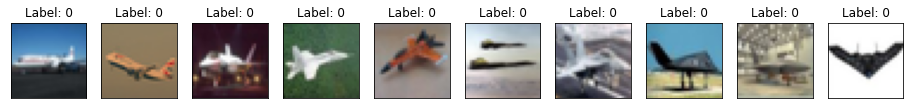

********************            First 10 Validation Images            ********************


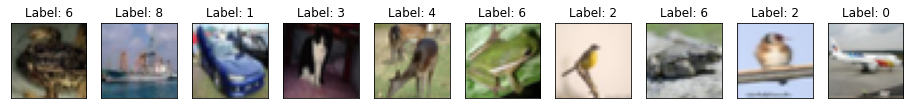

********************            First 10 Test Images            ********************


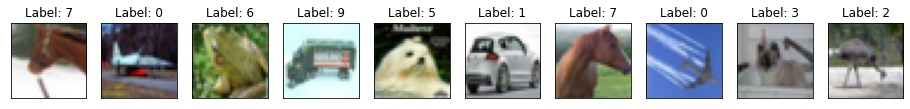

In [151]:
#@title def view_image(ds, opttext = ""):

def view_image(ds, opttext = ""):
# this function takes the dataset and automatically displays 10 figures
# the dataset has to be batched to see the images
  temp_ds  = make_batched(ds, 10)


  image, label = next(iter(temp_ds)) # extract 1 batch from the dataset
  image = image.numpy().astype("uint8")  #??  #if theres a better way to do this I'm all ears because it's costly
  label = label.numpy()   
  

  fig = plt.figure(figsize=(16, 16))
  for i in range(10):
    if i == 1:
        print("*"*20, " "*10, opttext, " "*10,  "*"*20)
    ax = fig.add_subplot(1, 10, i+1, xticks=[], yticks=[])
    ax.imshow(image[i])
    ax.set_title(f"Label: {label[i]}")
    if i == 9:
      plt.pause(0.05)  # heck yea
      


view_image(train_A, opttext = "First 10 Training Images from Group A / not yet batched or mixed")
view_image(val, opttext = "First 10 Validation Images")
view_image(x_test, opttext = "First 10 Test Images")


To integrate `albumentations` into our tensorflow pipeline we can create two functions :  
- Pipeline to apply `augmentation`.
- a function that calls the above function and pass in our data through the pipeline.
We can then wrap our 2nd Function under `tf.numpy_function` .

## Define Albumentations transforms 

In [152]:
#@title def augmentfunction(df_experimentalruns, run): { form-width: "20px" }
IMG_SIZE = 32

def augmentfunction(df_experimentalruns, run):
    
  # Instantiate augments

  cat_probability = 1
  cont_probability = 1
  random.seed(42)

  # Assign Continuous Factors Levels by Run -------------------------

  shift_limit_x_left =  df_experimentalruns.loc[run,"shiftX"]
  shift_limit_x_right = df_experimentalruns.loc[run,"shiftX"]  
  assert shift_limit_x_right >= shift_limit_x_left
  assert shift_limit_x_right <= 1  #more than one is damaging
  print("Shift X:  (", shift_limit_x_left, ",", shift_limit_x_right, ") or (",-shift_limit_x_right, ",", -shift_limit_x_left, ")" )

  shift_limit_y_left = df_experimentalruns.loc[run,"shiftY"]
  shift_limit_y_right = df_experimentalruns.loc[run,"shiftY"]  
  assert shift_limit_y_right >= shift_limit_y_left
  assert shift_limit_y_right < 1  #more than one is damaging
  print("Shift Y:  (", shift_limit_y_left, ",", shift_limit_y_right, ")or (", -shift_limit_y_right, ",", -shift_limit_y_left, ")")


  gamma_left =  df_experimentalruns.loc[run,"gamma"]     
  gamma_right = df_experimentalruns.loc[run,"gamma"]  
  assert gamma_right >= gamma_left
  print("Gamma:    (", gamma_left, ",", gamma_right, ")")

  zoom_out_left = -df_experimentalruns.loc[run,"zoomOut"]  
  zoom_out_right = -df_experimentalruns.loc[run,"zoomOut"] 
  assert zoom_out_right >= zoom_out_left
  print("ZoomOut:  (", zoom_out_left, ",", zoom_out_right, ")")


  zoom_in_left = df_experimentalruns.loc[run,"zoomin"]
  zoom_in_right = df_experimentalruns.loc[run,"zoomin"]
  assert zoom_in_right >= zoom_in_left
  assert zoom_in_right < 1.0
  print("ZoomIn:   (", zoom_in_left, ",", zoom_in_right, ")")



  noise_left = df_experimentalruns.loc[run,"noise"]             # df_factors["Noise"][df_experimentalruns.loc[run,"Noise"]])
  noise_right = df_experimentalruns.loc[run,"noise"]         #  need to change noise to larger number
  assert noise_right >= noise_left
  print("Noise:    (", noise_left, ",", noise_right, ")")


  ## Is blur of 7 too high? :-\ 
  if df_experimentalruns.loc[run,"blur"] == 0:
    blur_probability = 0
    # print("blur is 0")
    blur_left = 0
    blur_right = 0+1
  else:
    # print("blur is not 0")
    blur_probability = 1
    blur_left = df_experimentalruns.loc[run,"blur"]
    blur_right = df_experimentalruns.loc[run,"blur"]
  assert blur_right >= blur_left
  assert blur_right > 0  # must be an integer  #I can't see a dfference using 7 and 9!
  print("blur:     (", blur_left, ",", blur_right, ")")


  # Need to add Sharp to the menu of options
  sharp_left = df_experimentalruns.loc[run,"sharpen"]
  sharp_right = df_experimentalruns.loc[run,"sharpen"]
  assert sharp_right >= sharp_left
  print("sharp:    (", sharp_left, ",", sharp_right, ")")


  contrast_limit_left = df_experimentalruns.loc[run,"contrast"]
  contrast_limit_right = df_experimentalruns.loc[run,"contrast"]
  assert contrast_limit_right >= contrast_limit_left
  print("Contrast: (", contrast_limit_left, ",", contrast_limit_right, ")")


  brightness_limit_left = df_experimentalruns.loc[run,"brighten"]
  brightness_limit_right = df_experimentalruns.loc[run,"brighten"] 
  assert brightness_limit_right >= brightness_limit_left
  print("Bright:   (", brightness_limit_left, ",", brightness_limit_right, ")")

  darkness_limit_left = -df_experimentalruns.loc[run,"darken"] 
  darkness_limit_right = -df_experimentalruns.loc[run,"darken"]
  assert darkness_limit_right >= darkness_limit_left
  print("Darken:   (", darkness_limit_left, ",", darkness_limit_right, ")")


  rotate_left  = df_experimentalruns.loc[run,"rotate"]
  rotate_right = df_experimentalruns.loc[run,"rotate"]
  assert rotate_right >= rotate_left
  print("Rotate:   (", rotate_left, ",", rotate_right, ") or (",-rotate_right, ",", -rotate_left, ")" )


  crop_value = 32-df_experimentalruns.loc[run,"crop"]


  # Assign Categorical Factors Probabilities to make "on" or "off" -------------------------
  pHorizontalFlip =   df_experimentalruns.loc[run,"flipH"]
  print("pHorizontalFlip:   ", pHorizontalFlip)

  pVerticalFlip =     df_experimentalruns.loc[run,"flipV"]
  print("pVerticalFlip:     ", pVerticalFlip)

  pEqualize =          df_experimentalruns.loc[run,"equalize"]
  print("pEqualize:         ", pEqualize)

  pFancyPCA =          df_experimentalruns.loc[run,"fancyPCA"]
  print("pFancyPCA:         ", pFancyPCA)

  pChannelShuffle =   df_experimentalruns.loc[run,"channelShuffle"]
  print("pChannelShuffle:   ", pChannelShuffle)

  pElasticTransform =  df_experimentalruns.loc[run,"elasticTransform"]
  print("pElasticTransform: ", pElasticTransform)

  pToGray =            df_experimentalruns.loc[run,"togray"]
  print("pToGray:           ", pToGray)

  background_value = 0


  print(" ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ \n\n")


  #transforms = A.Compose([
  list_of_transforms = [


      #1. Shift Horizontally Right or Shift Horizontally Left
      A.OneOf([
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=0, 
                                                  shift_limit_x=(shift_limit_x_left,shift_limit_x_right), 
                                                  scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value),    
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=0, 
                                                  shift_limit_x=(-shift_limit_x_right,-shift_limit_x_left), 
                                                  scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value)], 
              p=cont_probability),
      
      
      # 2 Shift VERTICALLY  up or down 
      A.OneOf([
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=(shift_limit_y_left,shift_limit_y_right), shift_limit_x=0, scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value),   
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=(-shift_limit_y_right, -shift_limit_y_left), shift_limit_x=0, scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value)], 
              p =cont_probability),
      
      #3 NOISE ---------------------------------
      A.transforms.GaussNoise(var_limit=(noise_left,noise_right), p=cont_probability),  

      #4 BLUR
      A.transforms.GaussianBlur(blur_limit=(blur_left,blur_right), sigma_limit=(0.5,0.05), p=blur_probability),  #Blur
      
      #5 Sharpen 
      A.transforms.Sharpen(alpha=(sharp_left,sharp_right), lightness=(0.0, 0.0), p=cont_probability),  #AntiBlur keep lightness constant at 0?
        
      #6 Contrast
      A.transforms.RandomBrightnessContrast(brightness_limit=(0,0), contrast_limit=(contrast_limit_left,contrast_limit_right), p=cont_probability),       

      #7 Brightness
      A.transforms.RandomBrightnessContrast(brightness_limit=(brightness_limit_left,brightness_limit_right), contrast_limit=(0,0), p=cont_probability),      
      
      #8 Darkness
      A.transforms.RandomBrightnessContrast(brightness_limit=(darkness_limit_left,darkness_limit_right), contrast_limit=(0,0), p=cont_probability),  #darkness

      #9 GAMMA
      A.transforms.RandomGamma(gamma_limit=(gamma_left,gamma_right), p=cont_probability),  
      

      #10 Zoom Out
      A.geometric.ShiftScaleRotate(rotate_limit=0,  shift_limit_y=0, shift_limit_x=0, scale_limit=(zoom_out_left,zoom_out_right), border_mode=cv2.BORDER_CONSTANT, value=background_value, p=cont_probability),    #Zoom Out safe: scale_limit=(-0.15,-0.1)

      #11  Rotate CW or CCW
      A.OneOf([
                    A.geometric.SafeRotate(limit=(rotate_left,rotate_right), border_mode=cv2.BORDER_CONSTANT, value=background_value),
                    A.geometric.SafeRotate(limit=(-rotate_right,-rotate_left), border_mode=cv2.BORDER_CONSTANT, value=background_value)], p=1),
      
      #12  Crop then Pad
      A.crops.transforms.CenterCrop(height=crop_value, width=crop_value,  p=cont_probability),       # Crop 24,24 is the extreme
      A.transforms.PadIfNeeded(min_height=32, min_width=32,  border_mode=cv2.BORDER_CONSTANT, value=background_value, p=1),

      # 13 ZoomIn
      A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=0, shift_limit_x=0,
                                    scale_limit=(zoom_in_left,zoom_in_right), border_mode=cv2.BORDER_CONSTANT, value=background_value, p=cont_probability),  

      # 14 FlipH
      A.HorizontalFlip(p=pHorizontalFlip),
      
      # 15 FlipVert
      A.VerticalFlip(p=pVerticalFlip),
      
      #16 FANCY PCA
      A.transforms.FancyPCA(alpha=0.1, p=pFancyPCA),                    # FancyPCA Amount to perturn eigenvalues not Categorical
      
      #17 Elastic Transform
      A.geometric.ElasticTransform(alpha=0.1, sigma=0.001, alpha_affine=0.001, 
                                    same_dxdy=True, border_mode=cv2.BORDER_CONSTANT, 
                                    value=background_value, p=pElasticTransform),    #Seems more like a blur than a transform?
      
      # #Resize to 32x32 for crop
      # A.geometric.Resize(height=32, width=32, p=1),

      #18 Histogram Equalizer
      A.transforms.Equalize(p=pEqualize),  

      #19 CHANNELSHUFFLE
      A.transforms.ChannelShuffle(p=pChannelShuffle),  #this is prob going to ruin accuracy


      #20 Turn Everything Gray
      A.transforms.ToGray(p=pToGray)

    ] 
    
  return list_of_transforms

global no_transforms 

no_transforms = A.Compose([
         A.transforms.NoOp()
])

### Define another function "Augment_Function" to push images throguh list of "Transforms" to create augmented images

In [153]:
#@title aug_fn(image, img_size ):

#this function is being referenced a lot

def aug_fn(image, img_size ):
    data = {"image":image}
    
    aug_data = transforms(**data)
    
    aug_img = aug_data["image"]
    # aug_img = tf.cast(aug_img/255.0, tf.float32)
    # aug_img = tf.cast(aug_img/1.0, tf.float32)    #attempt
    aug_img = tf.image.resize(aug_img, size=[img_size, img_size])
    # aug_img = tf.cast(aug_img*255.0, tf.float32)

    return aug_img



In [ ]:
#@title no_aug_fn(image, img_size ):

def no_aug_fn(image, img_size):
    data = {"image":image}

    aug_data = no_transforms(**data)

    aug_img = aug_data["image"]
    # aug_img = tf.cast(img/255.0, tf.float32)  
    # aug_img = tf.cast(img/1.0, tf.float32)      #new attempt
    aug_img = tf.image.resize(aug_img, size=[img_size, img_size])
    # aug_img = tf.cast(aug_img*255.0, tf.float32)
    return aug_img

#### Define Process_Data function to returns augmented image andlabel

In [154]:
#@title process_data { form-width: "20px" }
def process_data(image, label, img_size,):
    aug_img = tf.numpy_function(func=aug_fn, inp=[image, img_size], Tout=tf.float32)  # was tf.float32
    return aug_img, label


In [ ]:
#@title no_process_data { form-width: "20px" }
def no_process_data(image, label, img_size,):
    no_aug_img = tf.numpy_function(func=no_aug_fn, inp=[image, img_size], Tout=tf.float32)   # was tf.float32
    return no_aug_img, label
    

#### Restoring dataset shapes. 
The datasets loses its shape after applying a tf.numpy_function, so this is necessary for the sequential model and when inheriting from the model class.

In [155]:
#@title set_shapes { form-width: "20px" }
def set_shapes(img, label, img_shape=(IMG_SIZE,IMG_SIZE,3)):
    img.set_shape(img_shape)
    label.set_shape([])
    return img, label

`Note`: 
Some `API's` of `tensorflow.keras.Model` might not work, if you dont map the dataset with the set_shapes function.

## Create New Training Group Data by Merging Un-Augmented with Augmented Data


In [290]:
#@title def unbatch_ds(batchedDataset): { form-width: "20px" }

def unbatch_ds(batchedDataset):
  unbatch_ds = (tf.data.Dataset.unbatch(batchedDataset))
  return unbatch_ds


# unbatch_train_A = make_unbatched(train_A)

#as of 11/11/21 a 0521 added transforms to try to make my run_through_runs 
#   function pass the transforms to the augment functions



In [ ]:
#@title def augment_data(dataset, process, dataset_text=""): { form-width: "20px" }
def augment_data(dataset, process, dataset_text=""):
  dataset_new = dataset.map(partial(process, img_size=IMG_SIZE,))
  dataset_new = dataset_new.map(set_shapes)
  # dataset_new = dataset_new.batch(batchsize)
  # get_min_max(dataset,      text= dataset_text)
  # get_min_max(dataset_new,  text=str("New" + dataset_text))
  return dataset_new



In [157]:
 
# train_A_noalb = augment_data(dataset = unbatch_train_A, 
#                              process= no_process_data,
#                             #  batchsize=100,
#                              dataset_text = "train_A_noalb")

# #@title View No Augmentation Dataset { form-width: "20%" }
# train_B_noalb = augment_data(dataset = make_unbatched(train_B), 
#                              process= no_process_data,
#                             #  batchsize=100,
#                              dataset_text = "train_A_noalb")
# pretty_display_of_dataset(train_B_noalb)


In [219]:
#@title def pretty_display_of_dataset(ds, dstitle = "Dataset title", opttext = ""):  { form-width: "20px" }
 
def pretty_display_of_dataset(ds, dstitle = "Dataset title", opttext = ""):
  """ pretty_display_of_dataset counts number of entries,  displays first 10 images or first 5 batches 
  also counts the number of each class in each batch """
  num = ds.reduce(np.int64(0), lambda x,_ : x + 1).numpy()  # returns 25, but 25*100batches = 2500
  print("num:", num)  
   

  if check_if_batched(ds):
    print("Total: ", num, " batches in this dataset:", dstitle )

    if num > 5:
      num = 5
      print("Showing first 10 images of the first five batches of ", dstitle)
    
    batch1 = ds.take(1)
    
    view_image(batch1, str("Batch1 of "+dstitle)) 
    print("Batch ",1, "Class Count:", count_cifar10_class(batch1), "\n")  

    for i in range(2,num+1):      
      batch2 = ds.skip(i-1).take(1)
     
      name_of_batch = str("Batch" + str(i) +" of "+ dstitle)
      view_image(batch2, name_of_batch )


      print("Batch ", i, "Class Count:", count_cifar10_class(batch2), "\n")
      # do I need to clear out batch2 here?

  else:
    view_image(ds, "Whole dataset first 10 images (not batched)") 

    print("Total: ", num, " images in this dataset", opttext )
    print("Total Class Count:", count_cifar10_class(ds), "\n")
    
  
  print("**********************************************************************************************")





#### View_Num_Images Function, default num = 20

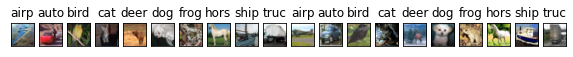

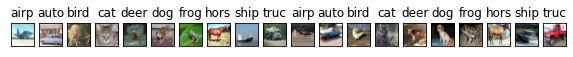

In [291]:
#@title def view_20_images(ds, num = 40): { form-width: "20px" }
# I don't know why the images looks so small 

def view_20_images(ds, num = 40):

  temp_ds = make_zipped_batched(ds, batchnum = num)

  # temp_ds = make_batched(ds, batchnum = num)

  image, label = next(iter(temp_ds)) # extract 1 batch from the dataset
  image = image.numpy().astype("uint8")  #??  #if theres a better way to do this I'm all ears because it's costly
  label = label.numpy()   
  
  fig =  plt.figure(figsize=(20, 20))
  fig2 = plt.figure(figsize=(20, 20))

  #if i want to display 40 pictures in 4 rows 10 columns i need a subplot(2,10,i)

 

  for i in range(num):
    if i <= 19:
      ax = fig.add_subplot(1, num, i+1, xticks=[], yticks=[])
      ax.imshow(image[i])
      ax.set_title(f"{CLASSES[label[i]][0:4]}")
    if i > 19 :
      new_i = i-10
      ax = fig2.add_subplot(1, num, new_i+1, xticks=[], yticks=[])
      # fig2.tight_layout()
      ax.imshow(image[i])
      ax.set_title(f"{CLASSES[label[i]][0:4]}")


view_20_images(trainB_combined, )

In [160]:
#@title show_confusion_matrix_wo_diagonal { form-width: "2px" }
def show_confusion_matrix_wo_diagonal(test_labels, predictions, CLASSES, run=999):
    """Compute confusion matrix without diagonal."""
    confusion = sklearn.metrics.confusion_matrix(test_labels, predictions,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

    confusion_matrix_wo_diagonal= np.array(confusion)-np.identity(confusion.shape[0])*np.diag(confusion)

    axis_labels = CLASSES

    ax = sns.heatmap(
        confusion_matrix_wo_diagonal, xticklabels=axis_labels, yticklabels=axis_labels, 
        cmap='Blues', annot=True, square=True, fmt='.0f', cbar = False)

    plt.title(str("Confusion Matrix without Diagonal of Run " + str(run)))
    plt.ylabel("True label")
    plt.xlabel("Predicted label")
    plt.show()
    print("Summing down the rows, for Predictions of each Class that were wrong: ", confusion_matrix_wo_diagonal.sum(axis=0))

    # for i in range(10):
    print("For example, the model predicted a  label 4 (deer) on a true  ", np.argmax(confusion_matrix_wo_diagonal[:,4])," a total of ", max(confusion_matrix_wo_diagonal[:,4]), "times")

    print("Summing across the columns, for total number of that True Class misidentified: ", confusion_matrix_wo_diagonal.sum(axis=1))
    
    print("For example, the model misclassified true 4's (deer) as label  ", np.argmax(confusion_matrix_wo_diagonal[4,:]), CLASSES[np.argmax(confusion_matrix_wo_diagonal[4,:])], " a total of ", max(confusion_matrix_wo_diagonal[4,:]), "times")





In [161]:
#@title define CLASSES
# The augmented data returns floats between 0 and 1
# The unaugmented data is integers uint8 between 0 and 255 
CLASSES = info.features['label'].names

# This may help me one day with trying to get into the ID of each batch/mislabelled image
# info.features['id']


## Function that creates the dataset when the two datasets are combined.

I need to examine this further since my understanding of reshuffle_each_iteration True versus False and the other parameters in .shuffle and its relation with other variables is sometimes shaky.  Also Prefetch and Cache, how does that effect batch order?

This was my original code when running allRuns successfully the first time.  
 


```
Review my Code:  
def cache_prefetch_group(train_tf, SHUFFLE=5000, batch = 0, SEED = 42):
    # I choose to shuffle the entire deck, which probably adds time, but I want to ensure mixed unaugmented and augmented
    train_tf = train_tf.shuffle(SHUFFLE, reshuffle_each_iteration=False)  # I took out seed=seed to get variety with each reshuffle
    # as of 11/10/21 9 pm I changed reshuffle_each_iteration to False, because I think that will ensure I get at least all of the dataset images in a batch
    # as of 11/11/21 4 Am I changed reshuffle_each_iteration back to True, because train_B imagesdidnt look sufficiently shuffled in a batch

    train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
    if batch != 0:
      train_tf = train_tf.batch(batch)  # ??moved Batch to inside ModelTraining loop to prevent Double-Batching-Weirdness
    return train_tf 
```



********************                        ********************


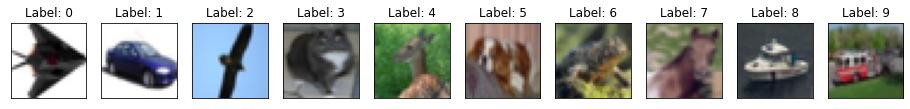

In [292]:
#@title cache_prefetch_group(train_tf, shuffle=5000, batch =0, SEED = 42) { form-width: "4px" }

# tf.data.Dataset.shuffle(name=, buffer_size=,  , reshuffle_each_iteration=, seed=seed, )
def cache_prefetch_group(train_tf, SHUFFLE=5000, batch = 0, SEED = 42, zip=True):
    # I choose to shuffle the entire deck, which probably adds time, but I want to ensure mixed unaugmented and augmented
      
    
    if zip:
      train_tf = make_zipped_batched(train_tf, batchnum= 10)
      train_tf = train_tf.shuffle(SHUFFLE, reshuffle_each_iteration=True, seed=seed )  # I took out seed=seed to get variety with each reshuffle
      train_tf = make_unbatched(train_tf)
      train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
      train_tf = make_zipped_batched(train_tf, batchnum= batch)
      return train_tf
    # as of 11/10/21 9 pm I changed reshuffle_each_iteration to False, because I think that will ensure I get at least all of the dataset images in a batch
    # as of 11/11/21 4 Am I changed reshuffle_each_iteration back to True, because train_B imagesdidnt look sufficiently shuffled in a batch

    # train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
    if batch != 0:
      train_tf = train_tf.shuffle(SHUFFLE, reshuffle_each_iteration=True, seed=seed )  # I took out seed=seed to get variety with each reshuffle
      train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
      train_tf = train_tf.batch(batch)  # ??moved Batch to inside ModelTraining loop to prevent Double-Batching-Weirdness
      
      return train_tf 

#test with a zipped batch
train_B_combined_cacheprefetchshufflebatch_test = cache_prefetch_group(trainB_combined, batch = 100)
view_image(train_B_combined_cacheprefetchshufflebatch_test )


#### Make Sortedd Test Accuracy Dictionary  Functions

In [163]:
#@title make_accuracy_dictionary(cm_norm)
# define function to print out all the labels amd accuracies on the diagonal of the confusion matrix
def make_accuracy_dictionary(cm_norm):
  dictionary = {}
  for i in range(10):
    dictionary[CLASSES[i]] = cm_norm[i,i]
    
  # sort the values - ty SO https://stackoverflow.com/questions/613183/how-do-i-sort-a-dictionary-by-value/613218#613218
  for w in sorted(dictionary, key=dictionary.get, reverse=True):
    print(w, dictionary[w])
  return dictionary 


# define function to print out all the labels amd accuracies on the off diagonal of the confusion matrix
# to indicate the most common mistakes:

# def make_misclassification_dictionary(cm):
#   dictionary = {}

#   for i in range(10):
#     dictionary_cm_diagonal_labels[CLASSES[i]] = cm_norm[i,i]
    
#   # sort the values - ty SO https://stackoverflow.com/questions/613183/how-do-i-sort-a-dictionary-by-value/613218#613218
#   for w in sorted(dictionary_cm_diagonal_labels, key=dictionary_cm_diagonal_labels.get, reverse=True):
#     print(w, dictionary_cm_diagonal_labels[w])
#   return dictionary_cm_diagonal_labels 

# Run, Model, Test, Capture all 50 Designed Runs

In [164]:
#@title how to show Type of dataset "Batch", "Map", "Shard" etc
## This is code found on SO to see whether the dataset is batched or not
#  
# train_A_alb.batch(num_alb).__class__.__name__
# new_train_A = new_train_A.batch(10)
# new_train_A._input_dataset.__class__.__name__
# new_train_A = (tf.data.Dataset.unbatch(new_train_A))

In [165]:
#@title count_images(ds, opttext)
def count_images(ds, opttext = ""):
  # The number of images present in the new train_A_alb set is equal to the original set
  num_images = ds.reduce(np.int64(0), lambda x,_ : x + 1).numpy()  # returns 10 bc no batches
  print(" There are ** ", num_images, "** total images in " ,  opttext)
  return num_images

Original Working Code for Train_A before it became a function:

In [166]:
#@title old code for just Train_A
 
# # ---------------------------------------------------------------------------
# # Create Training-Group-Specific Dictionary to collect important metrics at the end of all runs 
# # ----------------------------------------------------------------------------
# Group_A_Runs = {}   #dictionary

# # Group_A_Runs[run] = {'TestAccuracy': 0}


# # ---------------------------------------------------------------------------
# # When in troubleshooting or refining/code mode, I only run 5 experimental runs but
# # when running the full design matrix, ensure ENDRUNS = 51  (50 + baseline run)
# # the for loop will go through each run like this: df_experimentalruns.loc[run, "WhateverFactors"]:
# # ----------------------------------------------------------------------------

# ENDRUNS = 51
# # assert ENDRUNS == 50

# for run in range(0,ENDRUNS): 

#   # run = run + 1  # commented out after I added a Do-Nothing Run, I now have a real index 0 in the test-run-matrix  
#   print("\n", (str(run) + " ")*50)
#   print("\n   Begin Run: ", run)
#   print("\n", (str(run) + " ")*50)
  

#   #Use my vanilla CNN model function to build a  model with a certain dropout level
#   model = makemodel(DROPOUT=df_experimentalruns.loc[run,'dropout'])

# # ------------------------------------
# # Create Run-Specific Transformations 
# # ------------------------------------

#   # build  Albumentations list of transformations by passing each run's required parameters 
#   list_of_transforms = augmentfunction( df_experimentalruns, run )

#   # pass the list of transforms to Albumentations Compose function
#   transforms = A.Compose(transforms = list_of_transforms)
  
# # ------------------------------------
# # Create Augmented Dataset train_A_alb 
# # ------------------------------------
  
#   # Augment the unbatched Training_Group_A through the Process_Data Function to create train_A_alb (albu = albumentations/augmentations)
#   train_A_alb = augment_data(dataset = unbatch_train_A, process= process_data, dataset_text = "Augmented Dataset")
  
# # ------------------------------------
# # Print the number of total images in each unbatched dataset train_A_alb, and train_A_noalb 
# # -----------------------------------

#   # The number of images present in the new train_A_alb set is equal to the original set
#   # num_alb = count_images(train_A_alb, opttext="Augmented-train-a, before batching")
#   # print("Train_A_Alb has class count:", count_cifar10_class(train_A_alb))
#   # pretty_display_of_dataset(train_A_noalb, "Train Set A - NO Augmentations", opttext = "before batching")


#   # The number of images present in the new train_A_alb set is equal to the original set
#   # count_images(train_A_noalb, "Not-Augmented Train_A, before batching")
#   # print("Train_A_No_Augmentations has class count:", count_cifar10_class(train_A_noalb))
#   # pretty_display_of_dataset(train_A_alb, "Train Set A - Augmentations", opttext = "before batching")


#   # ------------------------------------
#   # Merge/Concatenate Augmented and Non-Augmented into dataset: NEW_TRAIN_A,  then return the total count of images 
#   # ------------------------------------
#   new_train_A = train_A_noalb.concatenate(train_A_alb)
#   # at 9pm I switched the order of these because I think I'm not seeing no_aug until the very last batches? I need to shuffle the batches....
#   #pretty_display_of_dataset(new_train_A, "New Training Set A - Merged with the Augmented, and Non-Augmented", opttext = "before batching")

# # ------------------------------------
# # Batch Consolidated Dataset  
# # ------------------------------------
#   new_train_A_batch = 250 
#   tot_new_train_A = 5000 # should be 250*10*2 = 5000

#   new_train_A = cache_prefetch_group(new_train_A,  SHUFFLE=tot_new_train_A, batch=new_train_A_batch, SEED = seed)

# # ------------------------------------
# # Send Consolidated Dataset through Model & View Model Training Statistics Output 
# # ------------------------------------
#   # take the created model from passing dropout, and pass the training data through it
#   modeltrained = trainmodel(MODEL = model, TRAININGDATA= new_train_A)

# # ------------------------------------
# # See pictures that were sent through model, up to five batches
# # ------------------------------------
#   pretty_display_of_dataset(ds= new_train_A, dstitle="New Training Set A", opttext= "after Shuffling and Batching") 


# # ------------------------------------
# # Test Statistics for Model 
# # ------------------------------------
#   # Retrieve the TEst Loss and Accuracy after training is complete
#   loss, acc = modeltrained.evaluate(x_test, verbose=0) 
#   print("TestLoss: ", loss, " TestAcc:", acc)



# # ------------------------------------
# # Get Predictions from Test Set to use in Confusion Matrix
# # ------------------------------------

#   #Get the predictions of Y_hat from passing X_Test into the model
#   y_pred = modeltrained.predict(x_test)

#   # The Y_Hats are y_pred of continuous probabilities into a 1-coded label vectors
#   y_pred_1hot = np.argmax(y_pred, axis=1)
#   cm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] ) 
#   cm_norm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9], normalize ='true' ) 
#   # disp = ConfusionMatrixDisplay(cm, display_labels=['airplane', 'automobile','bird','cat','deer','dog','frog','horse','ship','truck']).plot()
#   make_accuracy_dictionary(cm_norm)

#   # confusion_matrix(y_true = y_test, y_pred = y_pred_1hot )
#   # show_confusion_matrix(y_test, y_pred_1hot, CLASSES = CLASSES)

# # ------------------------------------
# # Save every 10 runs and final file
# # ------------------------------------
#   Group_A_Runs[run] = {'TestAccuracy': acc, 'TestLoss': loss, 'CM': cm, 'CM_norm': cm_norm}
  
#   if run != 0:
#     if run == 50:      
# # ------------------------------------
# # Save  final file
# # ------------------------------------  
#       with open('runs_groupA_final.pkl', 'wb') as fid:
#           pickle.dump(Group_A_Runs, fid)
#           files.download('runs_groupA_final.pkl')
          
#           timetoprint = datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")
#           print("Final Download attempted : ", timetoprint, " (subtract 3-hours from Hour), and file is called runs_groupA_final.pkl ")
# # ------------------------------------
# # Save  intermittent files
# # ------------------------------------  

#     if run%12 == 0:  #When i =12,24,36, save/download file
#       with open('runs_groupA.pkl', 'wb') as fid:
#           pickle.dump(Group_A_Runs, fid)
#           files.download('runs_groupA.pkl')
          
#           timetoprint = datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")
#           print("Download attempted : ", timetoprint, " (subtract 3-hours from Hour), and file is called runs_groupA.pkl ")

 

trainB_combined created
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


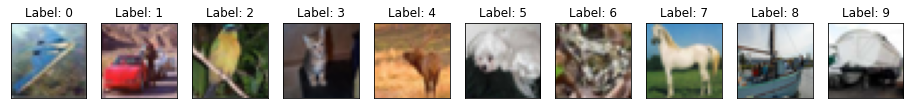

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of Dataset title            ********************


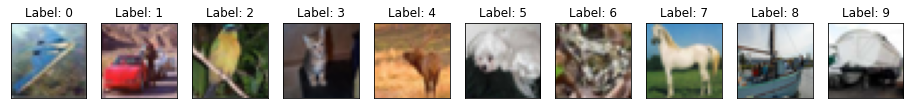

Batch  1 Class Count: (1, 1, 1, 1, 1, 1, 1, 1, 1, 1) 

********************            Batch2 of Dataset title            ********************


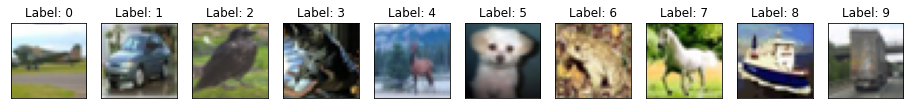

Batch  2 Class Count: (1, 1, 1, 1, 1, 1, 1, 1, 1, 1) 

********************            Batch3 of Dataset title            ********************


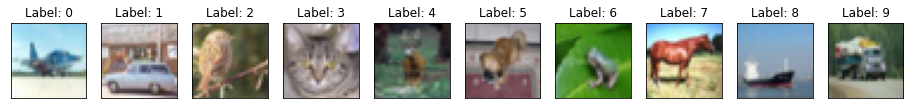

Batch  3 Class Count: (1, 1, 1, 1, 1, 1, 1, 1, 1, 1) 

********************            Batch4 of Dataset title            ********************


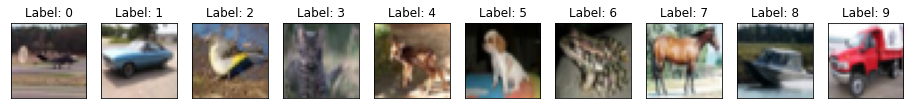

Batch  4 Class Count: (1, 1, 1, 1, 1, 1, 1, 1, 1, 1) 

********************            Batch5 of Dataset title            ********************


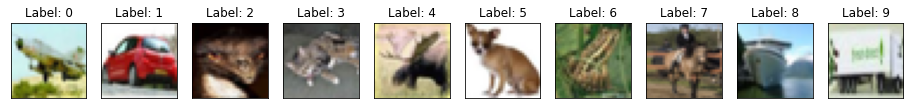

Batch  5 Class Count: (1, 1, 1, 1, 1, 1, 1, 1, 1, 1) 

**********************************************************************************************


In [167]:
#Get All Datasets ready by doing the following prior to each run
#I will probably put this in the concatenate code?
 
trainA_subsets = (airplanes_A, automobiles_A, birds_A, cats_A, deers_A, dogs_A, frogs_A, horses_A, ships_A, trucks_A)

def zip_9_sets(tuple_of_9_subsets_to_zip, opttext="9 Sets Zipped and Concatenated"):
  combined = tf.data.Dataset.zip((tuple_of_9_subsets_to_zip)).flat_map(
    lambda x0, x1, x2, x3, x4, x5,x6,x7,x8,x9:
     tf.data.Dataset.from_tensors(x0).concatenate(
        tf.data.Dataset.from_tensors(x1).concatenate(
            tf.data.Dataset.from_tensors(x2).concatenate(
                tf.data.Dataset.from_tensors(x3).concatenate(
                     tf.data.Dataset.from_tensors(x4).concatenate(
                          tf.data.Dataset.from_tensors(x5).concatenate(
                               tf.data.Dataset.from_tensors(x6).concatenate(
                                    tf.data.Dataset.from_tensors(x7).concatenate(
                                         tf.data.Dataset.from_tensors(x8).concatenate(
                                              tf.data.Dataset.from_tensors(x9))
                               )
                          )
                     )
                )
            )
          )
      )
    ))
  print(opttext)
  return combined


def zip_2_sets(tuple_of_2_subsets_to_zip, opttext="Two Sets Zipped and Concatenated"):
  combined = tf.data.Dataset.zip((tuple_of_2_subsets_to_zip)).flat_map(
    lambda x0, x1:
     tf.data.Dataset.from_tensors(x0).concatenate(
        tf.data.Dataset.from_tensors(x1)))
  
  print(opttext)
  return combined


# trainA_combined = zip_9_sets(trainA_subsets, opttext="trainA_combined created")
# fig = tfds.show_examples(trainA_combined, info)  #works
# trainA_combined_batched = make_zipped_batched(trainA_combined, 10)
# pretty_display_of_dataset(trainA_combined_batched) #fails because it chcks inputdata and zip doesnt have inputdata

trainB_subsets = (airplanes_B, automobiles_B, birds_B, cats_B, deers_B, dogs_B, frogs_B, horses_B, ships_B, trucks_B)

trainB_combined= zip_9_sets(trainB_subsets, opttext="trainB_combined created")
# fig = tfds.show_examples(trainB_combined, info)  #works
trainB_combined_batched = make_zipped_batched(trainB_combined, 10)
pretty_display_of_dataset(trainB_combined_batched)  



 
#so now to test if trainB_combined_batched can be run through noalb, alb, and model...

 


### Defining all the no_augmentation groups before model-building-and-testing

In [168]:
#@title define all no_augmentations groups

# I am having trouble defining no_augmentation datasets inside the for-loop so i decided to define them outside the for-loop
# ------------------------------------
# Create Non-Augmented Dataset train_A_noalb 
# ------------------------------------
# until i figure out a better way , this is my way of ensuring that the unaugmented dataset is compatible datatype with that augmented one
def make_noalb(ds, dstitle):
  train_X_noalb = augment_data(dataset = make_unbatched(ds), process= no_process_data, dataset_text = str("TrainingGroup" + dstitle+ "NotAugmented"),)
  return train_X_noalb

# train_B_noalb = augment_data(dataset = make_unbatched(train_B), process= no_process_data, dataset_text = "Train_BNotAugmented",  passtransforms=no_transforms)
# print("train_B_noalb created")
# pretty_display_of_dataset(train_B_noalb, "noAugmentations") 

trainB_combined_noalb = make_noalb(make_zipped_batched(trainB_combined, 10), "B_Zipped_noalb")



# pretty_display_of_dataset(trainB_combined_noalb, "trainB_combined_noalb ")
# pretty_display_of_dataset(make_zipped_batched(trainB_combined_noalb, 10), "trainB_combined_noalb batched in 10s")



# pretty_display_of_dataset(train_A_noalb)




train_A_noalb = make_noalb(train_A, "A")
train_B_noalb = make_noalb(train_B, "B")

train_C_noalb = make_noalb(train_C, "C")
train_D_noalb = make_noalb(train_D, "D")

train_E_noalb = make_noalb(train_E, "E")
train_F_noalb = make_noalb(train_F, "F")

train_G_noalb = make_noalb(train_G, "G")
train_H_noalb = make_noalb(train_H, "H")

train_I_noalb = make_noalb(train_I, "I")
train_J_noalb = make_noalb(train_J, "J")




In [187]:
#@title The Mother of All Code { form-width: "80px" }
def run_through_runs(ds, ds_noalb, dstitle = "X", showpictures=True):
  filename = "runs_Group" + dstitle
  print("filename will be: ", filename, ".pkl")
  originalfilename = filename
  # ---------------------------------------------------------------------------
  # Create Training-Group-Specific Dictionary to collect important metrics at the end of all runs 
  # ----------------------------------------------------------------------------
  Group_X_Runs = {}   #dictionary
  # Group_X_Runs[run] = {'TestAccuracy': 0}


  # ---------------------------------------------------------------------------
  # For Loop of Runs
  # when running the full design matrix, ensure ENDRUNS = 51  (50 + baseline run)
  # the for loop will go through each run like this: df_experimentalruns.loc[run, "WhateverFactors"]:
  # ----------------------------------------------------------------------------

  ENDRUNS = 51
  # assert ENDRUNS == 51

  for run in range(0,ENDRUNS): 
    filename = originalfilename  #reset so you dont get Downloading "runs_GroupA.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl"


    # run = run + 1  # commented out after I added a Do-Nothing Run, I now have a real index 0 in the test-run-matrix  
    print("\n", (str(run) + " ")*50)
    print("\n   Begin Run: ", run, "on Dataset", (dstitle))
    print("\n", (str(run) + " ")*50, "\n")
    

    #Use my vanilla CNN model function to build a  model with a certain dropout level
    model = makemodel(DROPOUT=df_experimentalruns.loc[run,'dropout'])

    # ------------------------------------
    # Create Run-Specific Transformations 
    # ------------------------------------

    # build  Albumentations list of transformations by passing each run's required parameters 
    list_of_transforms = augmentfunction( df_experimentalruns, run )

    # pass the list of transforms to Albumentations Compose function
    global transforms 
    transforms = A.Compose(list_of_transforms)

    
    # ------------------------------------
    # Create Augmented Dataset train_A_alb 
    # ------------------------------------
    
    # Augment the unbatched Training_Group_A through the Process_Data Function to create train_A_alb (albu = albumentations/augmentations)
    train_X_alb = augment_data(dataset = ds, process= process_data, dataset_text = "Augmented Dataset", )
    # print("train_X_alb created")
    # title = "Augmentations for Run " + str(run) + " on Dataset " + str(dstitle)
    # pretty_display_of_dataset(train_X_alb, dstitle = dstitle,  opttext=title)
 
    # # ------------------------------------
    # # Create Non-Augmented Dataset train_A_noalb 
    # # ------------------------------------

    # moved outside of for-loop because problems

    # ------------------------------------
    # Print the number of total images in each unbatched dataset train_A_alb, and train_A_noalb 
    # -----------------------------------
    # removed because counting the items in a dataset is insanely time-expensive, unfortunately



    # ------------------------------------
    # Merge/Concatenate Augmented and Non-Augmented into dataset: NEW_TRAIN_A,  then return the total count of images 
    # ------------------------------------

    # new_train_X = ds_noalb.concatenate(train_X_alb)

    new_train_X = zip_2_sets(tuple_of_2_subsets_to_zip=(ds_noalb, train_X_alb), opttext="NoAlb+Alb")
    print("new_train_X created")
    print(new_train_X)
    # pretty_display_of_dataset(new_train_X, "newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))") 
    # pretty_display_of_dataset(make_zipped_batched(new_train_X, batchnum=1), "newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))") 

    # at 9pm I switched the order of these because I think I'm not seeing no_aug until the very last batches? I need to shuffle the batches....
    #pretty_display_of_dataset(new_train_A, "New Training Set A - Merged with the Augmented, and Non-Augmented", opttext = "before batching")

    # ------------------------------------
    # Batch Consolidated Dataset  
    # ------------------------------------
    new_train_X_batch =1 #  
    tot_new_train_X =   5000 # should be 250*10*2 = 5000  #for FIRST groups but not COMBINED GROUP RUNS = 10000
    print("Batch for Grouped Alb+NoAlb=", new_train_X_batch, "and total images to shuffle is=", tot_new_train_X)
    # pretty_display_of_dataset(make_zipped_batched(new_train_X, batchnum=1), "newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))") 
    
    new_train_X_batched = make_zipped_batched(new_train_X, batchnum=20)
    new_train_X_batched_shuffle = cache_prefetch_group(new_train_X_batched,  SHUFFLE=tot_new_train_X, batch=0, SEED = seed, zip=False)
    print("new_train_X batched")

    #! comment all model training --------------------------------
    # ------------------------------------
    # Send Consolidated Dataset through Model & View Model Training Statistics Output 
    # ------------------------------------
    # take the created model from passing dropout, and pass the training data through it
    print("Training Model... ")
    modeltrained = trainmodel(MODEL = model, TRAININGDATA= new_train_X_batched_shuffle)

    # ------------------------------------
    # See pictures that were sent through model, up to five batches
    # ------------------------------------
    # if showpictures == True:
    #   pretty_display_of_dataset(new_train_X, dstitle, ) 
    
    
    pretty_display_of_dataset(make_zipped_batched(new_train_X, batchnum=20), "newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))") 
    # pretty_display_of_dataset(new_train_X_batched, "newTrainX_batched_cached with 10? with zip2sets then passed to pp((newTrainX_batched))") 


    # ------------------------------------
    # Test Statistics for Model 
    # ------------------------------------
    # Retrieve the TEst Loss and Accuracy after training is complete
    loss, acc = modeltrained.evaluate(x_test, verbose=0) 
    print("TestLoss: ", loss, " TestAcc:", acc)



    # ------------------------------------
    # Get Predictions from Test Set to use in Confusion Matrix
    # ------------------------------------

    #Get the predictions of Y_hat from passing X_Test into the model
    y_pred = modeltrained.predict(x_test)

    # The Y_Hats are y_pred of continuous probabilities into a 1-coded label vectors
    y_pred_1hot = np.argmax(y_pred, axis=1)
    cm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] ) 
    cm_norm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9], normalize ='true' ) 
    # disp = ConfusionMatrixDisplay(cm, display_labels=['airplane', 'automobile','bird','cat','deer','dog','frog','horse','ship','truck']).plot()
    make_accuracy_dictionary(cm_norm)

    # confusion_matrix(y_true = y_test, y_pred = y_pred_1hot )
    #def show_confusion_matrix_wo_diagonal(test_labels, predictions, CLASSES):
    show_confusion_matrix_wo_diagonal(y_test, y_pred_1hot, CLASSES = CLASSES, run=run)

    # ------------------------------------
    # Save every 10 runs and final file
    # ------------------------------------
    Group_X_Runs[run] = {'TestAccuracy': acc, 'TestLoss': loss, 'CM': cm, 'CM_norm': cm_norm}
    
 
    # I cannot figure out why it downloads my files twice
    if run != 0:

      if run == 50: 
        # print("run == 50 is true")    
        filename = originalfilename + "_final.pkl"   
        with open(filename, 'wb') as fid:
          pickle.dump(Group_X_Runs, fid)
          files.download(filename)
          
          timetoprint = datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")
          print("Final Download attempted : ", timetoprint, " (subtract ~5-hours for local Hour), and file is called ", filename)
 

### Before you hit go, be sure to follow the instructions from the very helpful 2LT




1.      Go to and open the current Google Colab file you wish to run
2.      Click CTRL+SHIFT+I

        1.      The java console should open on your screen

3.      Once the console is open, copy and paste the function in the attached text file and click ENTER.

```
function ClickConnect(){
console.log("Working"); 
document
  .querySelector('#top-toolbar > colab-connect-button')
  .shadowRoot.querySelector('#connect')
  .click() 
}
setInterval(ClickConnect,60000)
```



filename will be:  runs_GroupTrainB_Zipped .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0 on Dataset TrainB_Zipped

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


NoAlb+Alb
new_train_X created
<FlatMapDataset shapes: ((32, 32, 3), ()), types: (tf.float32, tf.int64)>


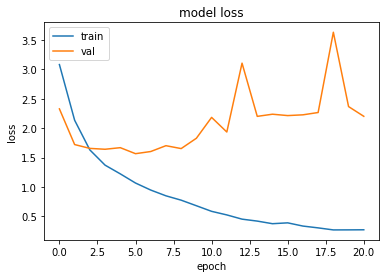

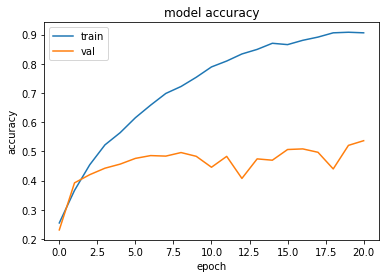

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.5676555633544922 , and Val Acc happened to be 0.47589999437332153
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.5364999771118164 and Val Loss happened to be  2.20304536819458
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


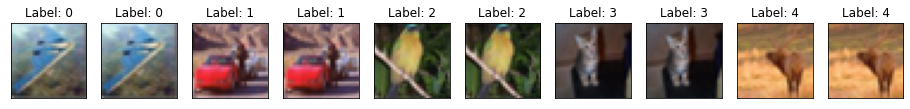

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


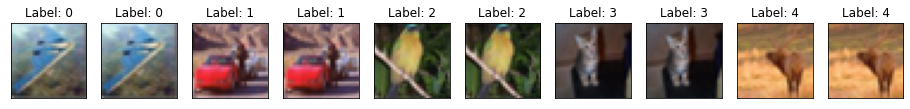

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


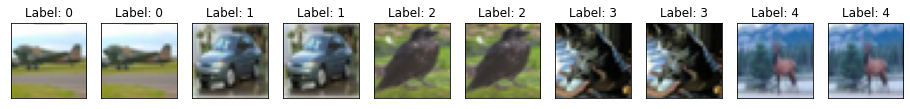

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


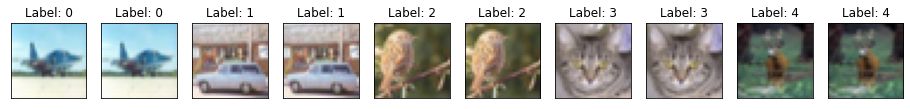

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


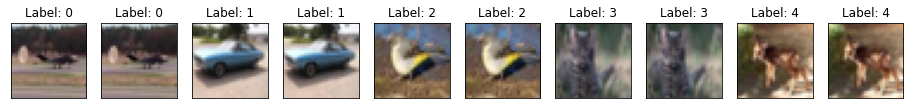

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


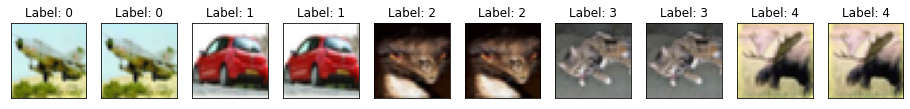

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5404802560806274  TestAcc: 0.4823000133037567
ship 0.689
horse 0.665
frog 0.635
truck 0.617
automobile 0.53
deer 0.5
dog 0.4
airplane 0.299
cat 0.27
bird 0.218


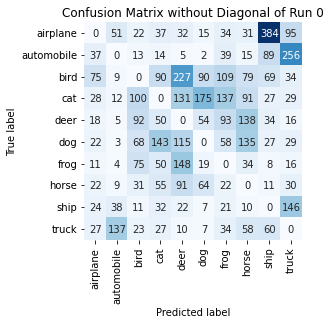

Summing down the rows, for Predictions of each Class that were wrong:  [264. 268. 435. 498. 781. 433. 547. 591. 709. 651.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  227.0 times
Summing across the columns, for total number of that True Class misidentified:  [701. 470. 782. 730. 500. 600. 365. 335. 311. 383.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  138.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1 on Dataset TrainB_Zipped

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 ,

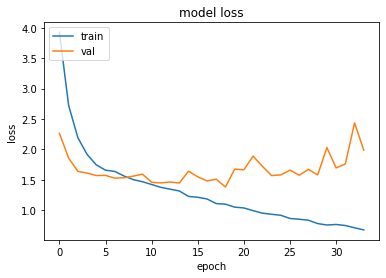

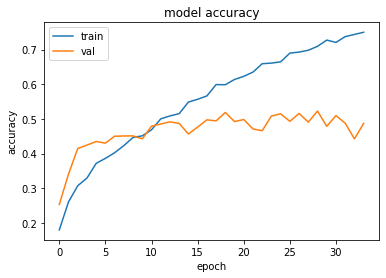

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  18 when  Val Loss was:  1.3802826404571533 , and Val Acc happened to be 0.5182999968528748
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5224000215530396 and Val Loss happened to be  1.578810214996338
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


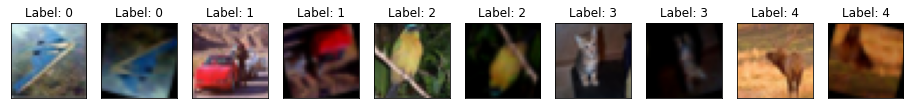

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


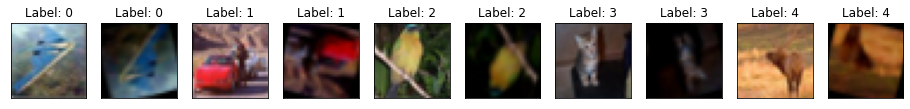

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


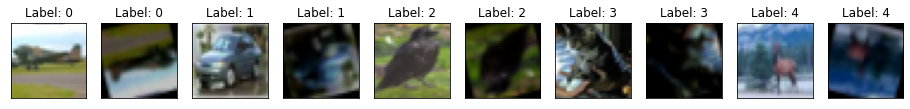

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


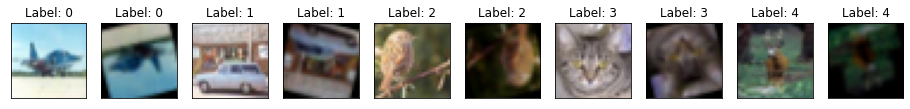

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


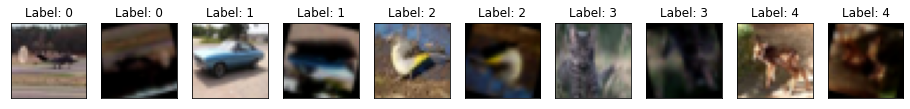

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


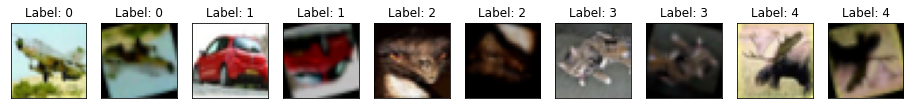

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.361778736114502  TestAcc: 0.5220000147819519
frog 0.714
ship 0.694
truck 0.655
automobile 0.65
horse 0.619
airplane 0.483
cat 0.445
dog 0.407
deer 0.392
bird 0.161


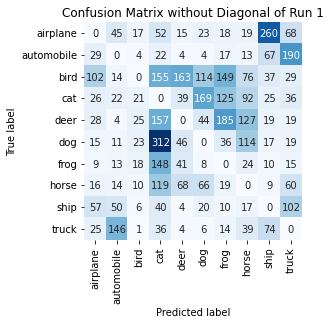

Summing down the rows, for Predictions of each Class that were wrong:  [ 307.  319.  125. 1041.  384.  454.  573.  521.  518.  538.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  163.0 times
Summing across the columns, for total number of that True Class misidentified:  [517. 350. 839. 555. 608. 593. 286. 381. 306. 345.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  185.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2 on Dataset TrainB_Zipped

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Co

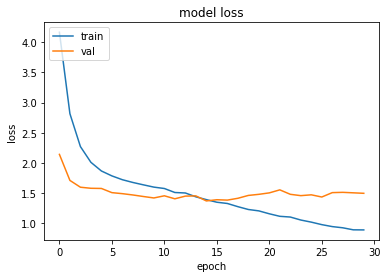

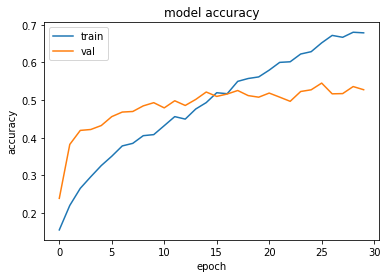

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.372757077217102 , and Val Acc happened to be 0.5213000178337097
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5450000166893005 and Val Loss happened to be  1.4375724792480469
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


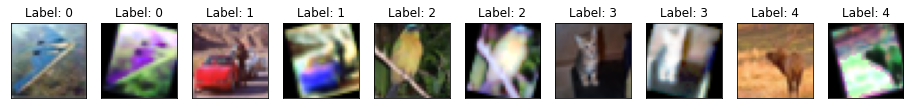

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


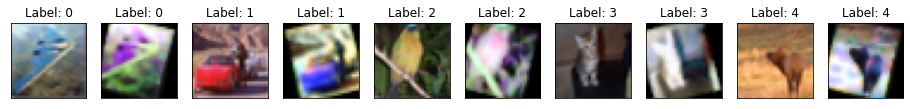

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


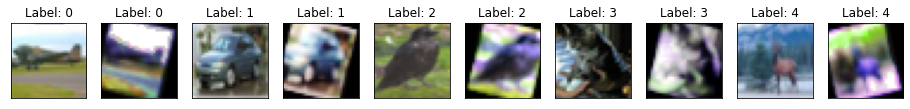

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


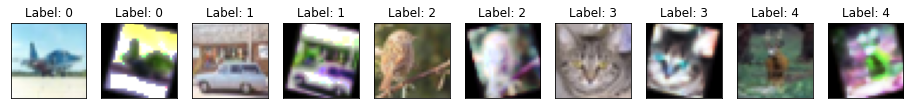

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


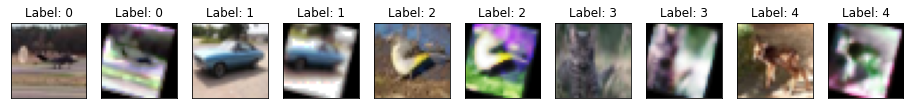

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


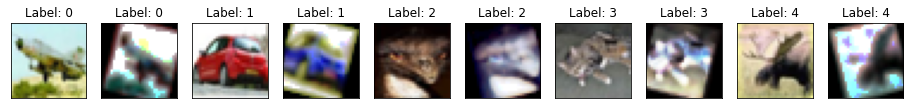

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3441005945205688  TestAcc: 0.5228000283241272
frog 0.772
automobile 0.659
ship 0.654
airplane 0.578
horse 0.527
truck 0.511
dog 0.448
deer 0.42
bird 0.395
cat 0.264


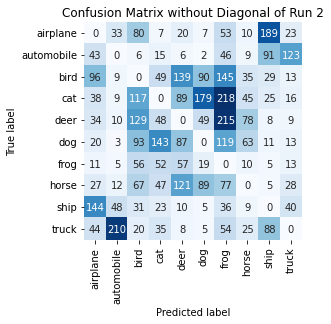

Summing down the rows, for Predictions of each Class that were wrong:  [457. 339. 599. 419. 537. 445. 963. 284. 451. 278.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  139.0 times
Summing across the columns, for total number of that True Class misidentified:  [422. 341. 605. 736. 580. 552. 228. 473. 346. 489.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  215.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3 on Dataset TrainB_Zipped

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Cont

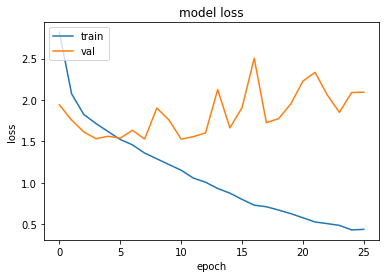

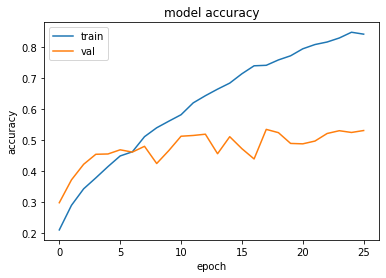

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.5283610820770264 , and Val Acc happened to be 0.5121999979019165
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5343999862670898 and Val Loss happened to be  1.7270033359527588
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


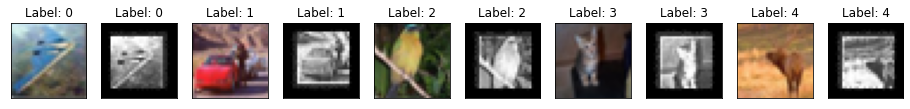

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


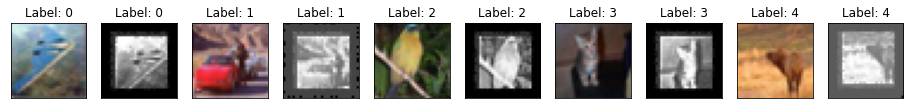

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


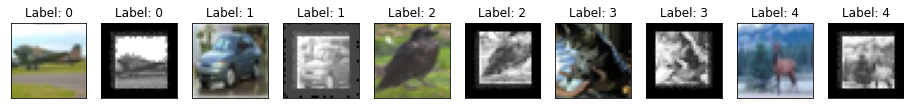

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


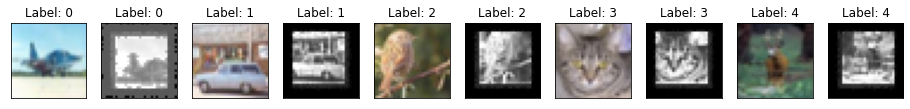

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


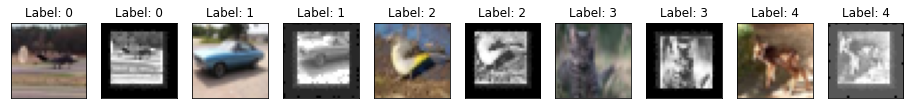

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


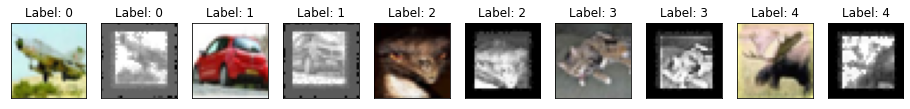

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4999858140945435  TestAcc: 0.5142999887466431
frog 0.696
automobile 0.686
truck 0.656
dog 0.632
horse 0.586
deer 0.552
ship 0.529
airplane 0.386
cat 0.225
bird 0.195


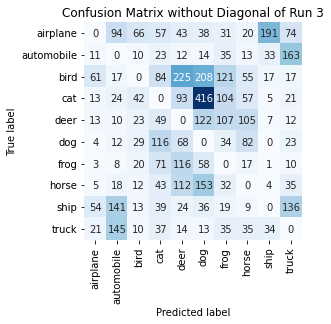

Summing down the rows, for Predictions of each Class that were wrong:  [ 185.  469.  225.  519.  707. 1058.  518.  393.  292.  491.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  225.0 times
Summing across the columns, for total number of that True Class misidentified:  [614. 314. 805. 775. 448. 368. 304. 414. 471. 344.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  122.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4 on Dataset TrainB_Zipped

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp: 

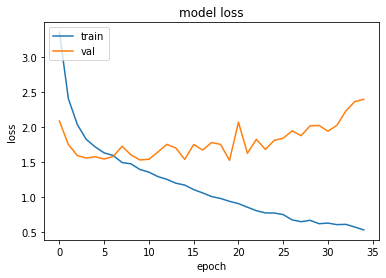

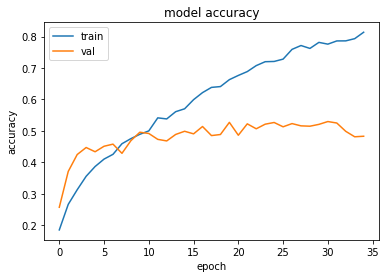

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.5248502492904663 , and Val Acc happened to be 0.5273000001907349
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5299000144004822 and Val Loss happened to be  1.9392080307006836
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


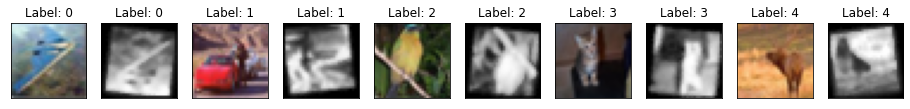

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


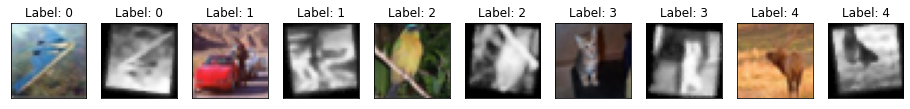

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


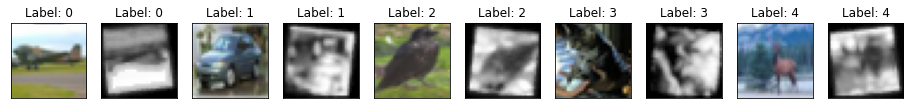

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


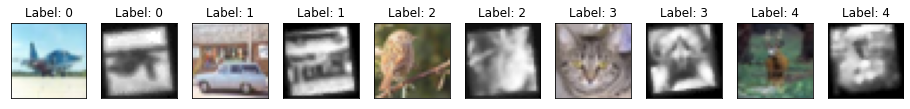

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


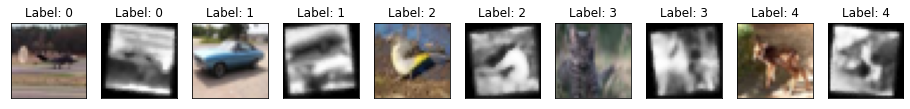

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


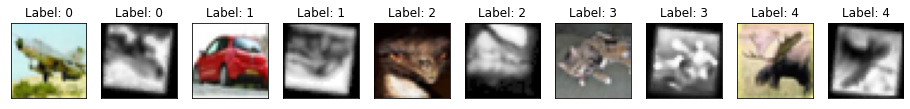

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4818849563598633  TestAcc: 0.5264000296592712
ship 0.647
frog 0.641
dog 0.629
truck 0.617
automobile 0.608
horse 0.543
deer 0.511
airplane 0.461
cat 0.317
bird 0.29


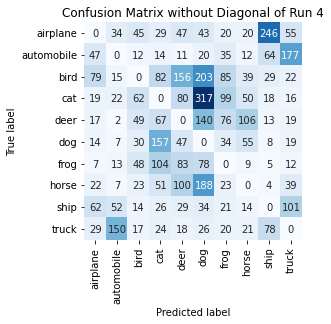

Summing down the rows, for Predictions of each Class that were wrong:  [ 296.  302.  300.  554.  571. 1049.  413.  326.  465.  460.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  156.0 times
Summing across the columns, for total number of that True Class misidentified:  [539. 392. 710. 683. 489. 371. 359. 457. 353. 383.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  140.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5 on Dataset TrainB_Zipped

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
C

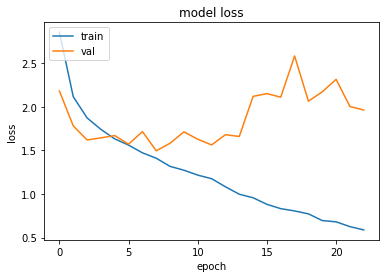

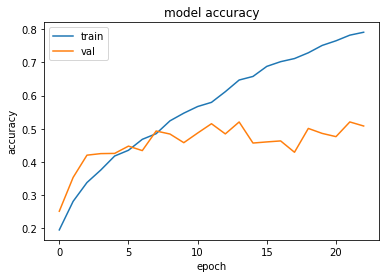

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.4951872825622559 , and Val Acc happened to be 0.492900013923645
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.5202999711036682 and Val Loss happened to be  2.0031814575195312
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


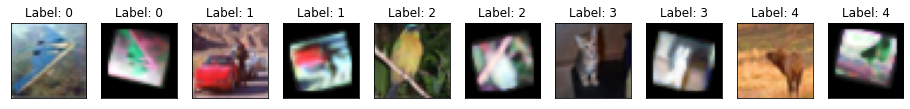

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


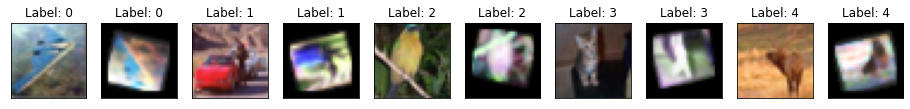

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


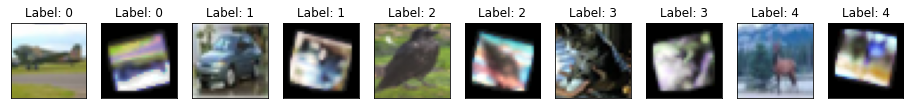

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


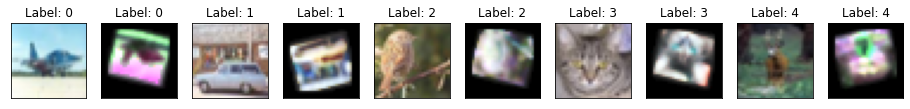

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


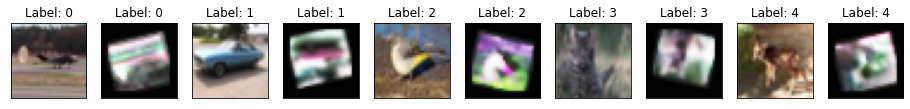

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


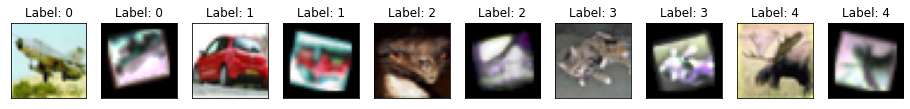

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4823154211044312  TestAcc: 0.4977000057697296
frog 0.725
truck 0.671
automobile 0.649
horse 0.604
ship 0.567
airplane 0.521
deer 0.384
dog 0.357
bird 0.313
cat 0.186


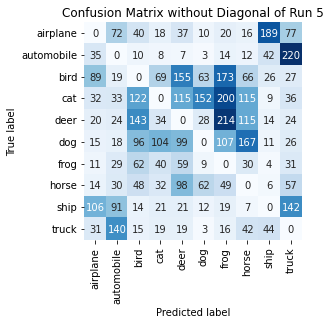

Summing down the rows, for Predictions of each Class that were wrong:  [353. 456. 550. 345. 610. 342. 812. 570. 345. 640.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  155.0 times
Summing across the columns, for total number of that True Class misidentified:  [479. 351. 687. 814. 616. 643. 275. 396. 433. 329.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  214.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6 on Dataset TrainB_Zipped

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Cont

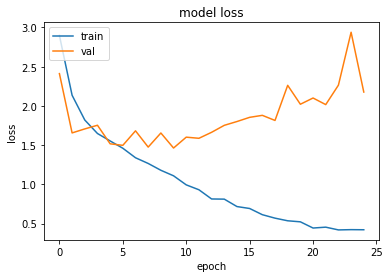

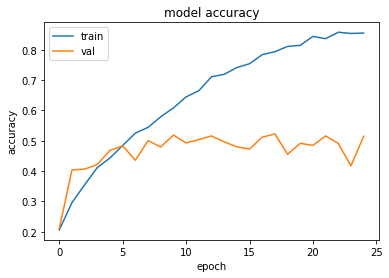

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.4636837244033813 , and Val Acc happened to be 0.5188000202178955
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.522599995136261 and Val Loss happened to be  1.8151482343673706
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


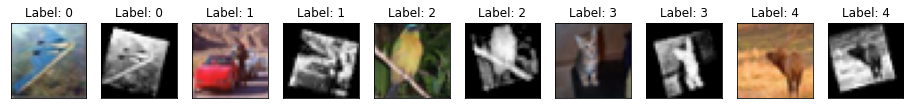

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


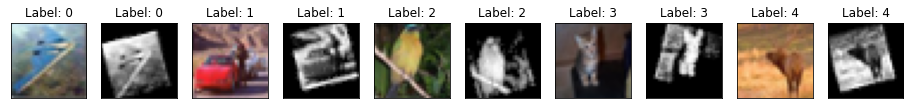

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


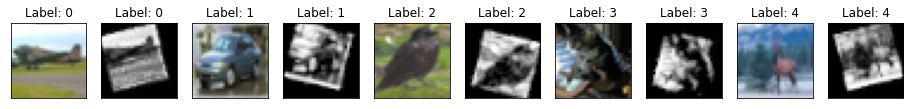

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


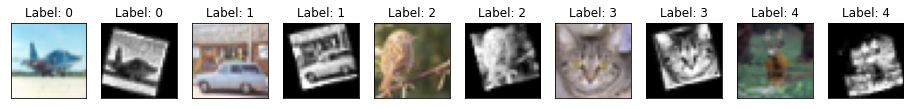

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


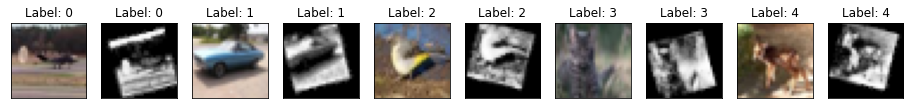

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


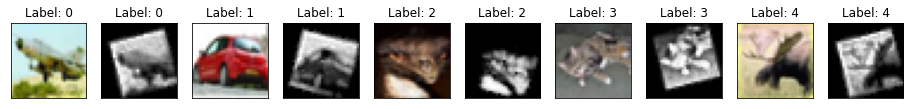

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.429885983467102  TestAcc: 0.5275999903678894
ship 0.7
dog 0.662
frog 0.66
automobile 0.64
truck 0.575
airplane 0.567
horse 0.506
bird 0.419
deer 0.382
cat 0.165


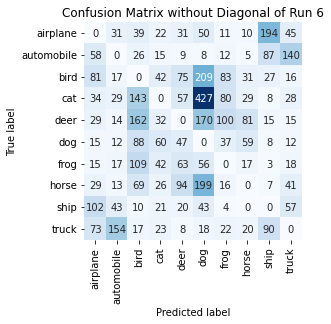

Summing down the rows, for Predictions of each Class that were wrong:  [ 436.  330.  663.  283.  404. 1180.  365.  252.  439.  372.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  94.0 times
Summing across the columns, for total number of that True Class misidentified:  [433. 360. 581. 835. 618. 338. 340. 494. 300. 425.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  170.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7 on Dataset TrainB_Zipped

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 

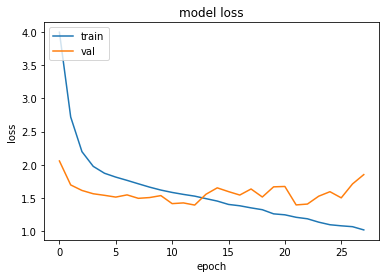

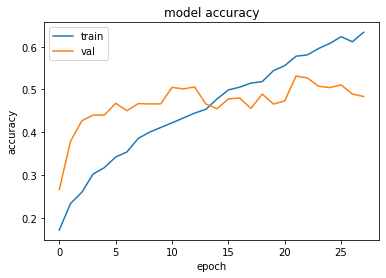

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.390332579612732 , and Val Acc happened to be 0.5060999989509583
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.5313000082969666 and Val Loss happened to be  1.3925883769989014
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


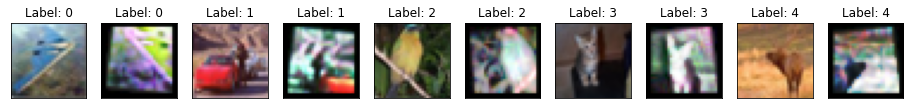

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


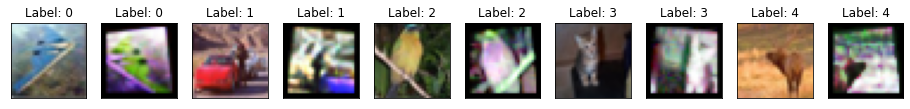

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


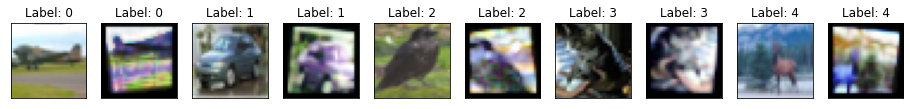

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


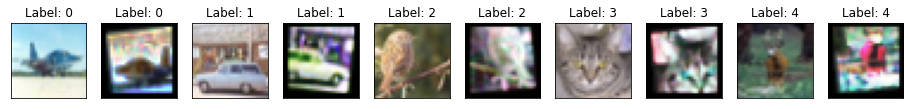

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


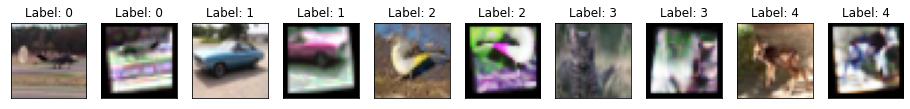

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


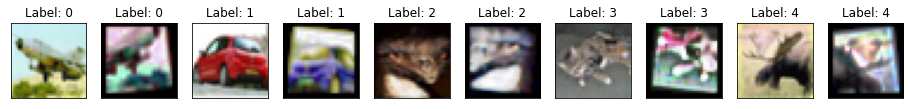

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3629977703094482  TestAcc: 0.5113999843597412
frog 0.836
ship 0.73
automobile 0.638
truck 0.603
horse 0.505
dog 0.483
airplane 0.416
cat 0.366
deer 0.294
bird 0.243


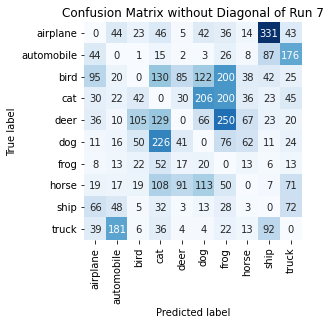

Summing down the rows, for Predictions of each Class that were wrong:  [348. 371. 273. 774. 278. 589. 888. 254. 622. 489.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  91.0 times
Summing across the columns, for total number of that True Class misidentified:  [584. 362. 757. 634. 706. 517. 164. 495. 270. 397.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  250.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8 on Dataset TrainB_Zipped

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0

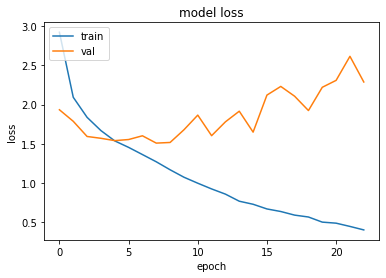

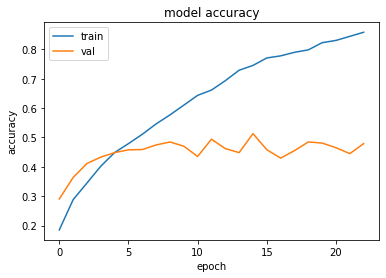

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.507097840309143 , and Val Acc happened to be 0.47440001368522644
Additionally, the best val acc epoch happened to be  14 when val acc was:  0.5130000114440918 and Val Loss happened to be  1.647327184677124
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


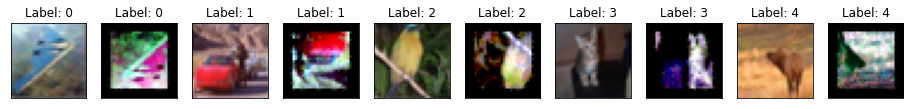

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


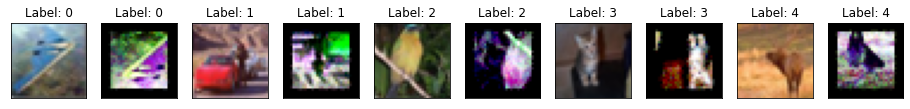

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


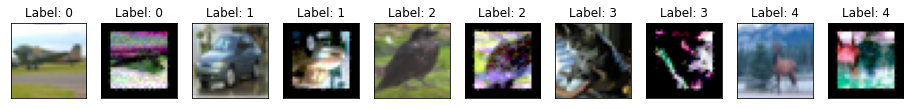

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


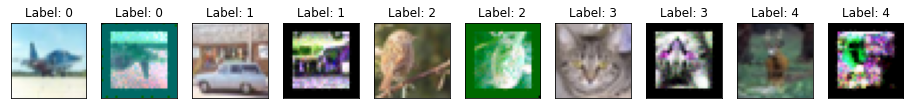

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


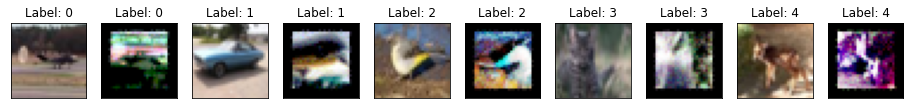

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


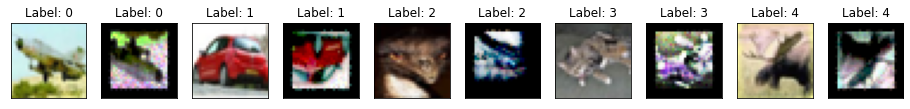

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4705308675765991  TestAcc: 0.48069998621940613
frog 0.721
ship 0.665
automobile 0.603
truck 0.556
horse 0.511
dog 0.454
deer 0.444
cat 0.321
airplane 0.301
bird 0.231


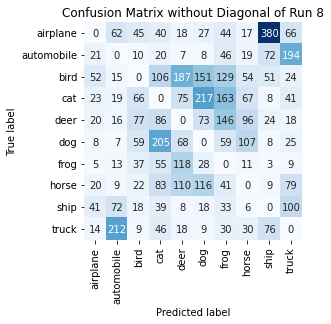

Summing down the rows, for Predictions of each Class that were wrong:  [204. 425. 343. 680. 609. 647. 691. 407. 631. 556.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  187.0 times
Summing across the columns, for total number of that True Class misidentified:  [699. 397. 769. 679. 556. 546. 279. 489. 335. 444.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  146.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9 on Dataset TrainB_Zipped

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05

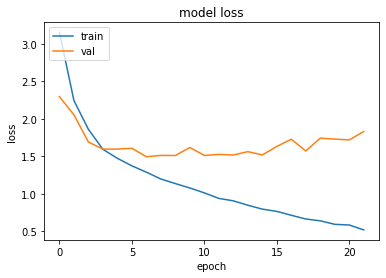

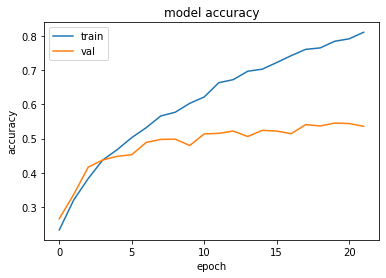

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.4936474561691284 , and Val Acc happened to be 0.48899999260902405
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5454000234603882 and Val Loss happened to be  1.7294304370880127
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


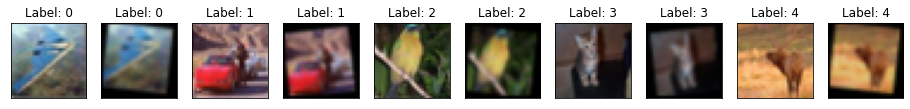

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


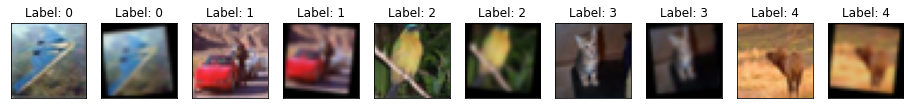

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


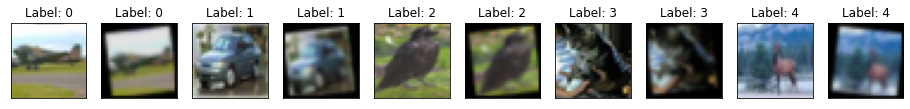

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


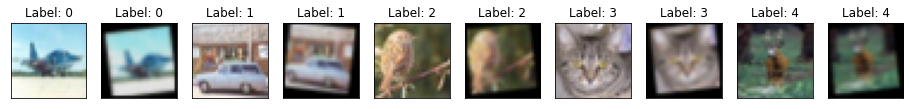

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


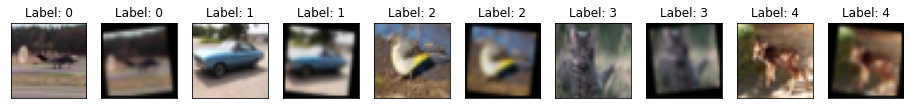

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


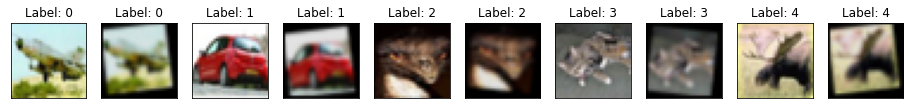

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4635813236236572  TestAcc: 0.492900013923645
frog 0.792
automobile 0.766
ship 0.708
horse 0.588
truck 0.508
dog 0.363
airplane 0.316
cat 0.314
bird 0.287
deer 0.287


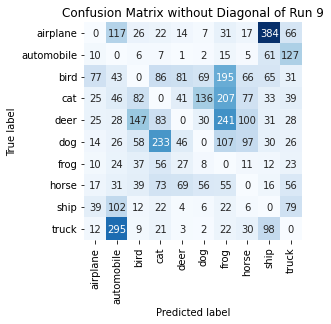

Summing down the rows, for Predictions of each Class that were wrong:  [229. 712. 416. 603. 286. 316. 895. 409. 730. 475.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  81.0 times
Summing across the columns, for total number of that True Class misidentified:  [684. 234. 713. 686. 713. 637. 208. 412. 292. 492.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  241.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10 on Dataset TrainB_Zipped

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   

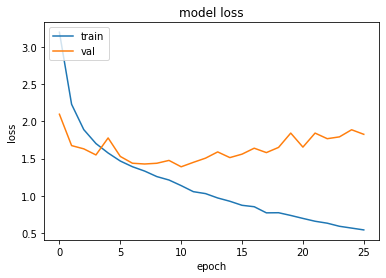

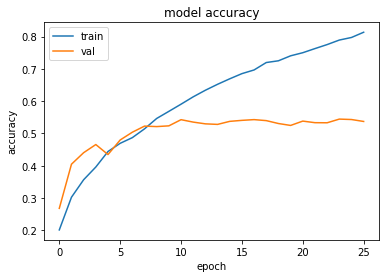

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.3895962238311768 , and Val Acc happened to be 0.5424000024795532
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.5442000031471252 and Val Loss happened to be  1.792622447013855
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


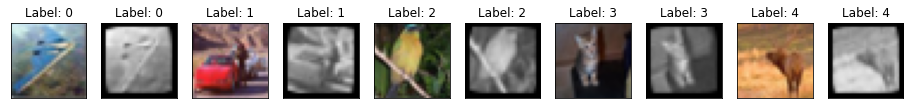

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


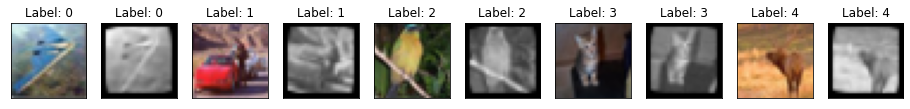

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


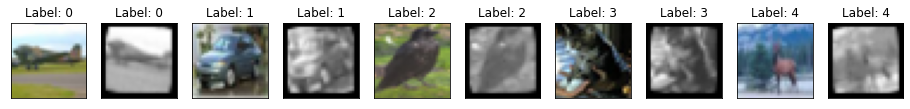

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


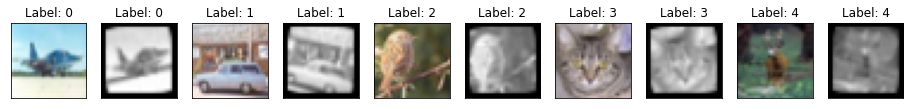

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


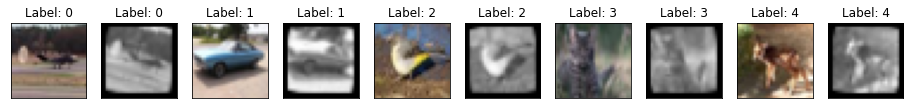

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


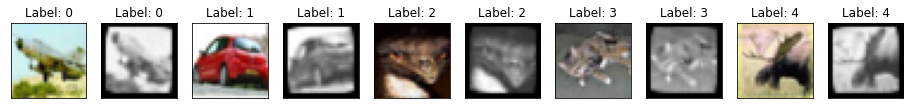

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3322696685791016  TestAcc: 0.5512999892234802
frog 0.752
automobile 0.743
ship 0.683
horse 0.593
truck 0.589
airplane 0.57
dog 0.468
deer 0.395
cat 0.362
bird 0.358


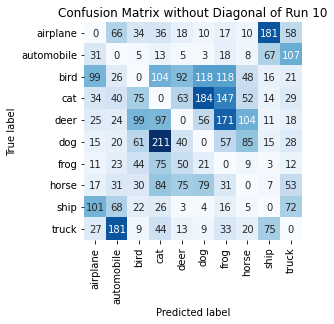

Summing down the rows, for Predictions of each Class that were wrong:  [360. 479. 379. 690. 359. 484. 608. 341. 389. 398.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  92.0 times
Summing across the columns, for total number of that True Class misidentified:  [430. 257. 642. 638. 605. 532. 248. 407. 317. 411.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  171.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11 on Dataset TrainB_Zipped

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn: 

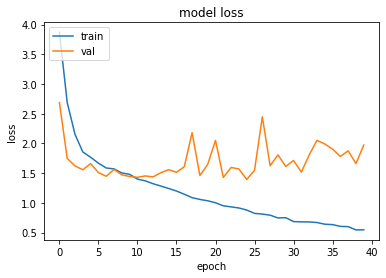

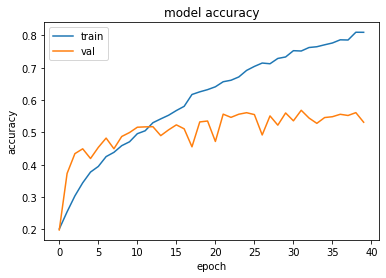

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.393524169921875 , and Val Acc happened to be 0.5608999729156494
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5684000253677368 and Val Loss happened to be  1.5183323621749878
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


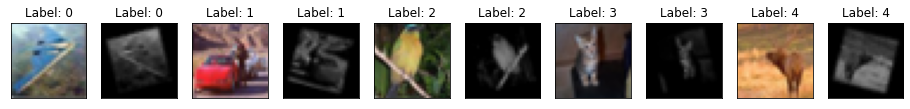

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


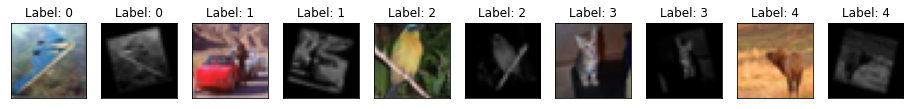

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


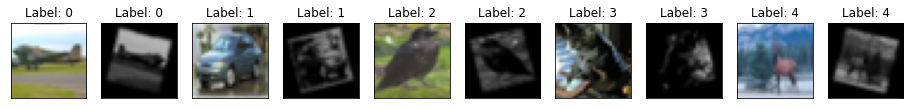

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


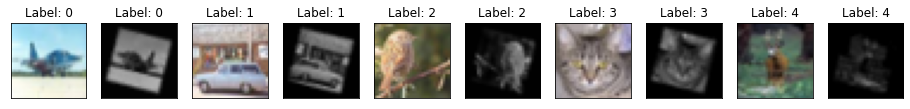

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


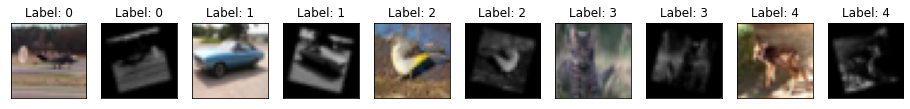

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


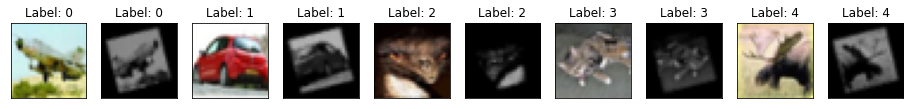

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3497828245162964  TestAcc: 0.5656999945640564
ship 0.748
automobile 0.712
frog 0.691
truck 0.63
dog 0.614
horse 0.526
airplane 0.521
bird 0.462
cat 0.397
deer 0.356


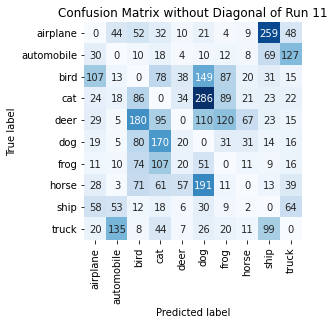

Summing down the rows, for Predictions of each Class that were wrong:  [326. 286. 573. 623. 196. 874. 383. 180. 540. 362.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  57.0 times
Summing across the columns, for total number of that True Class misidentified:  [479. 288. 538. 603. 644. 386. 309. 474. 252. 370.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  180.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12 on Dataset TrainB_Zipped

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )


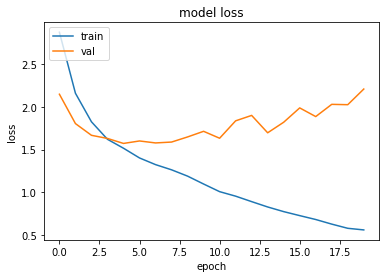

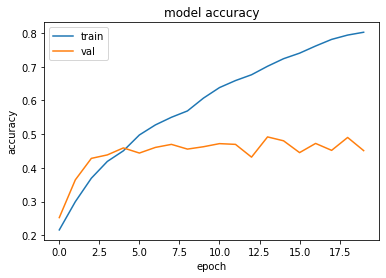

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5717915296554565 , and Val Acc happened to be 0.459199994802475
Additionally, the best val acc epoch happened to be  13 when val acc was:  0.4918000102043152 and Val Loss happened to be  1.6965525150299072
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


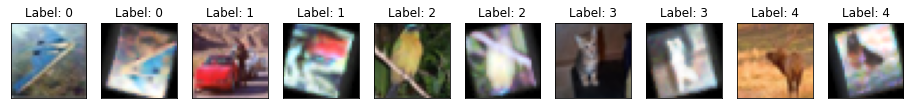

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


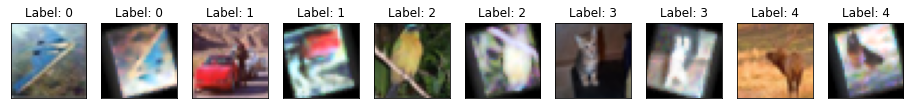

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


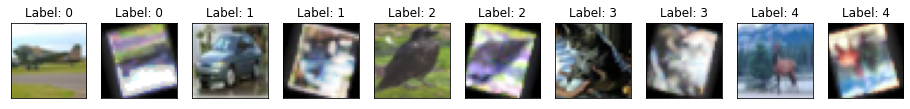

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


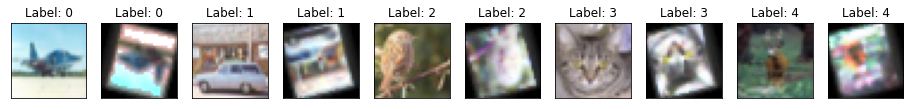

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


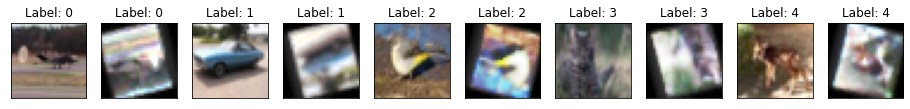

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


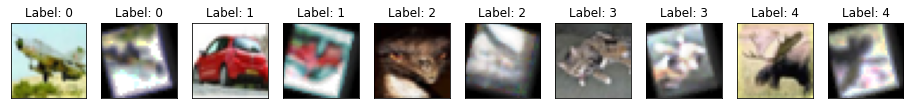

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5726852416992188  TestAcc: 0.45559999346733093
ship 0.747
frog 0.611
truck 0.533
horse 0.475
automobile 0.471
airplane 0.456
dog 0.411
bird 0.377
deer 0.288
cat 0.187


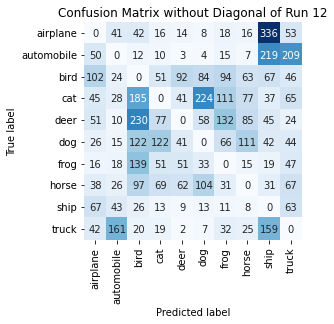

Summing down the rows, for Predictions of each Class that were wrong:  [437. 366. 873. 428. 315. 535. 510. 407. 955. 618.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  92.0 times
Summing across the columns, for total number of that True Class misidentified:  [544. 529. 623. 813. 712. 589. 389. 525. 253. 467.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  230.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13 on Dataset TrainB_Zipped

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )


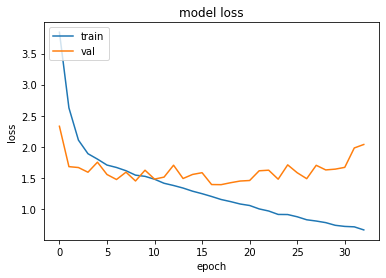

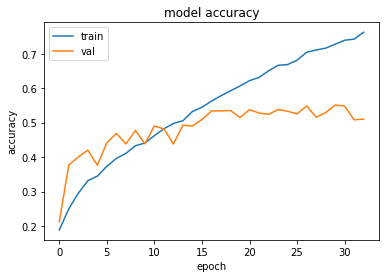

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.3946194648742676 , and Val Acc happened to be 0.5342000126838684
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5509999990463257 and Val Loss happened to be  1.6438074111938477
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


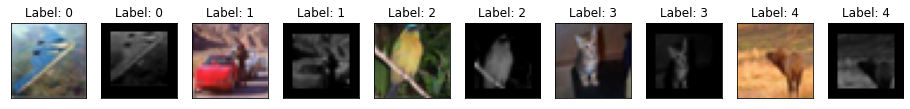

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


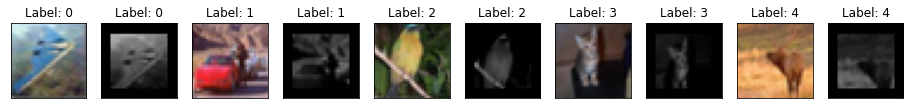

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


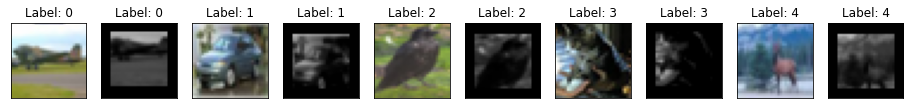

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


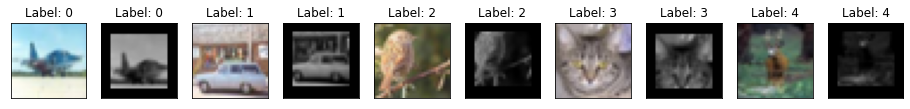

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


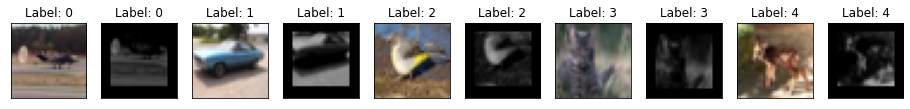

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


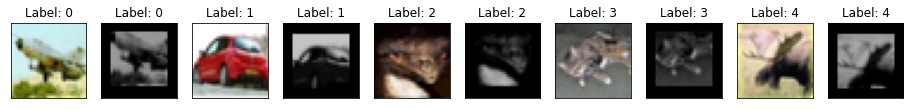

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3603827953338623  TestAcc: 0.5367000102996826
ship 0.787
frog 0.765
automobile 0.682
truck 0.648
horse 0.587
deer 0.573
airplane 0.403
bird 0.381
dog 0.313
cat 0.228


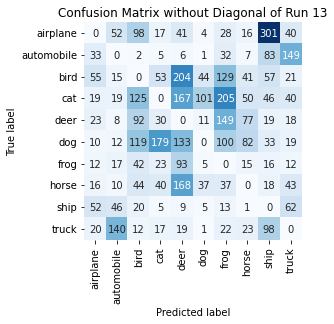

Summing down the rows, for Predictions of each Class that were wrong:  [240. 319. 554. 369. 840. 209. 715. 312. 671. 404.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  204.0 times
Summing across the columns, for total number of that True Class misidentified:  [597. 318. 619. 772. 427. 687. 235. 413. 213. 352.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  149.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14 on Dataset TrainB_Zipped

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0

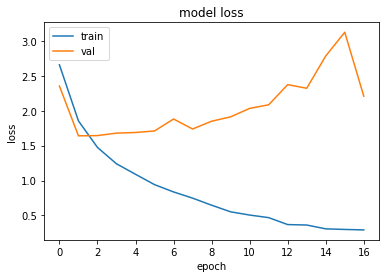

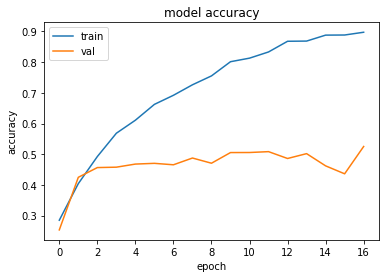

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  1 when  Val Loss was:  1.6405761241912842 , and Val Acc happened to be 0.42480000853538513
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5252000093460083 and Val Loss happened to be  2.208299398422241
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


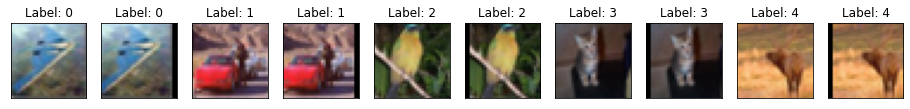

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


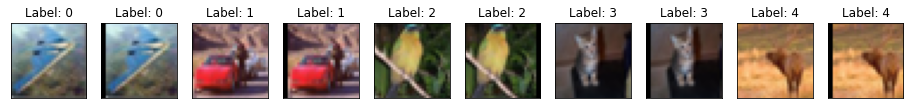

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


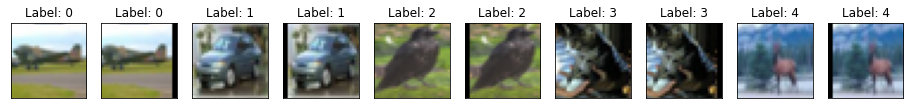

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


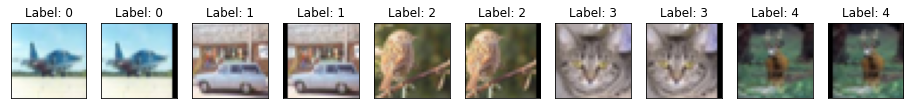

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


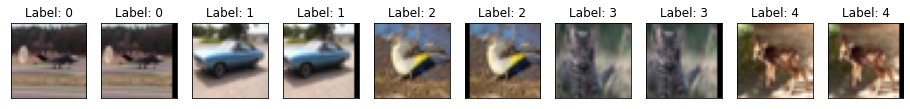

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


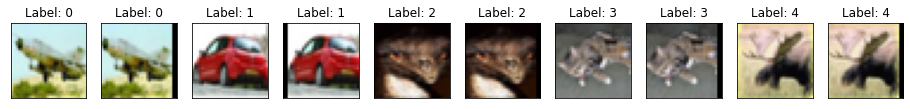

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.6234811544418335  TestAcc: 0.4293999969959259
frog 0.72
ship 0.682
automobile 0.594
truck 0.488
dog 0.47
horse 0.426
airplane 0.251
deer 0.242
bird 0.233
cat 0.188


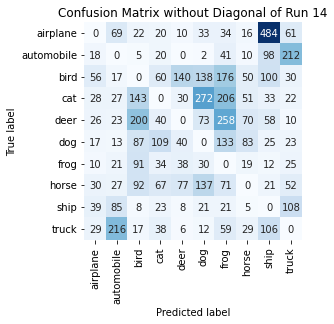

Summing down the rows, for Predictions of each Class that were wrong:  [253. 498. 665. 411. 349. 718. 999. 333. 937. 543.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  140.0 times
Summing across the columns, for total number of that True Class misidentified:  [749. 406. 767. 812. 758. 530. 280. 574. 318. 512.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  258.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15 on Dataset TrainB_Zipped

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.

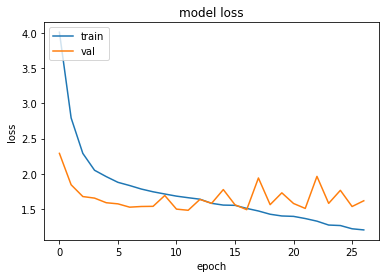

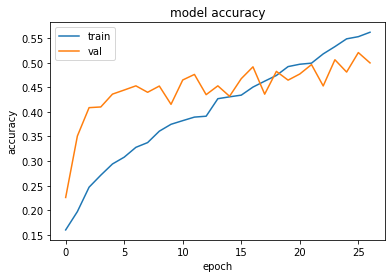

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.481364369392395 , and Val Acc happened to be 0.47609999775886536
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5205000042915344 and Val Loss happened to be  1.534915566444397
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


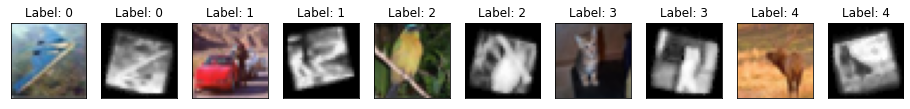

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


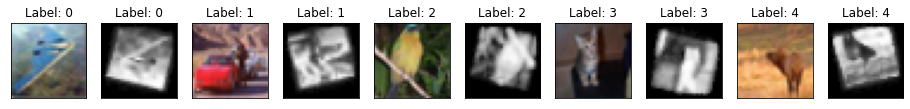

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


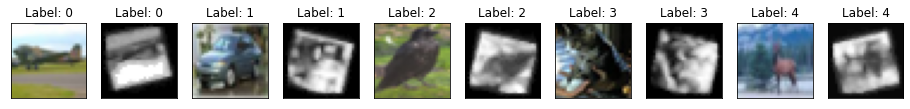

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


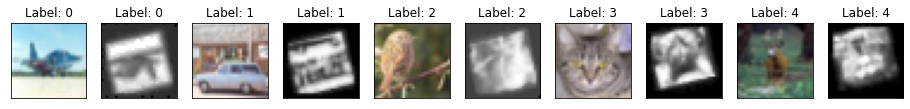

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


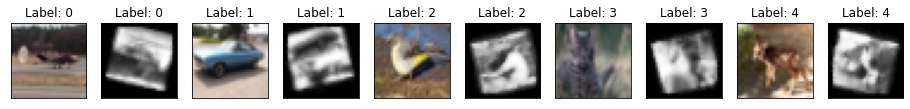

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


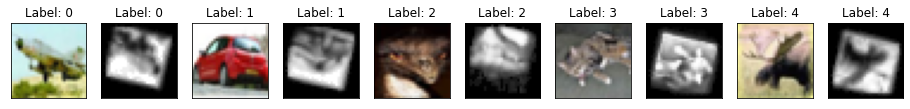

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4507325887680054  TestAcc: 0.4787999987602234
ship 0.768
frog 0.763
automobile 0.609
truck 0.499
dog 0.466
airplane 0.451
horse 0.402
bird 0.367
deer 0.288
cat 0.175


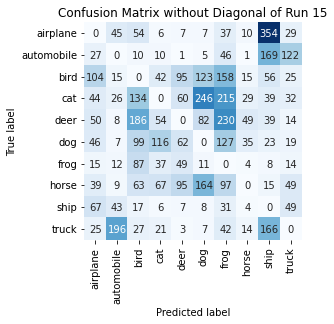

Summing down the rows, for Predictions of each Class that were wrong:  [417. 361. 677. 359. 379. 653. 983. 161. 869. 353.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  95.0 times
Summing across the columns, for total number of that True Class misidentified:  [549. 391. 633. 825. 712. 534. 237. 598. 232. 501.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  230.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16 on Dataset TrainB_Zipped

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )


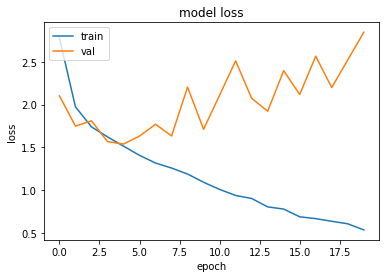

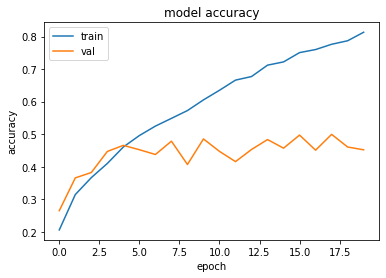

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5389753580093384 , and Val Acc happened to be 0.46560001373291016
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.49939998984336853 and Val Loss happened to be  2.1989388465881348
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


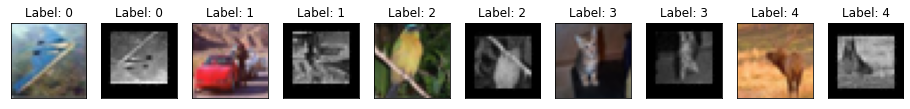

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


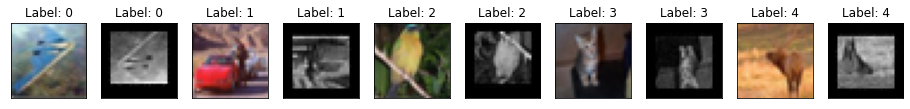

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


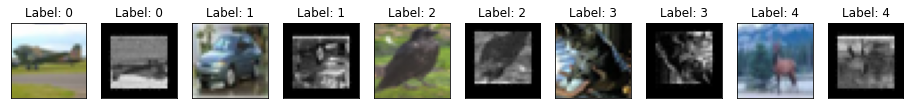

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


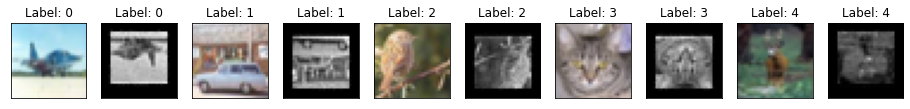

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


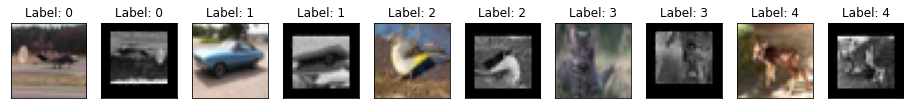

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


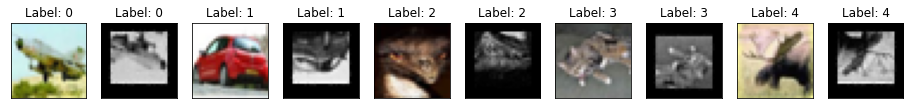

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5180909633636475  TestAcc: 0.4645000100135803
ship 0.732
frog 0.67
automobile 0.586
truck 0.53
dog 0.479
airplane 0.394
horse 0.385
bird 0.382
deer 0.271
cat 0.216


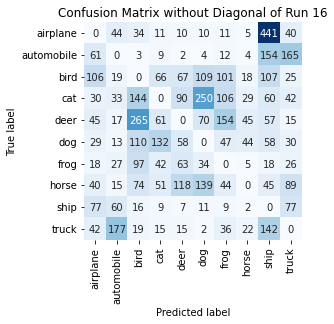

Summing down the rows, for Predictions of each Class that were wrong:  [ 448.  405.  762.  396.  430.  629.  520.  174. 1082.  509.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  118.0 times
Summing across the columns, for total number of that True Class misidentified:  [606. 414. 618. 784. 729. 521. 330. 615. 268. 470.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  265.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17 on Dataset TrainB_Zipped

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut: 

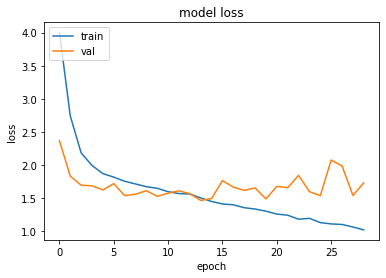

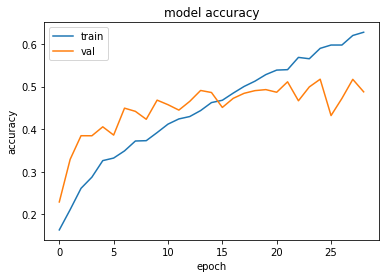

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.4630283117294312 , and Val Acc happened to be 0.49079999327659607
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.5171999931335449 and Val Loss happened to be  1.5347963571548462
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


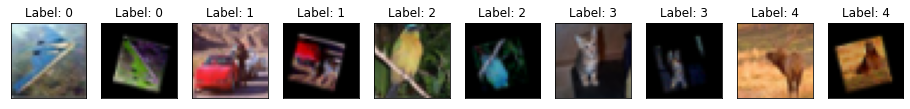

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


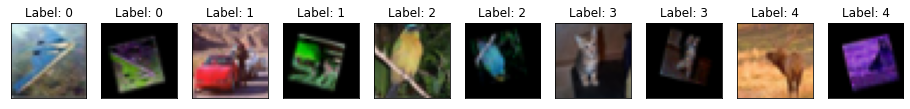

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


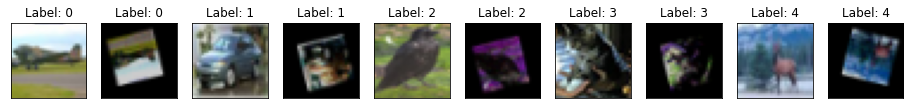

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


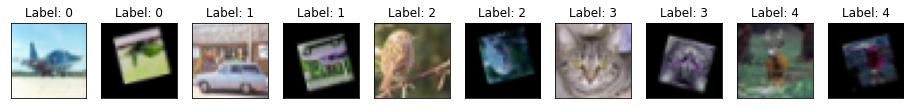

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


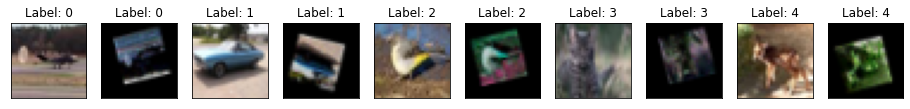

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


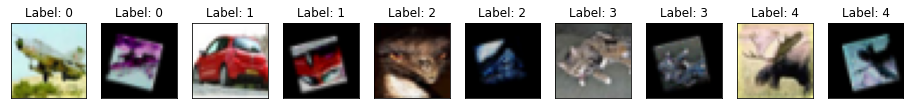

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4327654838562012  TestAcc: 0.4925000071525574
ship 0.725
automobile 0.685
frog 0.666
truck 0.612
dog 0.509
horse 0.475
deer 0.371
cat 0.35
airplane 0.333
bird 0.199


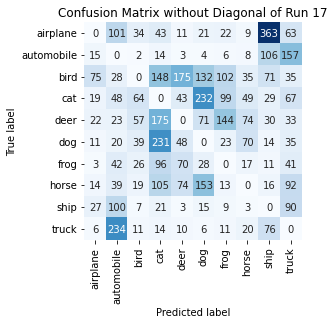

Summing down the rows, for Predictions of each Class that were wrong:  [192. 635. 259. 847. 437. 662. 429. 285. 716. 613.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  175.0 times
Summing across the columns, for total number of that True Class misidentified:  [667. 315. 801. 650. 629. 491. 334. 525. 275. 388.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  175.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18 on Dataset TrainB_Zipped

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn: 

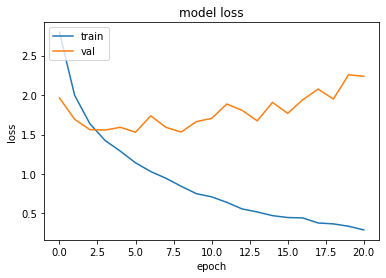

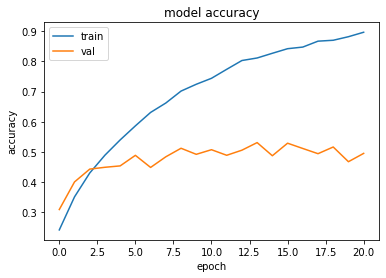

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.528693675994873 , and Val Acc happened to be 0.4885999858379364
Additionally, the best val acc epoch happened to be  13 when val acc was:  0.5309000015258789 and Val Loss happened to be  1.6733664274215698
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


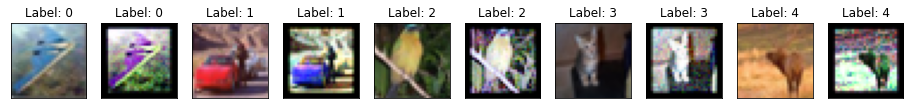

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


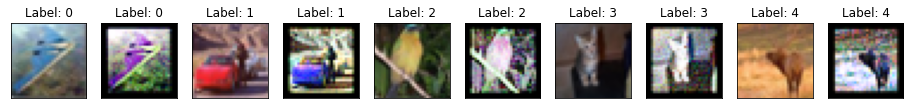

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


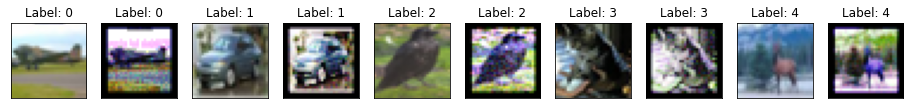

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


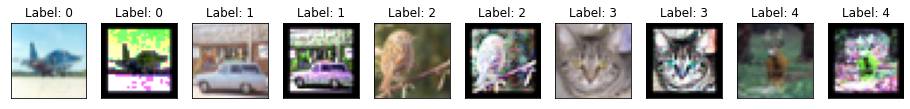

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


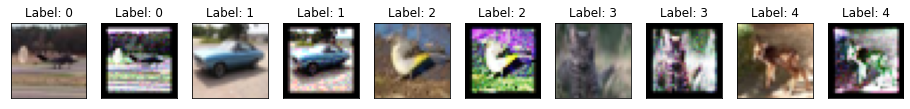

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


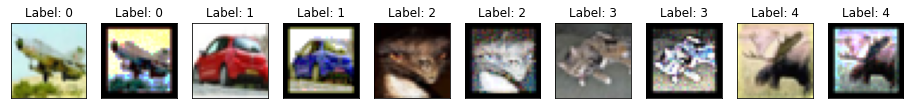

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4874746799468994  TestAcc: 0.4927000105381012
ship 0.792
frog 0.702
automobile 0.614
truck 0.549
horse 0.447
airplane 0.437
deer 0.419
dog 0.385
bird 0.377
cat 0.205


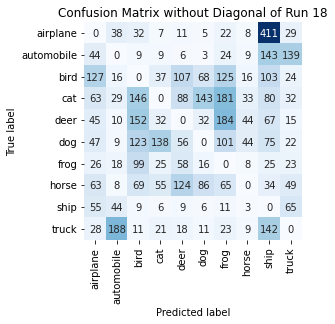

Summing down the rows, for Predictions of each Class that were wrong:  [ 498.  360.  650.  330.  477.  370.  736.  174. 1080.  398.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  124.0 times
Summing across the columns, for total number of that True Class misidentified:  [563. 386. 623. 795. 581. 615. 298. 553. 208. 451.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  184.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19 on Dataset TrainB_Zipped

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16

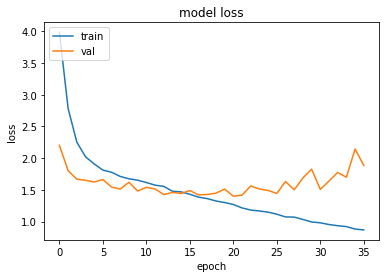

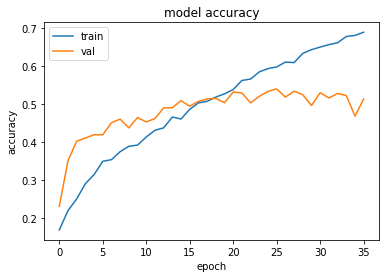

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.4002501964569092 , and Val Acc happened to be 0.5325999855995178
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5406000018119812 and Val Loss happened to be  1.4442431926727295
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


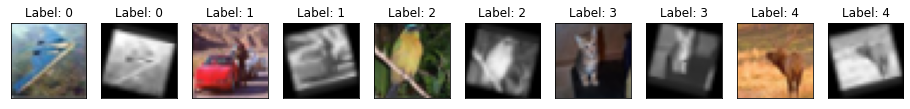

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


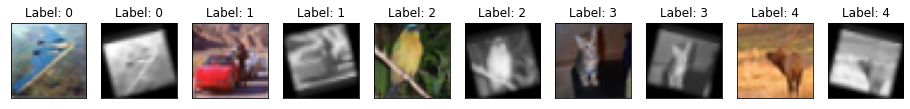

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


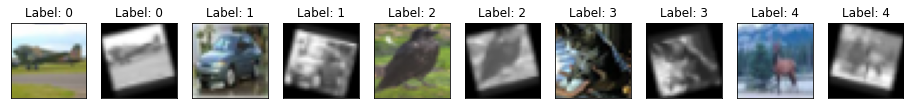

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


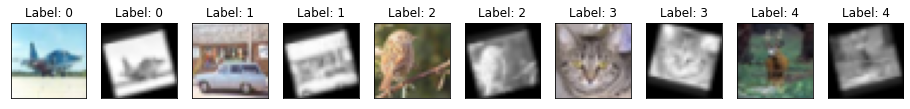

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


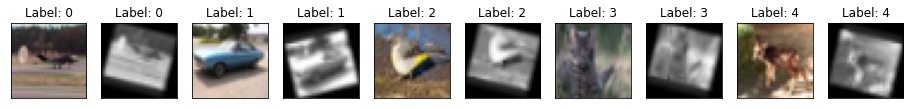

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


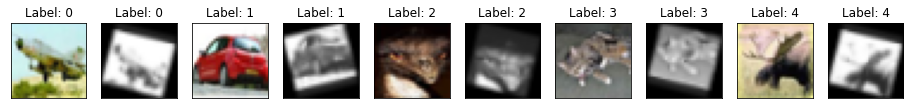

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3554927110671997  TestAcc: 0.5371999740600586
horse 0.731
ship 0.69
automobile 0.681
frog 0.64
airplane 0.614
truck 0.527
dog 0.472
cat 0.359
deer 0.358
bird 0.3


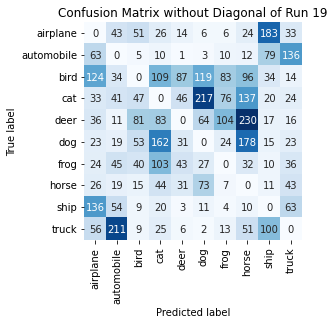

Summing down the rows, for Predictions of each Class that were wrong:  [521. 477. 310. 582. 262. 522. 327. 770. 469. 388.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  87.0 times
Summing across the columns, for total number of that True Class misidentified:  [386. 319. 700. 641. 642. 528. 360. 269. 310. 473.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  230.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20 on Dataset TrainB_Zipped

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:

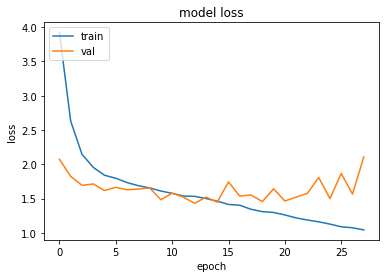

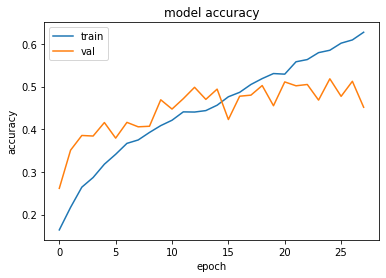

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4318171739578247 , and Val Acc happened to be 0.498199999332428
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.5181000232696533 and Val Loss happened to be  1.4993810653686523
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


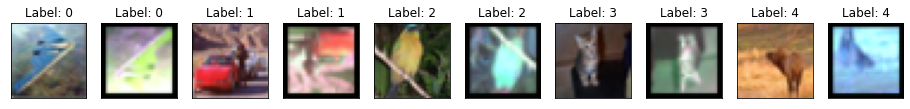

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


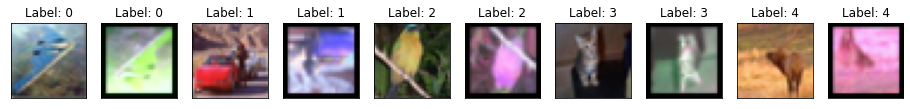

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


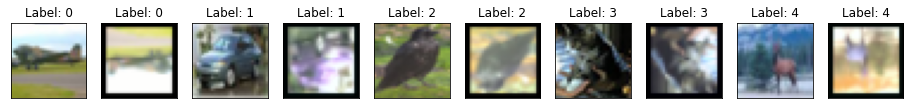

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


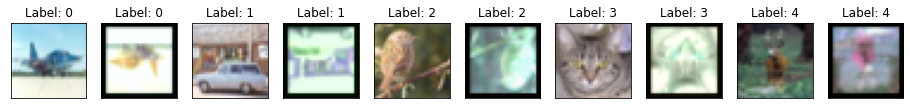

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


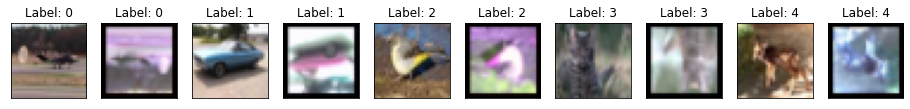

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


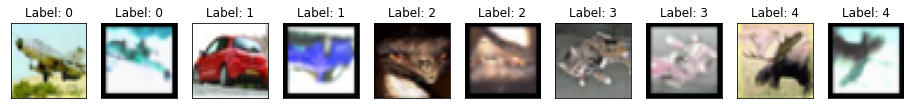

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4113140106201172  TestAcc: 0.4941999912261963
frog 0.699
automobile 0.597
horse 0.592
ship 0.556
deer 0.527
airplane 0.523
dog 0.501
truck 0.471
bird 0.281
cat 0.195


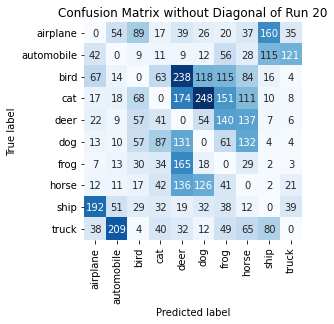

Summing down the rows, for Predictions of each Class that were wrong:  [410. 389. 360. 367. 943. 646. 671. 635. 396. 241.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  238.0 times
Summing across the columns, for total number of that True Class misidentified:  [477. 403. 719. 805. 473. 499. 301. 408. 444. 529.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  140.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21 on Dataset TrainB_Zipped

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , 

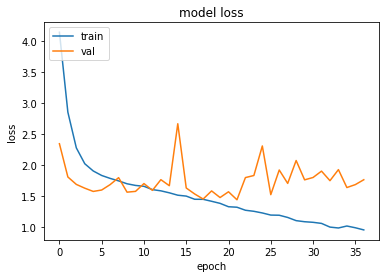

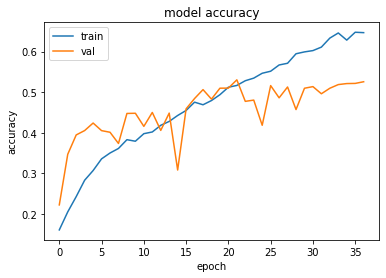

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.4447730779647827 , and Val Acc happened to be 0.5306000113487244
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.5306000113487244 and Val Loss happened to be  1.4447730779647827
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


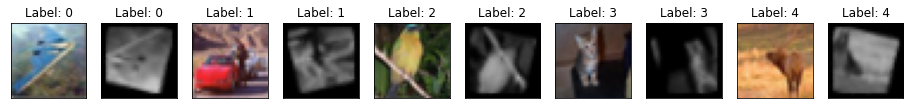

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


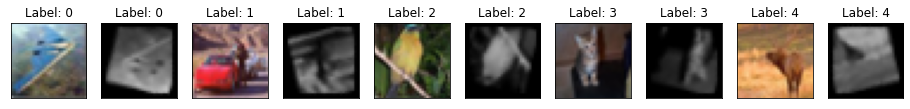

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


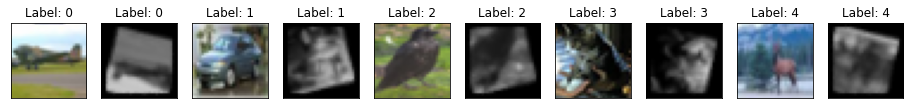

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


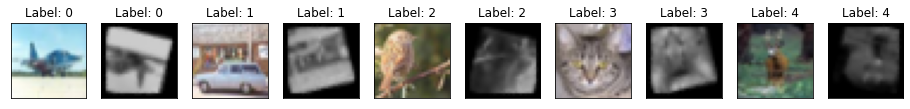

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


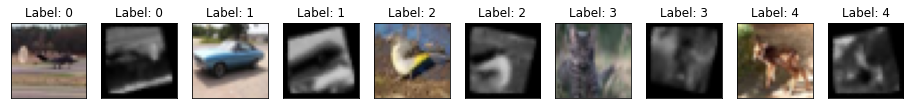

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


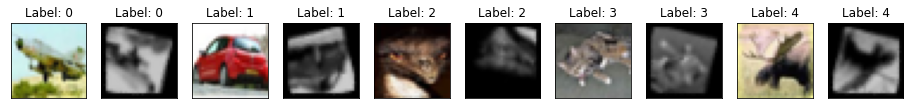

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4035122394561768  TestAcc: 0.5250999927520752
automobile 0.806
frog 0.757
ship 0.595
horse 0.574
airplane 0.567
truck 0.492
deer 0.48
dog 0.422
cat 0.344
bird 0.214


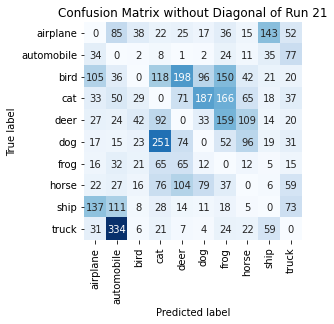

Summing down the rows, for Predictions of each Class that were wrong:  [422. 714. 185. 681. 559. 441. 666. 377. 320. 384.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  198.0 times
Summing across the columns, for total number of that True Class misidentified:  [433. 194. 786. 656. 520. 578. 243. 426. 405. 508.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  159.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22 on Dataset TrainB_Zipped

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:  

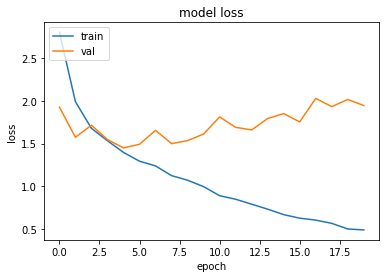

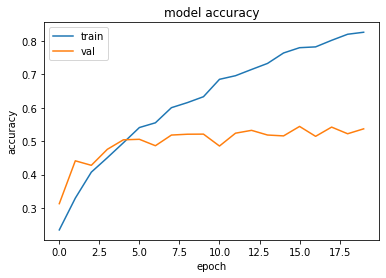

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.4486520290374756 , and Val Acc happened to be 0.5038999915122986
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.5439000129699707 and Val Loss happened to be  1.754048228263855
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


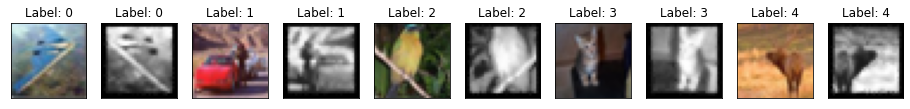

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


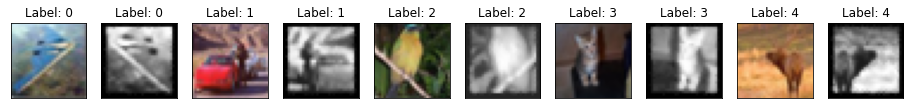

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


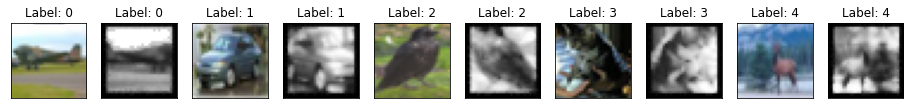

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


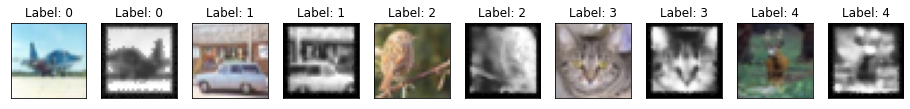

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


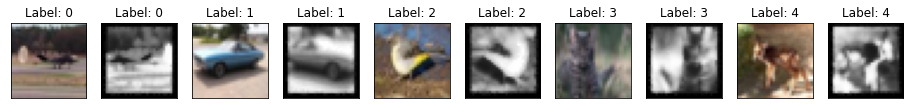

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


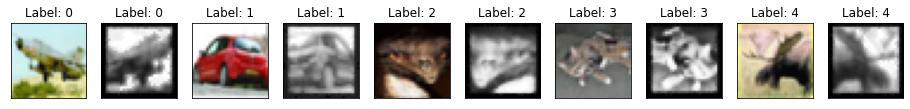

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4130584001541138  TestAcc: 0.506600022315979
ship 0.694
frog 0.609
automobile 0.585
horse 0.565
airplane 0.547
truck 0.546
deer 0.478
dog 0.45
bird 0.384
cat 0.208


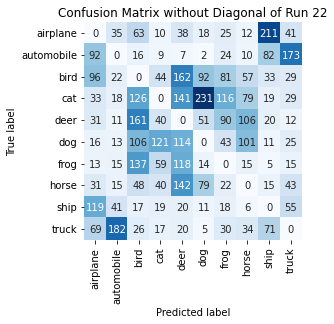

Summing down the rows, for Predictions of each Class that were wrong:  [500. 352. 700. 359. 762. 503. 449. 420. 467. 422.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  162.0 times
Summing across the columns, for total number of that True Class misidentified:  [453. 415. 616. 792. 522. 550. 391. 435. 306. 454.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  161.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23 on Dataset TrainB_Zipped

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Z

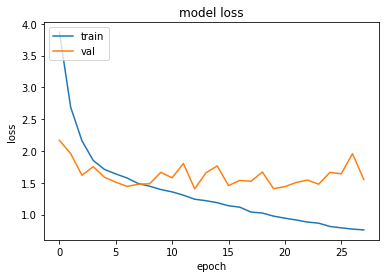

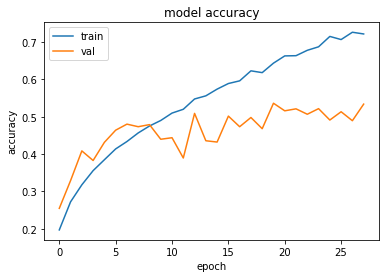

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4040985107421875 , and Val Acc happened to be 0.5090000033378601
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5361999869346619 and Val Loss happened to be  1.4067072868347168
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


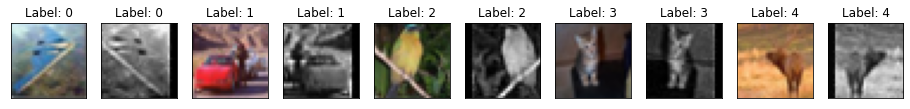

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


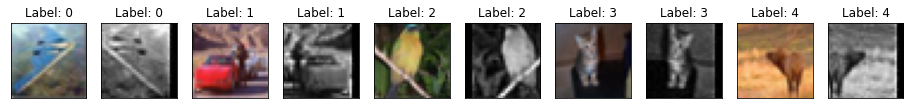

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


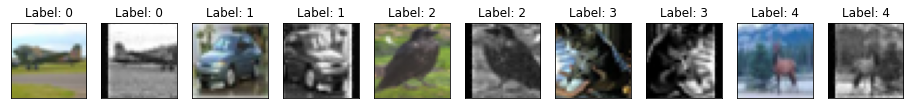

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


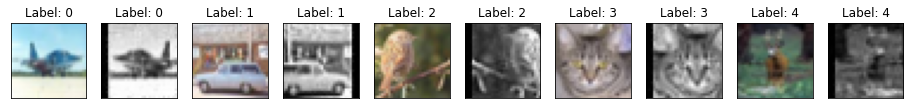

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


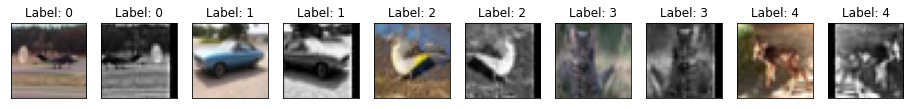

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


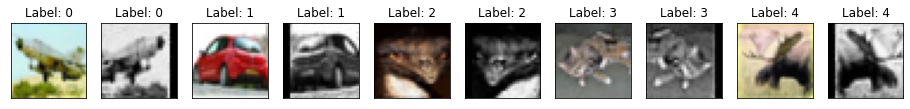

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3725659847259521  TestAcc: 0.5081999897956848
truck 0.751
frog 0.705
ship 0.663
horse 0.582
deer 0.57
automobile 0.528
dog 0.523
cat 0.306
airplane 0.256
bird 0.198


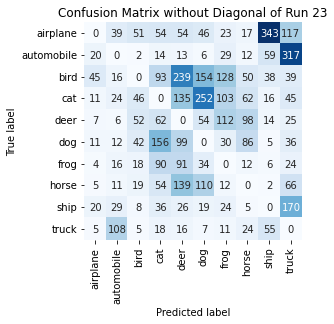

Summing down the rows, for Predictions of each Class that were wrong:  [128. 261. 243. 577. 812. 682. 472. 366. 538. 839.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  239.0 times
Summing across the columns, for total number of that True Class misidentified:  [744. 472. 802. 694. 430. 477. 295. 418. 337. 249.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  112.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24 on Dataset TrainB_Zipped

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:

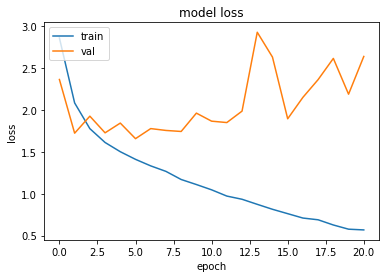

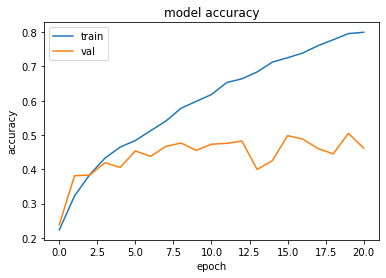

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.6578130722045898 , and Val Acc happened to be 0.45350000262260437
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.504800021648407 and Val Loss happened to be  2.1890788078308105
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


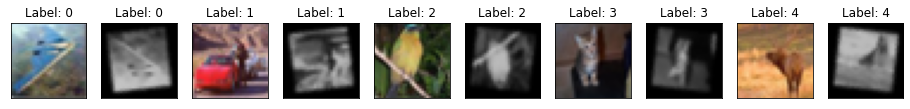

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


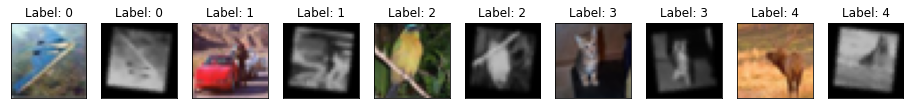

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


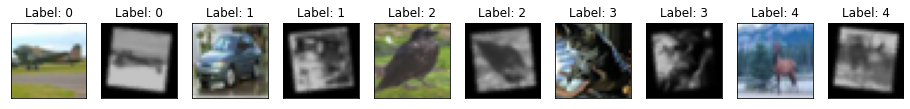

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


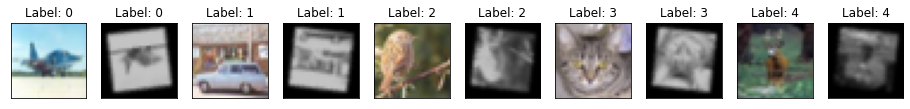

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


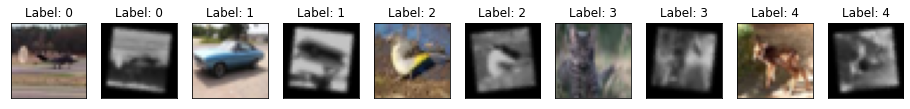

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


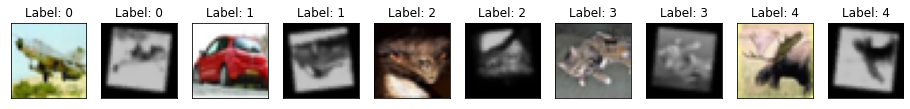

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.6399577856063843  TestAcc: 0.4551999866962433
frog 0.755
automobile 0.752
ship 0.663
truck 0.54
deer 0.433
horse 0.405
airplane 0.354
bird 0.316
cat 0.197
dog 0.137


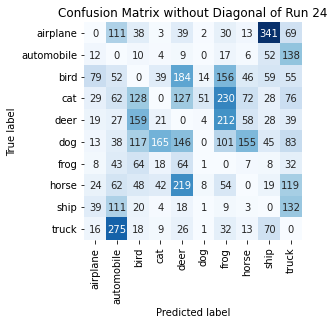

Summing down the rows, for Predictions of each Class that were wrong:  [239. 781. 602. 305. 832.  82. 841. 373. 650. 743.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  219.0 times
Summing across the columns, for total number of that True Class misidentified:  [646. 248. 684. 803. 567. 863. 245. 595. 337. 460.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  212.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25 on Dataset TrainB_Zipped

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 ,

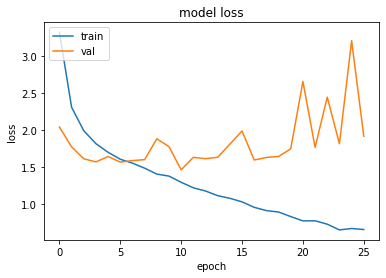

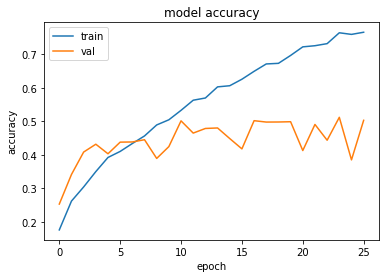

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.4638044834136963 , and Val Acc happened to be 0.5009999871253967
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.5116000175476074 and Val Loss happened to be  1.8167543411254883
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


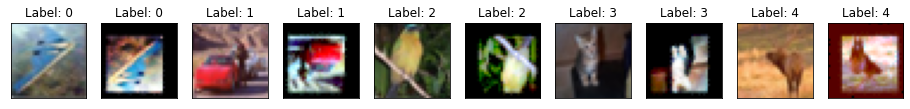

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


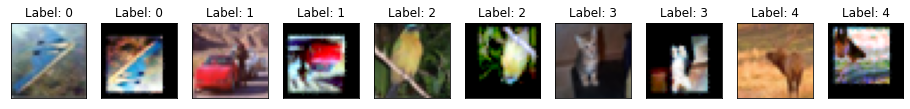

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


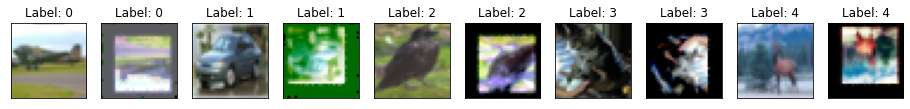

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


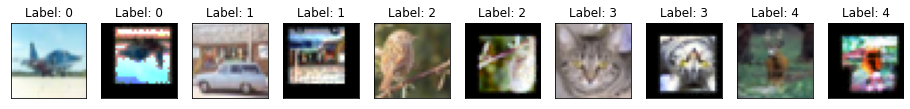

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


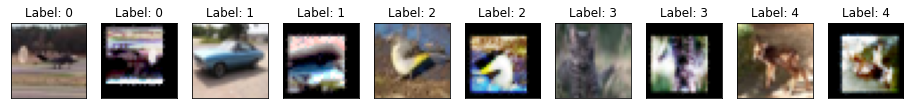

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


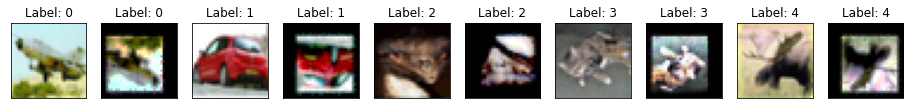

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4458413124084473  TestAcc: 0.49540001153945923
frog 0.747
ship 0.679
truck 0.664
deer 0.558
horse 0.552
automobile 0.509
airplane 0.45
dog 0.389
cat 0.264
bird 0.142


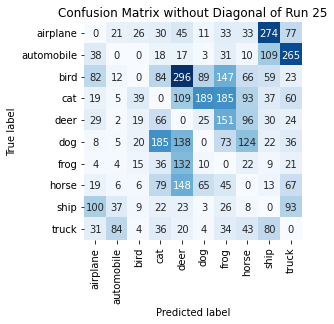

Summing down the rows, for Predictions of each Class that were wrong:  [330. 176. 138. 556. 928. 399. 725. 495. 633. 666.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  296.0 times
Summing across the columns, for total number of that True Class misidentified:  [550. 491. 858. 736. 442. 611. 253. 448. 321. 336.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  151.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26 on Dataset TrainB_Zipped

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , 

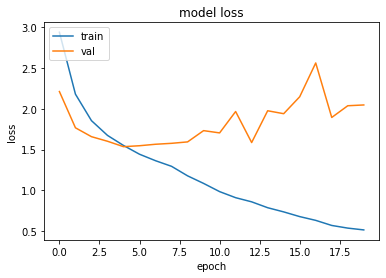

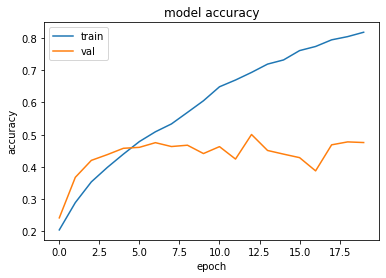

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5357359647750854 , and Val Acc happened to be 0.4577000141143799
Additionally, the best val acc epoch happened to be  12 when val acc was:  0.5005999803543091 and Val Loss happened to be  1.586266040802002
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


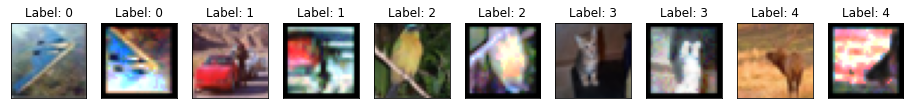

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


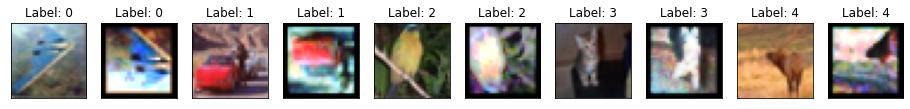

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


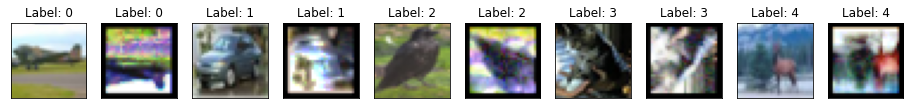

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


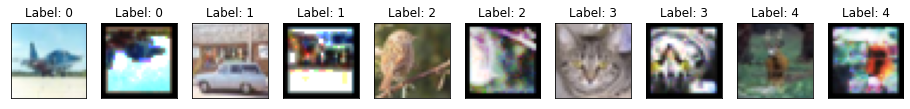

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


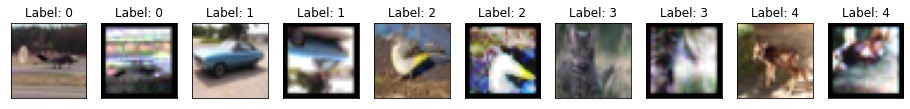

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


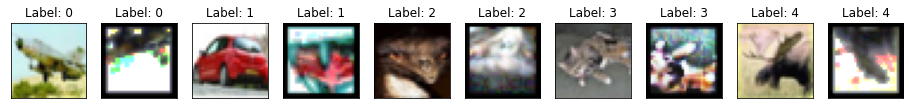

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5251948833465576  TestAcc: 0.45820000767707825
ship 0.661
frog 0.631
truck 0.534
airplane 0.494
automobile 0.487
bird 0.465
dog 0.442
horse 0.411
deer 0.276
cat 0.181


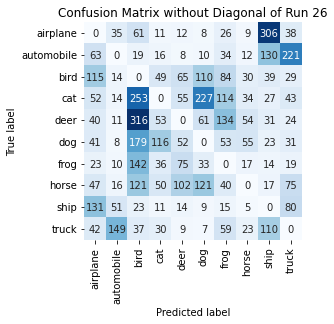

Summing down the rows, for Predictions of each Class that were wrong:  [ 554.  308. 1151.  372.  392.  586.  559.  239.  697.  560.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  102.0 times
Summing across the columns, for total number of that True Class misidentified:  [506. 513. 535. 819. 724. 558. 369. 589. 339. 466.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  316.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27 on Dataset TrainB_Zipped

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16

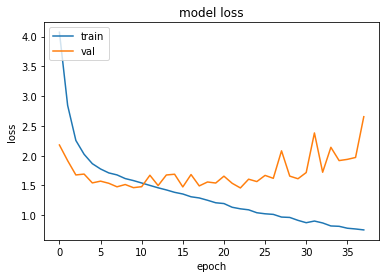

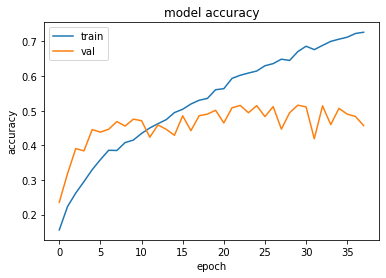

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.4586634635925293 , and Val Acc happened to be 0.5152000188827515
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5159000158309937 and Val Loss happened to be  1.6132116317749023
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


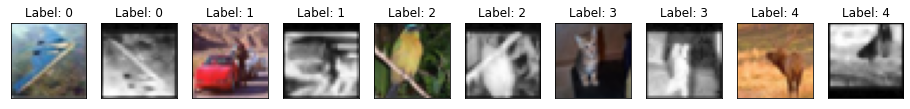

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


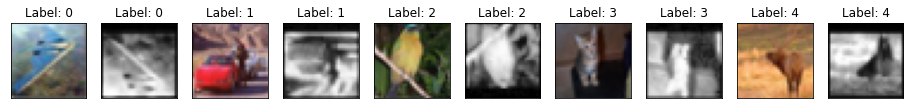

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


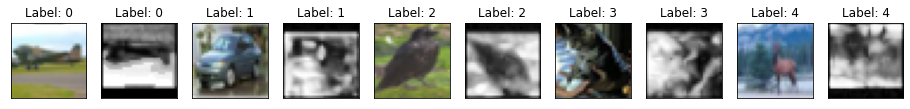

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


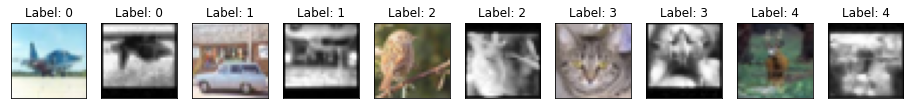

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


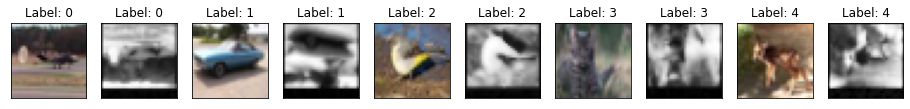

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


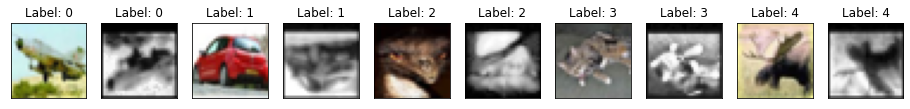

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4204243421554565  TestAcc: 0.5178999900817871
frog 0.731
truck 0.724
ship 0.66
dog 0.491
automobile 0.482
bird 0.468
airplane 0.451
deer 0.426
horse 0.419
cat 0.327


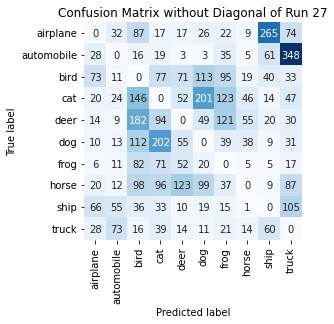

Summing down the rows, for Predictions of each Class that were wrong:  [265. 240. 775. 648. 397. 541. 508. 192. 483. 772.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  123.0 times
Summing across the columns, for total number of that True Class misidentified:  [549. 518. 532. 673. 574. 509. 269. 581. 340. 276.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  182.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28 on Dataset TrainB_Zipped

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )

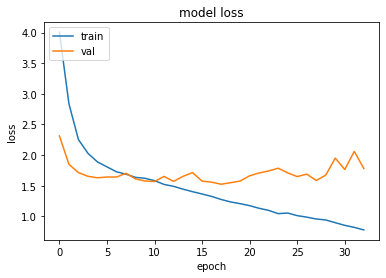

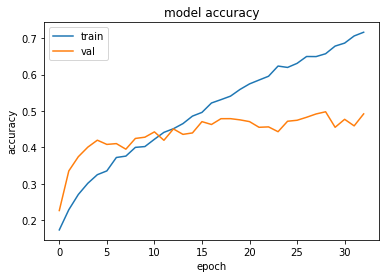

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.524368405342102 , and Val Acc happened to be 0.47870001196861267
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.4977000057697296 and Val Loss happened to be  1.6730800867080688
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


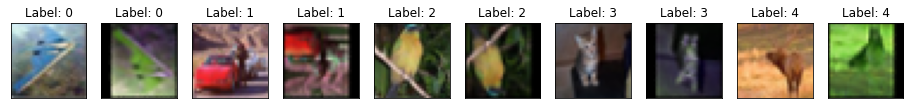

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


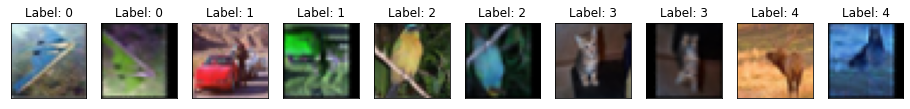

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


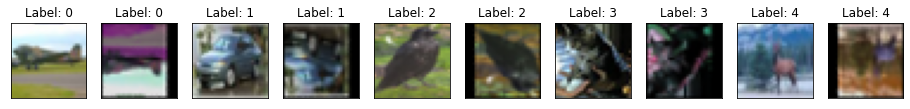

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


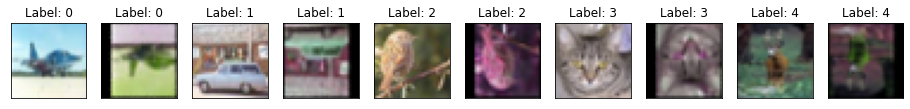

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


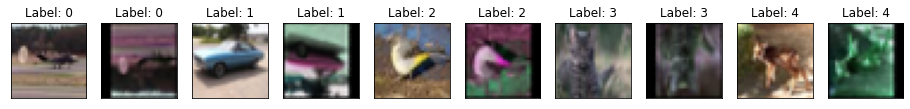

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


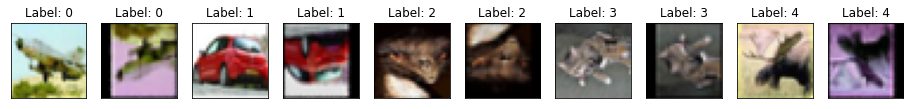

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5030475854873657  TestAcc: 0.48249998688697815
frog 0.784
truck 0.688
horse 0.61
automobile 0.597
ship 0.587
deer 0.411
dog 0.411
airplane 0.29
cat 0.275
bird 0.172


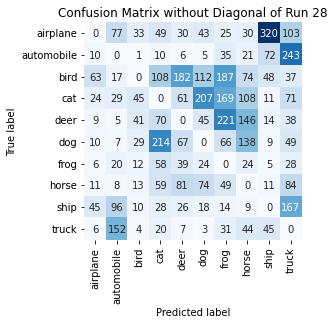

Summing down the rows, for Predictions of each Class that were wrong:  [184. 411. 188. 616. 499. 531. 797. 594. 535. 820.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  182.0 times
Summing across the columns, for total number of that True Class misidentified:  [710. 403. 828. 725. 589. 589. 216. 390. 413. 312.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  221.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29 on Dataset TrainB_Zipped

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Z

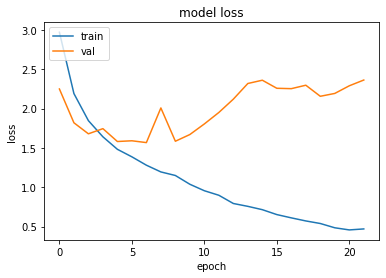

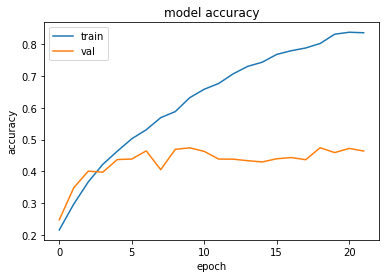

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.568136215209961 , and Val Acc happened to be 0.4645000100135803
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.47440001368522644 and Val Loss happened to be  2.157460927963257
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


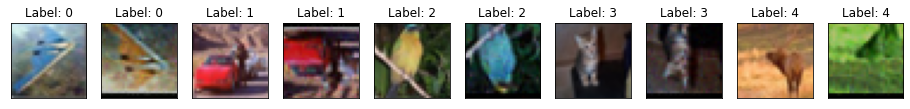

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


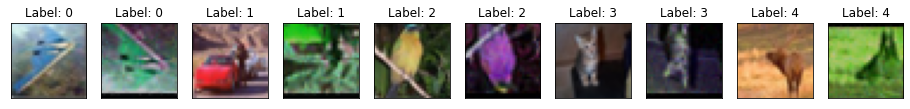

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


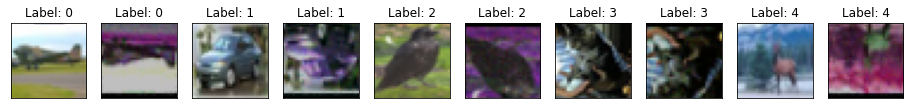

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


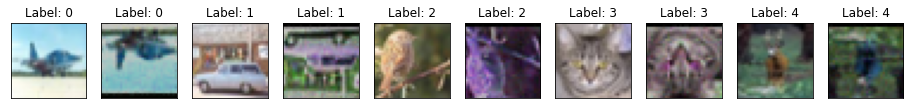

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


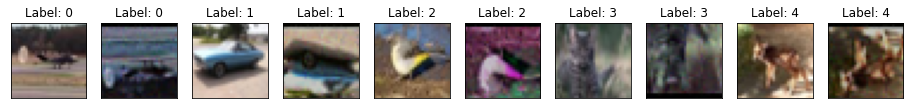

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


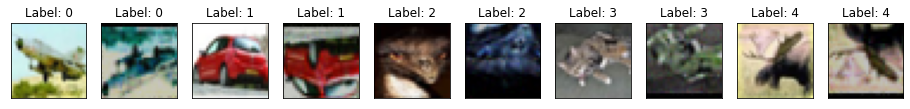

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5591758489608765  TestAcc: 0.4652000069618225
frog 0.716
ship 0.653
automobile 0.63
truck 0.54
horse 0.441
airplane 0.416
dog 0.35
cat 0.319
deer 0.294
bird 0.293


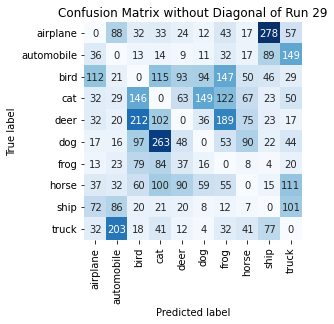

Summing down the rows, for Predictions of each Class that were wrong:  [383. 518. 677. 773. 396. 389. 685. 372. 577. 578.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  93.0 times
Summing across the columns, for total number of that True Class misidentified:  [584. 370. 707. 681. 706. 650. 284. 559. 347. 460.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  212.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30 on Dataset TrainB_Zipped

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn: 

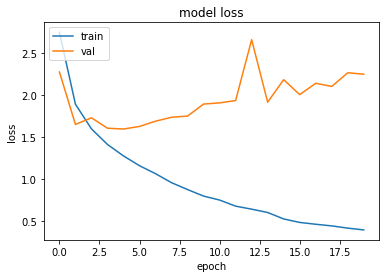

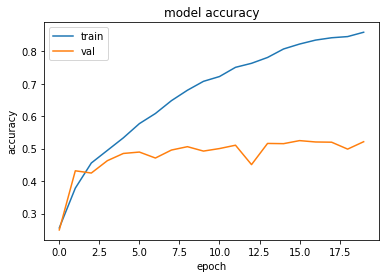

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5940639972686768 , and Val Acc happened to be 0.4851999878883362
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.5248000025749207 and Val Loss happened to be  2.002551555633545
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


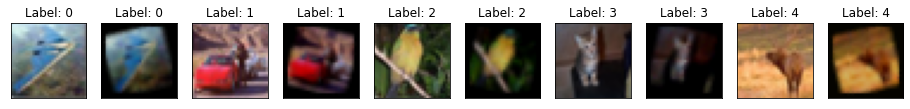

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


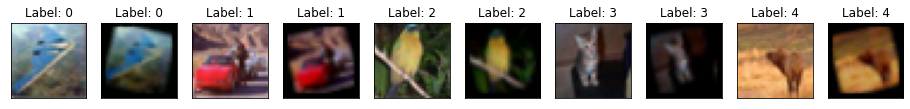

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


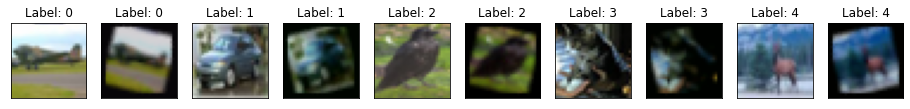

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


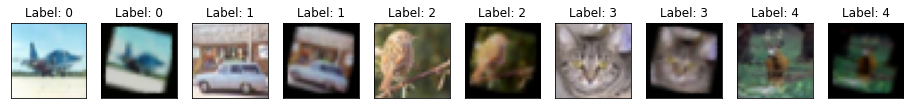

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


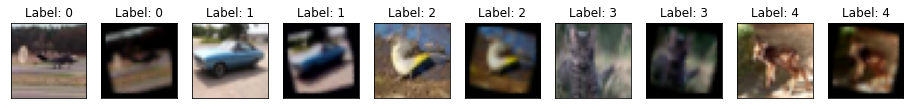

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


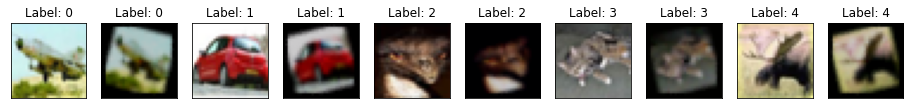

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.562624454498291  TestAcc: 0.48510000109672546
frog 0.703
automobile 0.698
horse 0.601
truck 0.588
airplane 0.553
ship 0.504
deer 0.464
dog 0.311
cat 0.302
bird 0.127


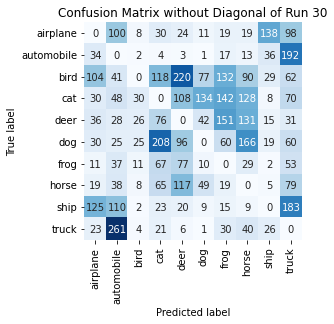

Summing down the rows, for Predictions of each Class that were wrong:  [412. 688. 116. 612. 671. 334. 585. 625. 278. 828.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  220.0 times
Summing across the columns, for total number of that True Class misidentified:  [447. 302. 873. 698. 536. 689. 297. 399. 496. 412.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  151.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31 on Dataset TrainB_Zipped

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 ,

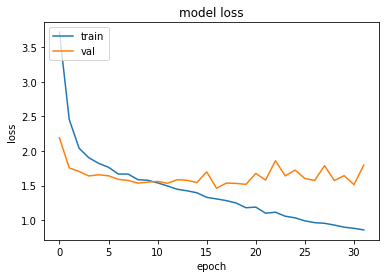

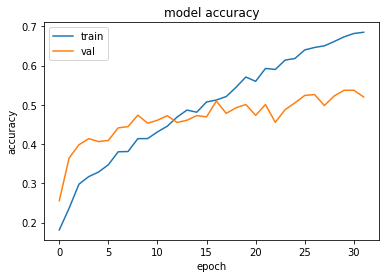

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  16 when  Val Loss was:  1.461654543876648 , and Val Acc happened to be 0.5095999836921692
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5371999740600586 and Val Loss happened to be  1.5130175352096558
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


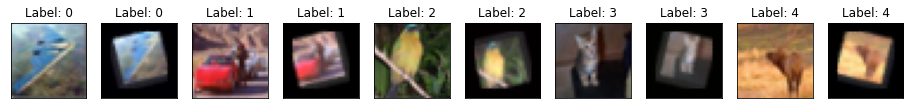

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


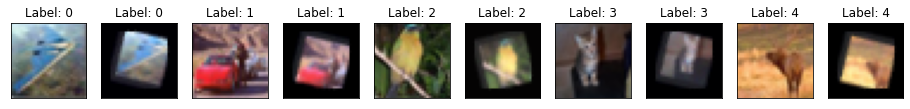

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


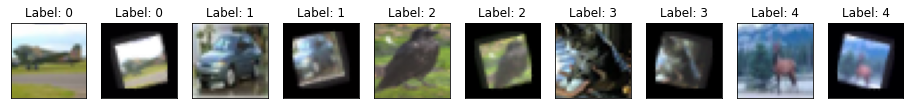

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


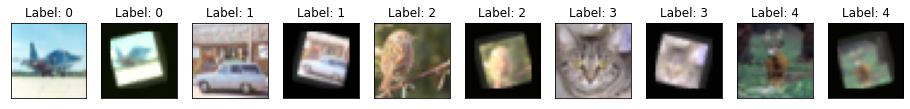

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


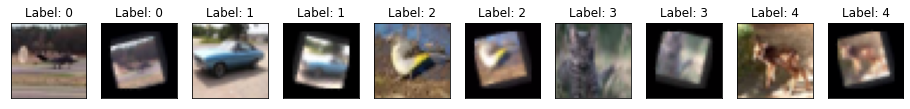

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


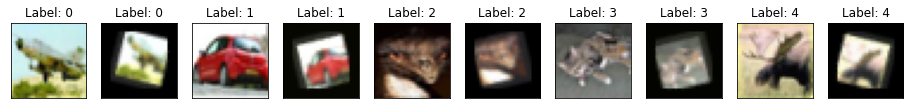

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.421909213066101  TestAcc: 0.5148000121116638
frog 0.801
ship 0.718
automobile 0.679
dog 0.653
truck 0.534
airplane 0.489
horse 0.464
bird 0.31
deer 0.258
cat 0.242


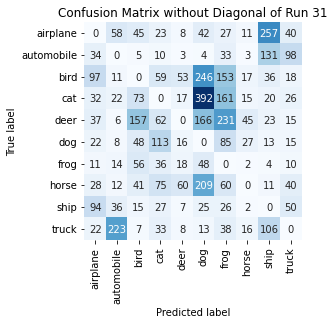

Summing down the rows, for Predictions of each Class that were wrong:  [ 377.  390.  447.  438.  190. 1145.  814.  138.  601.  312.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  60.0 times
Summing across the columns, for total number of that True Class misidentified:  [511. 321. 690. 758. 742. 347. 199. 536. 282. 466.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  231.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32 on Dataset TrainB_Zipped

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 

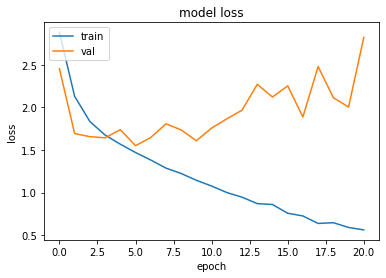

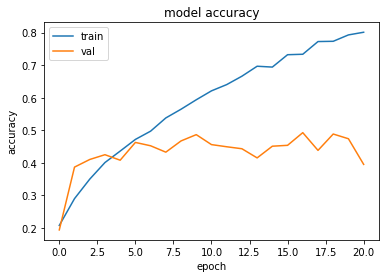

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.5493382215499878 , and Val Acc happened to be 0.4625999927520752
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.4925999939441681 and Val Loss happened to be  1.8864728212356567
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


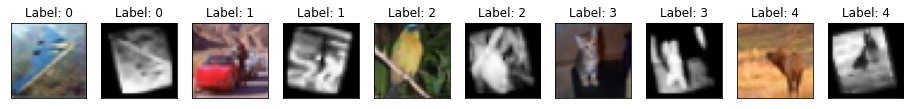

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


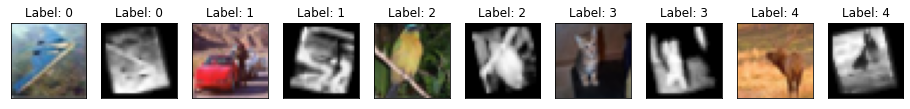

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


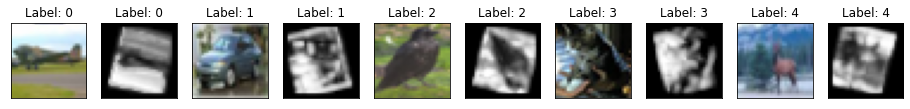

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


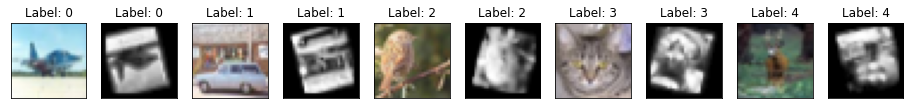

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


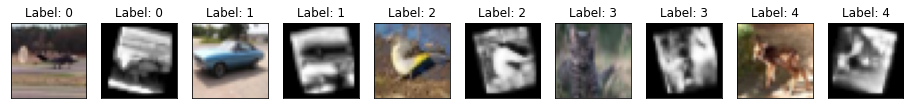

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


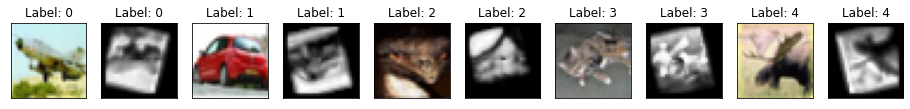

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5088907480239868  TestAcc: 0.4724000096321106
frog 0.775
automobile 0.607
ship 0.539
airplane 0.533
dog 0.494
truck 0.488
horse 0.428
cat 0.349
deer 0.305
bird 0.206


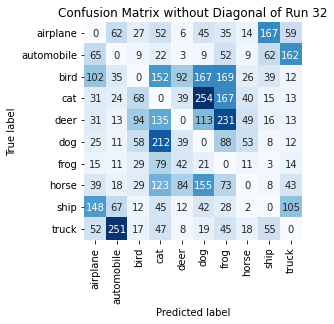

Summing down the rows, for Predictions of each Class that were wrong:  [508. 492. 343. 867. 325. 825. 888. 222. 373. 433.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  92.0 times
Summing across the columns, for total number of that True Class misidentified:  [467. 393. 794. 651. 695. 506. 225. 572. 461. 512.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  231.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33 on Dataset TrainB_Zipped

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   

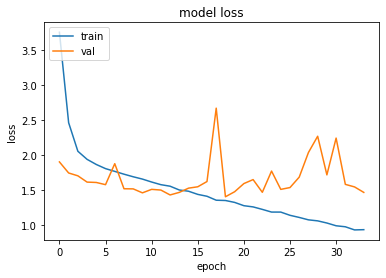

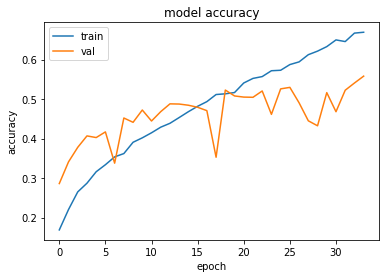

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  18 when  Val Loss was:  1.404253363609314 , and Val Acc happened to be 0.5227000117301941
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5579000115394592 and Val Loss happened to be  1.466510534286499
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


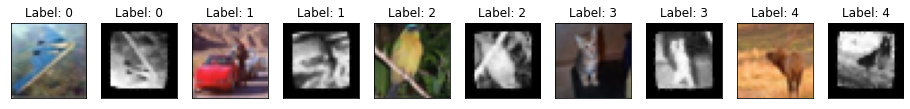

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


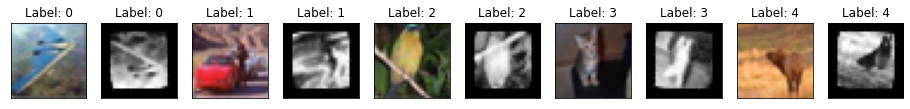

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


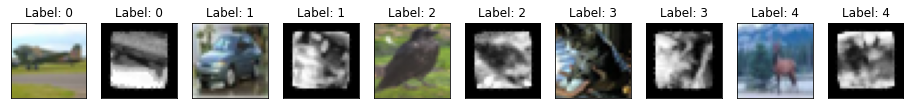

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


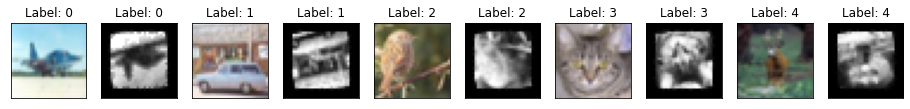

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


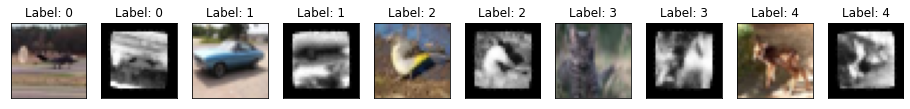

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


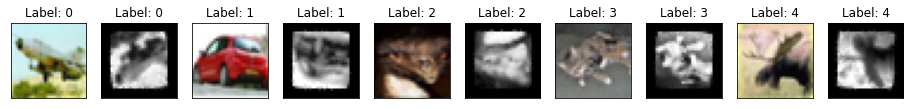

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3752361536026  TestAcc: 0.5288000106811523
frog 0.737
truck 0.726
ship 0.638
horse 0.62
dog 0.527
automobile 0.49
airplane 0.47
deer 0.436
cat 0.424
bird 0.22


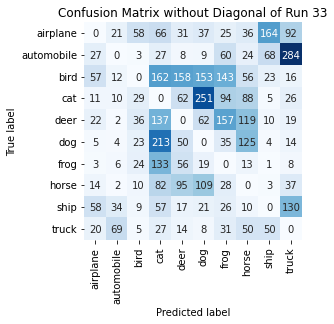

Summing down the rows, for Predictions of each Class that were wrong:  [217. 160. 197. 904. 491. 669. 599. 521. 328. 626.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  158.0 times
Summing across the columns, for total number of that True Class misidentified:  [530. 510. 780. 576. 564. 473. 263. 380. 362. 274.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  157.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34 on Dataset TrainB_Zipped

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:

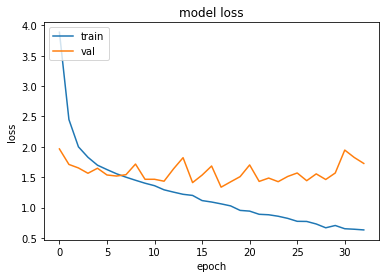

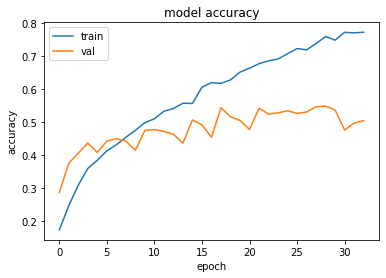

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.335524559020996 , and Val Acc happened to be 0.542900025844574
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5476999878883362 and Val Loss happened to be  1.4618650674819946
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


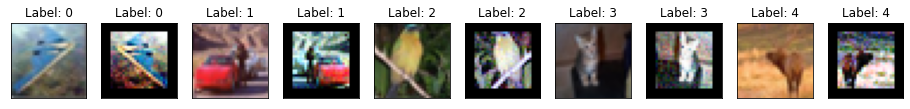

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


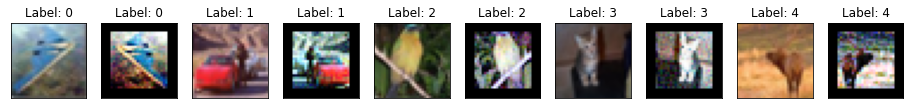

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


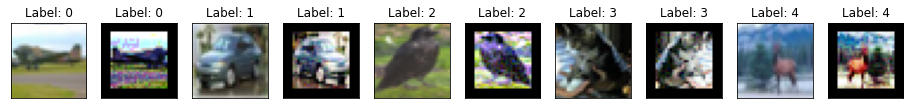

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


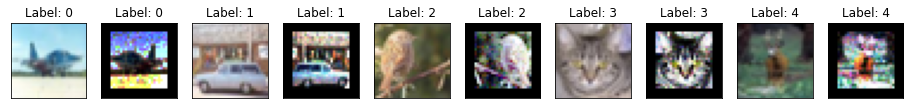

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


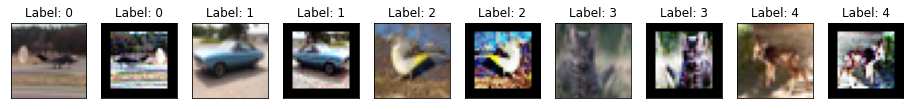

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


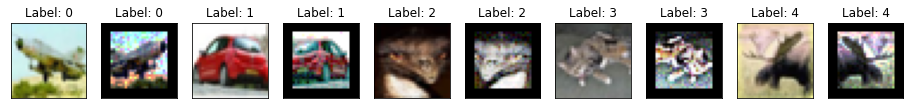

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3005353212356567  TestAcc: 0.5401999950408936
automobile 0.771
ship 0.694
dog 0.685
frog 0.659
truck 0.561
airplane 0.533
horse 0.498
bird 0.427
deer 0.302
cat 0.272


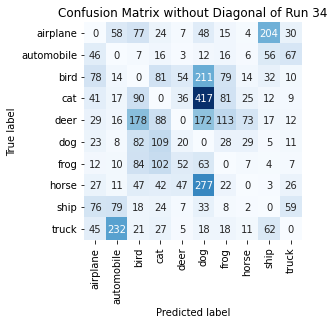

Summing down the rows, for Predictions of each Class that were wrong:  [ 377.  445.  604.  513.  231. 1251.  380.  171.  395.  231.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  54.0 times
Summing across the columns, for total number of that True Class misidentified:  [467. 229. 573. 728. 698. 315. 341. 502. 306. 439.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  178.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35 on Dataset TrainB_Zipped

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 

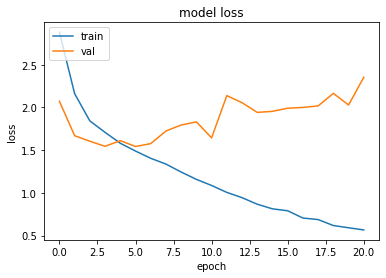

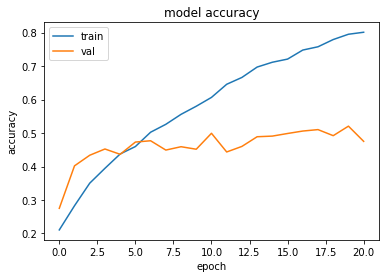

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.5427786111831665 , and Val Acc happened to be 0.4729999899864197
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5205000042915344 and Val Loss happened to be  2.028968334197998
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


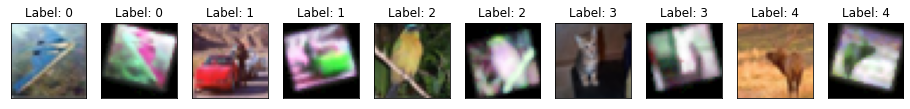

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


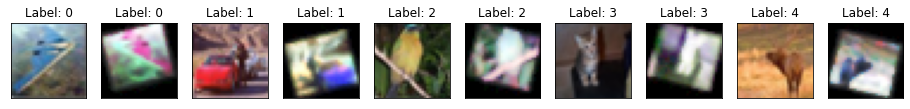

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


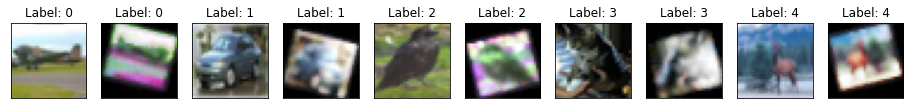

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


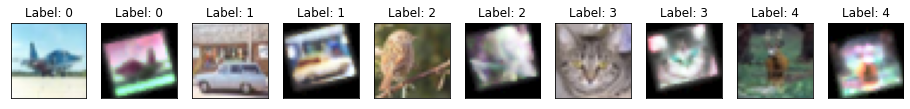

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


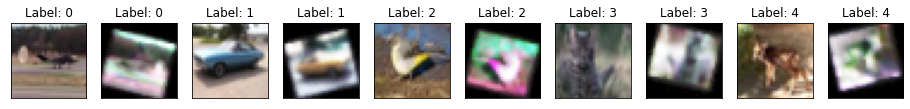

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


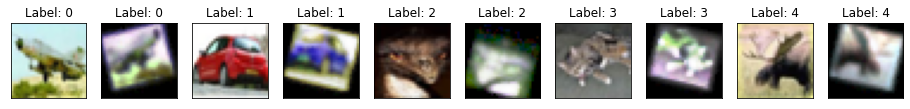

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5015311241149902  TestAcc: 0.4832000136375427
frog 0.731
automobile 0.665
ship 0.643
horse 0.529
airplane 0.511
dog 0.44
truck 0.376
bird 0.34
deer 0.337
cat 0.26


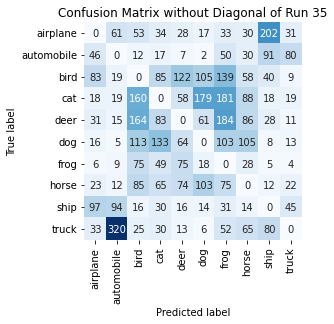

Summing down the rows, for Predictions of each Class that were wrong:  [353. 554. 703. 526. 457. 505. 848. 504. 484. 234.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  122.0 times
Summing across the columns, for total number of that True Class misidentified:  [489. 335. 660. 740. 663. 560. 269. 471. 357. 624.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  184.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36 on Dataset TrainB_Zipped

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Z

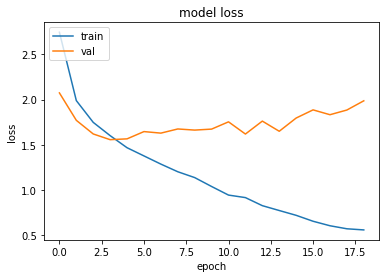

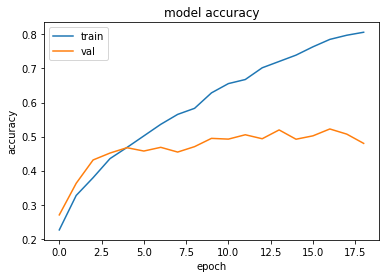

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.557778239250183 , and Val Acc happened to be 0.45170000195503235
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5224000215530396 and Val Loss happened to be  1.833390474319458
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


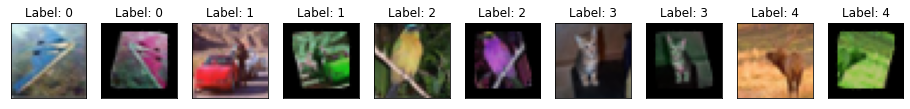

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


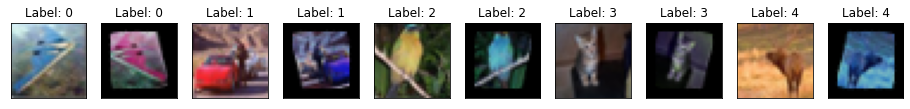

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


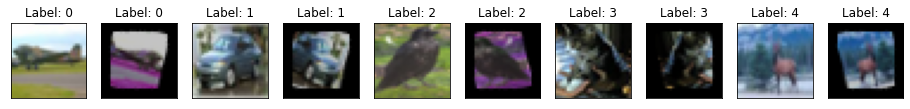

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


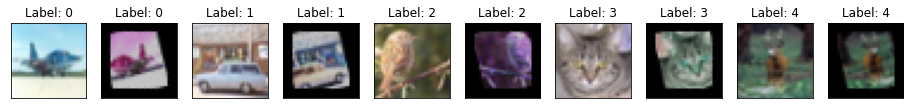

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


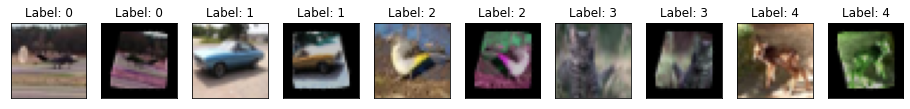

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


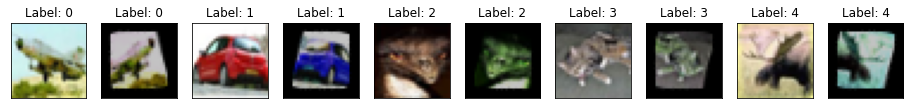

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5278246402740479  TestAcc: 0.45840001106262207
frog 0.731
ship 0.675
automobile 0.615
horse 0.491
truck 0.463
airplane 0.441
dog 0.387
bird 0.287
cat 0.261
deer 0.233


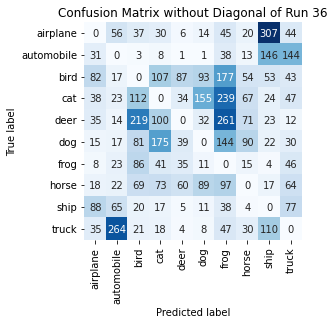

Summing down the rows, for Predictions of each Class that were wrong:  [ 350.  501.  648.  569.  271.  414. 1086.  364.  706.  507.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  87.0 times
Summing across the columns, for total number of that True Class misidentified:  [559. 385. 713. 739. 767. 613. 269. 509. 325. 537.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  261.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37 on Dataset TrainB_Zipped

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  

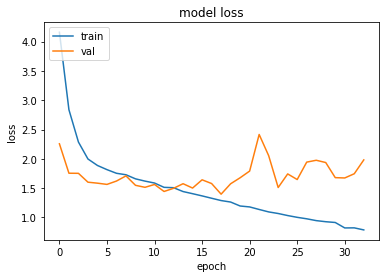

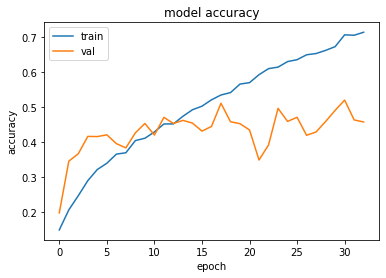

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.3977175951004028 , and Val Acc happened to be 0.511900007724762
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5210000276565552 and Val Loss happened to be  1.6741095781326294
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


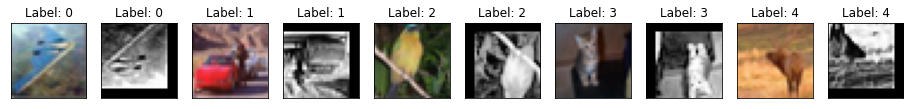

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


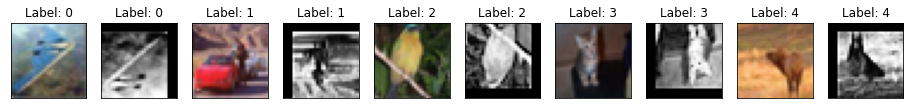

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


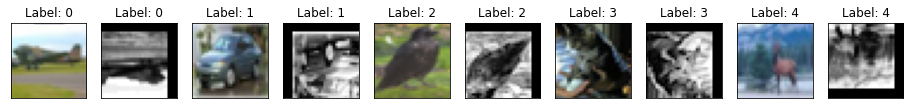

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


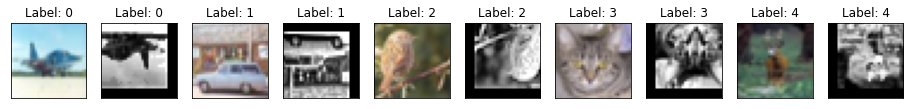

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


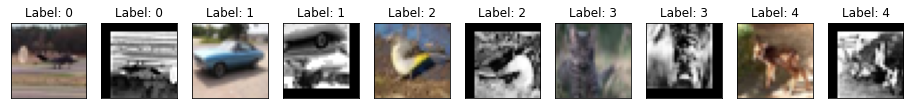

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


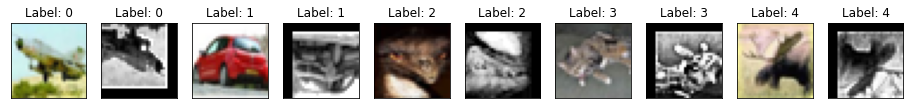

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3664872646331787  TestAcc: 0.5019000172615051
frog 0.794
automobile 0.734
dog 0.561
airplane 0.545
ship 0.531
truck 0.504
horse 0.443
bird 0.358
cat 0.279
deer 0.27


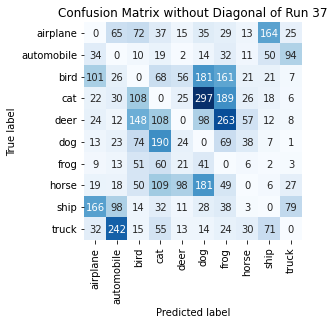

Summing down the rows, for Predictions of each Class that were wrong:  [420. 527. 542. 678. 265. 889. 854. 205. 351. 250.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  98.0 times
Summing across the columns, for total number of that True Class misidentified:  [455. 266. 642. 721. 730. 439. 206. 557. 469. 496.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  263.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38 on Dataset TrainB_Zipped

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zo

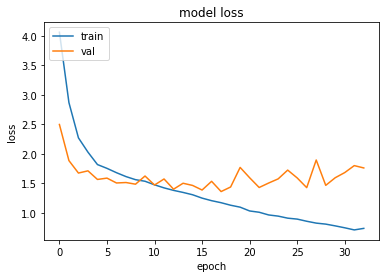

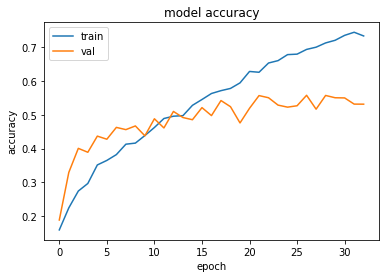

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.3580799102783203 , and Val Acc happened to be 0.5422999858856201
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5579000115394592 and Val Loss happened to be  1.424587607383728
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


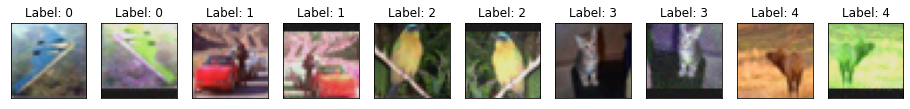

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


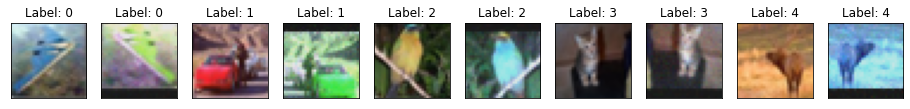

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


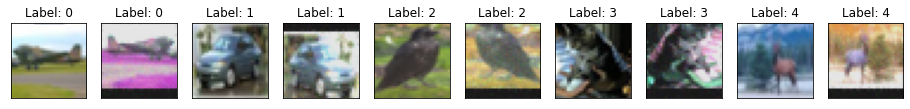

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


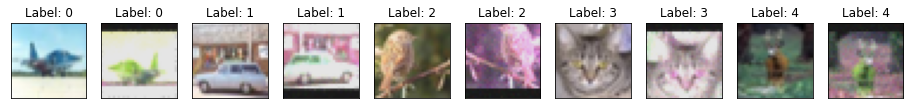

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


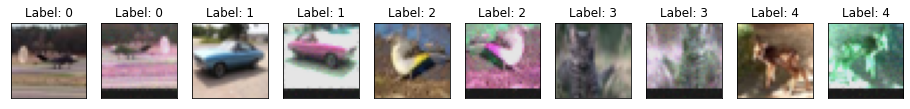

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


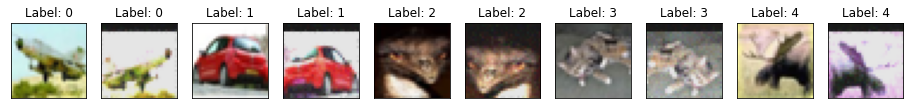

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3107997179031372  TestAcc: 0.5476999878883362
frog 0.709
truck 0.704
automobile 0.668
horse 0.627
ship 0.62
dog 0.566
airplane 0.522
deer 0.472
bird 0.298
cat 0.291


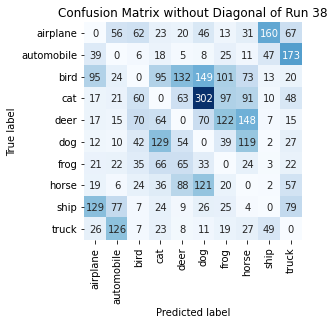

Summing down the rows, for Predictions of each Class that were wrong:  [375. 357. 313. 478. 444. 766. 461. 528. 293. 508.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  132.0 times
Summing across the columns, for total number of that True Class misidentified:  [478. 332. 702. 709. 528. 434. 291. 373. 380. 296.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  148.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39 on Dataset TrainB_Zipped

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )


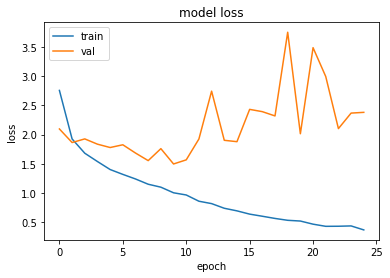

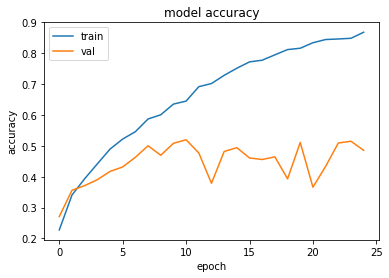

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.4973660707473755 , and Val Acc happened to be 0.5080999732017517
Additionally, the best val acc epoch happened to be  10 when val acc was:  0.5196999907493591 and Val Loss happened to be  1.5679075717926025
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


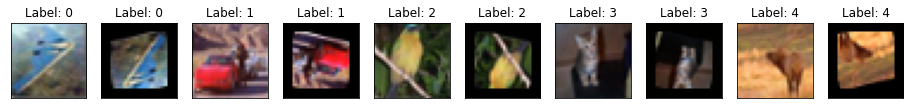

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


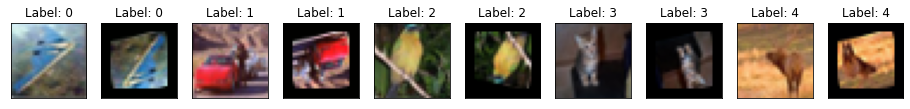

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


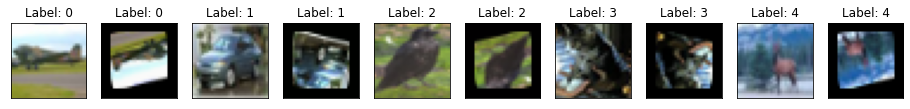

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


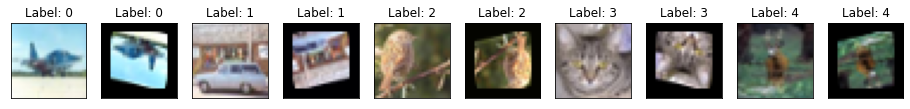

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


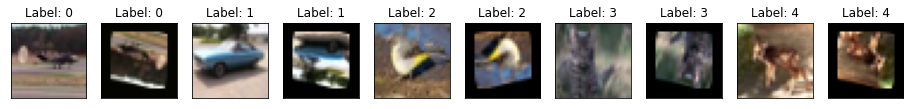

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


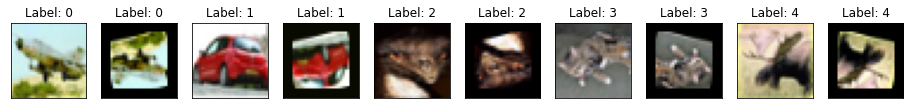

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.481155514717102  TestAcc: 0.5091000199317932
frog 0.783
ship 0.66
automobile 0.65
truck 0.55
horse 0.531
cat 0.491
airplane 0.47
dog 0.41
deer 0.303
bird 0.243


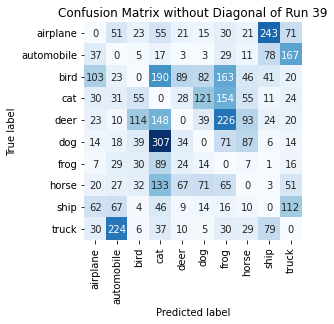

Summing down the rows, for Predictions of each Class that were wrong:  [ 326.  480.  308. 1022.  285.  364.  784.  359.  486.  495.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  89.0 times
Summing across the columns, for total number of that True Class misidentified:  [530. 350. 757. 509. 697. 590. 217. 469. 340. 450.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  226.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40 on Dataset TrainB_Zipped

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 ,

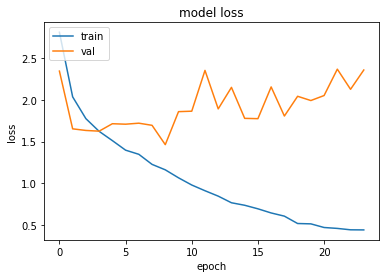

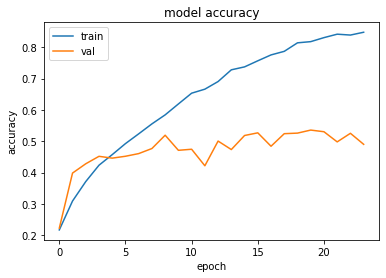

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.4627819061279297 , and Val Acc happened to be 0.5194000005722046
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5357999801635742 and Val Loss happened to be  1.9896209239959717
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


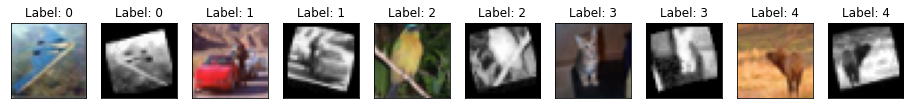

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


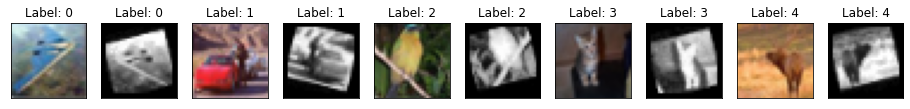

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


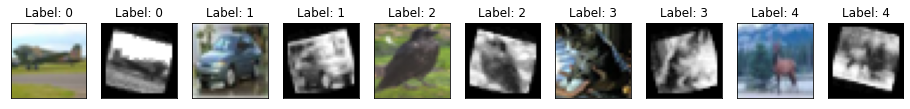

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


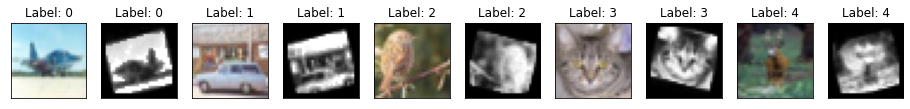

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


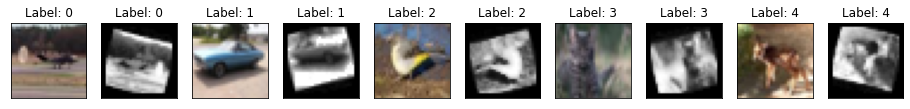

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


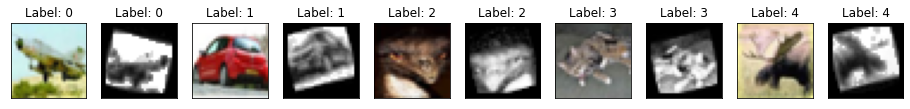

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4338477849960327  TestAcc: 0.5253000259399414
frog 0.77
automobile 0.667
ship 0.587
truck 0.584
horse 0.563
airplane 0.528
dog 0.493
bird 0.431
deer 0.324
cat 0.306


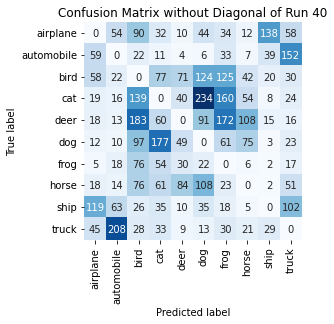

Summing down the rows, for Predictions of each Class that were wrong:  [353. 418. 737. 540. 307. 677. 656. 330. 256. 473.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  84.0 times
Summing across the columns, for total number of that True Class misidentified:  [472. 333. 569. 694. 676. 507. 230. 437. 413. 416.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  183.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41 on Dataset TrainB_Zipped

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )


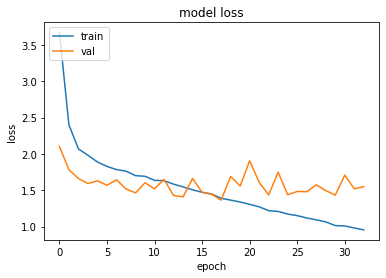

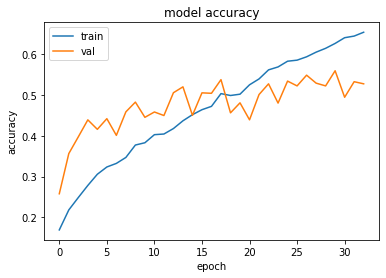

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.3648468255996704 , and Val Acc happened to be 0.5374000072479248
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5591999888420105 and Val Loss happened to be  1.4332737922668457
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


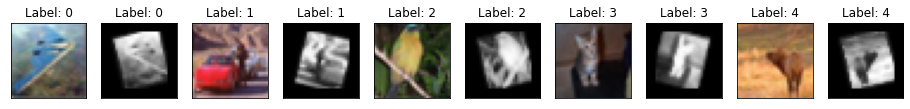

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


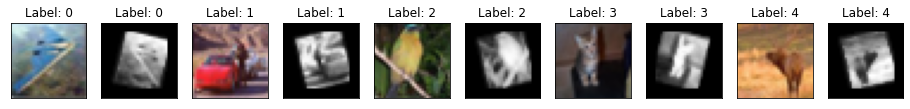

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


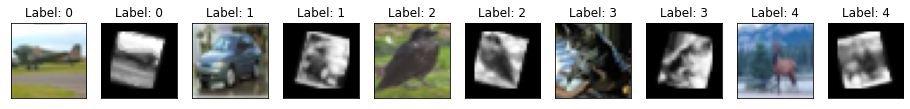

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


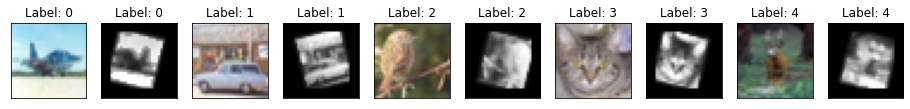

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


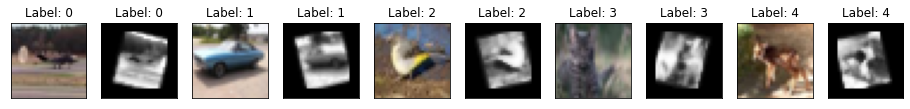

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


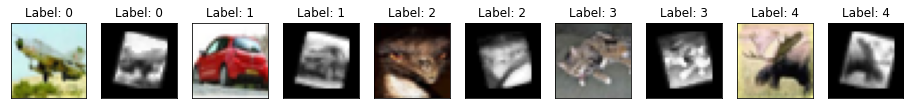

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3291561603546143  TestAcc: 0.535099983215332
frog 0.719
ship 0.702
truck 0.625
automobile 0.622
dog 0.612
horse 0.547
deer 0.448
airplane 0.386
cat 0.352
bird 0.338


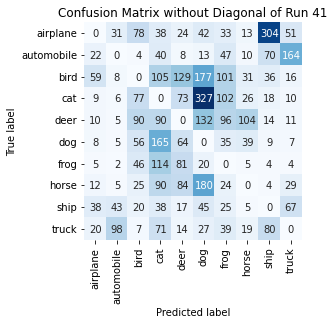

Summing down the rows, for Predictions of each Class that were wrong:  [183. 203. 403. 751. 494. 963. 502. 252. 539. 359.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  129.0 times
Summing across the columns, for total number of that True Class misidentified:  [614. 378. 662. 648. 552. 388. 281. 453. 298. 375.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  132.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42 on Dataset TrainB_Zipped

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , 

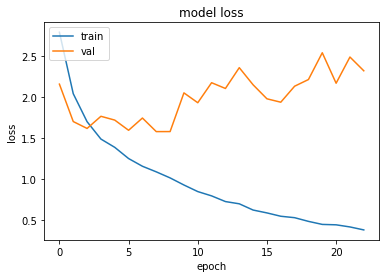

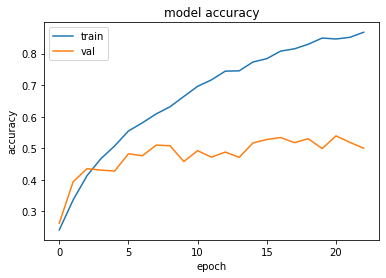

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.5753480195999146 , and Val Acc happened to be 0.5095999836921692
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.5390999913215637 and Val Loss happened to be  2.1653494834899902
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


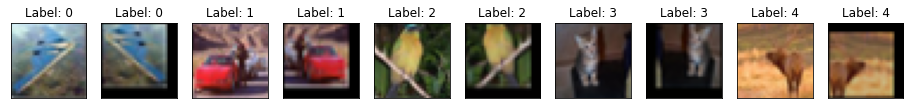

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


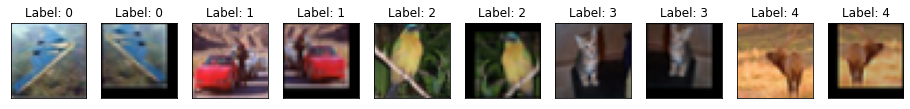

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


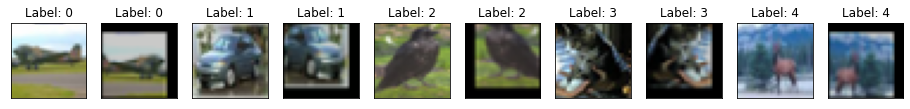

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


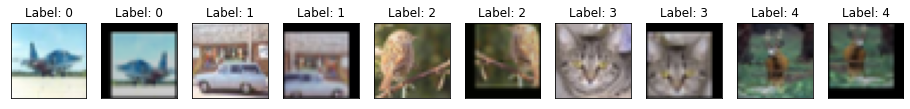

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


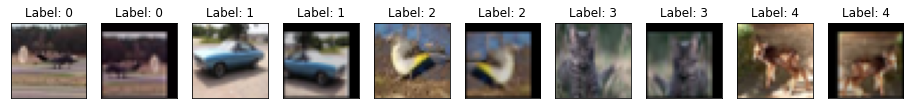

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


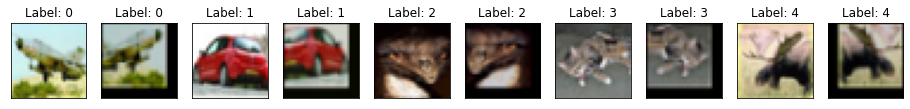

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5417953729629517  TestAcc: 0.5149999856948853
frog 0.777
ship 0.7
automobile 0.693
horse 0.622
truck 0.588
airplane 0.441
dog 0.352
cat 0.348
deer 0.343
bird 0.286


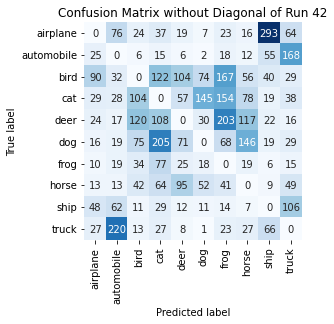

Summing down the rows, for Predictions of each Class that were wrong:  [282. 486. 429. 684. 397. 340. 711. 478. 529. 514.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  104.0 times
Summing across the columns, for total number of that True Class misidentified:  [559. 307. 714. 652. 657. 648. 223. 378. 300. 412.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  203.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43 on Dataset TrainB_Zipped

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , 

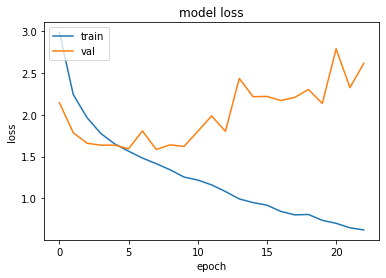

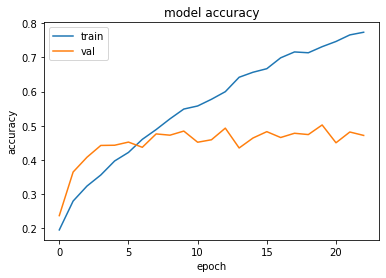

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.5854191780090332 , and Val Acc happened to be 0.4763000011444092
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5024999976158142 and Val Loss happened to be  2.137582778930664
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


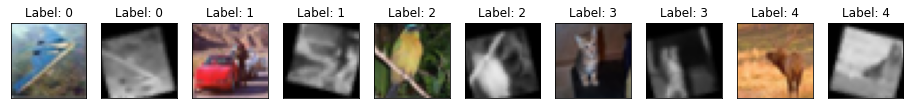

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


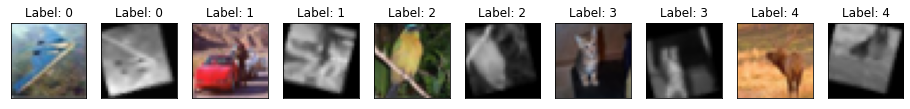

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


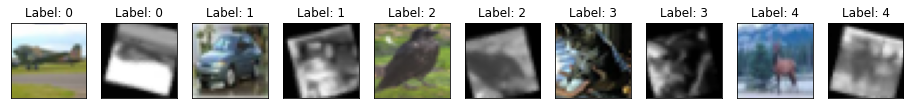

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


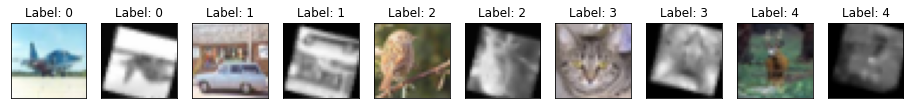

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


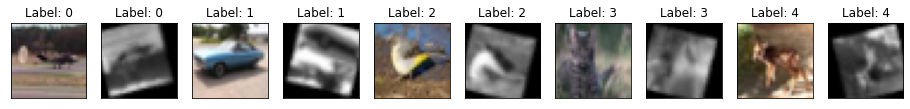

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


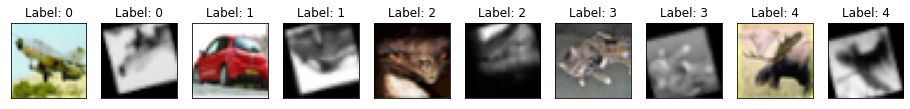

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.554819107055664  TestAcc: 0.4821000099182129
frog 0.736
ship 0.643
automobile 0.588
airplane 0.52
truck 0.476
horse 0.439
bird 0.386
cat 0.361
dog 0.349
deer 0.323


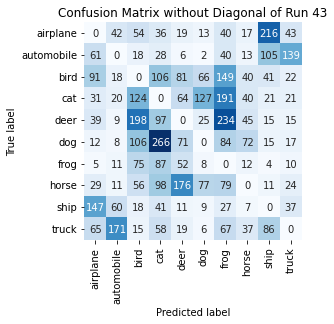

Summing down the rows, for Predictions of each Class that were wrong:  [480. 350. 664. 817. 499. 333. 911. 283. 514. 328.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [480. 412. 614. 639. 677. 651. 264. 561. 357. 524.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  234.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44 on Dataset TrainB_Zipped

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )

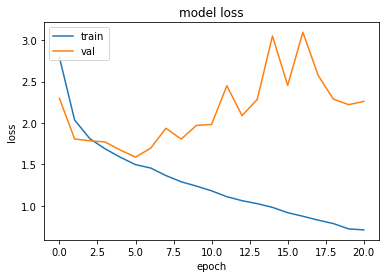

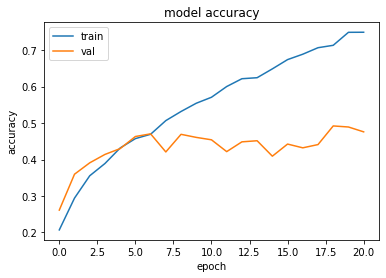

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.5859744548797607 , and Val Acc happened to be 0.46299999952316284
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.492000013589859 and Val Loss happened to be  2.287774085998535
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


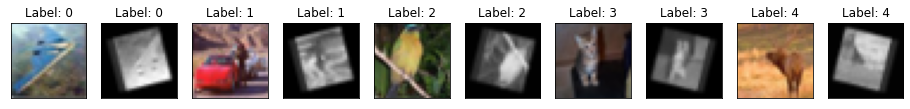

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


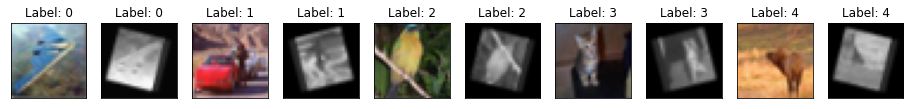

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


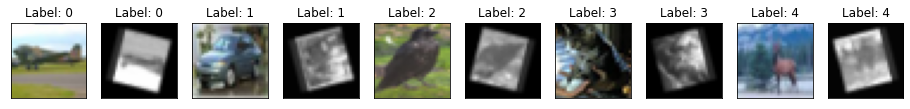

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


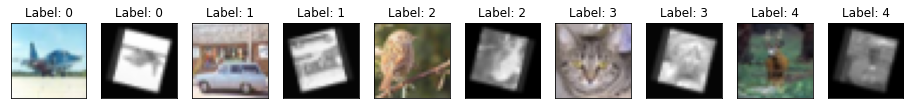

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


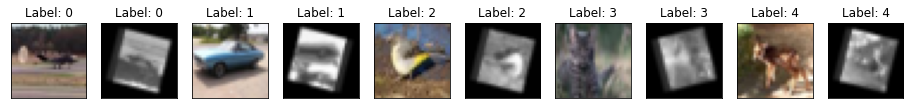

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


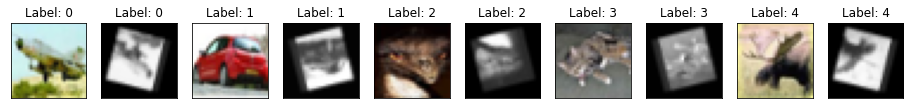

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5544559955596924  TestAcc: 0.4700999855995178
automobile 0.7
ship 0.616
frog 0.613
airplane 0.592
dog 0.48
horse 0.462
cat 0.44
truck 0.381
bird 0.326
deer 0.091


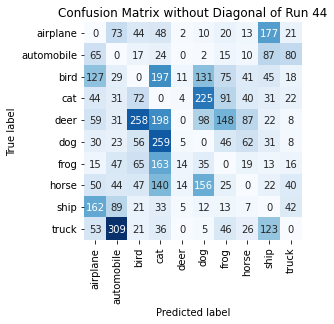

Summing down the rows, for Predictions of each Class that were wrong:  [ 605.  676.  601. 1098.   55.  674.  479.  305.  551.  255.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  14.0 times
Summing across the columns, for total number of that True Class misidentified:  [408. 300. 674. 560. 909. 520. 387. 538. 384. 619.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  258.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45 on Dataset TrainB_Zipped

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )


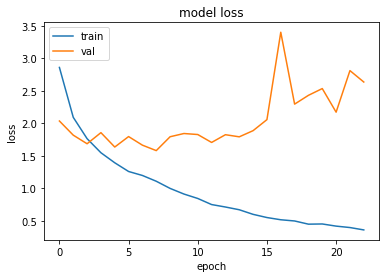

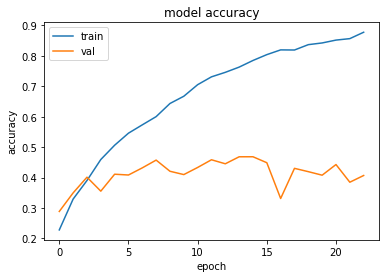

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.5780302286148071 , and Val Acc happened to be 0.45750001072883606
Additionally, the best val acc epoch happened to be  14 when val acc was:  0.4684999883174896 and Val Loss happened to be  1.8851581811904907
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


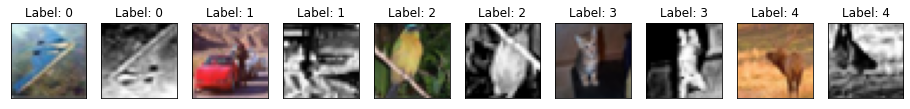

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


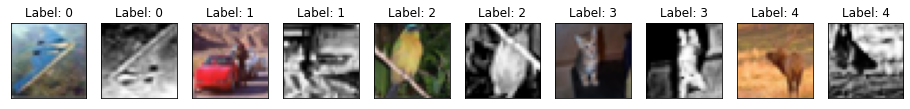

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


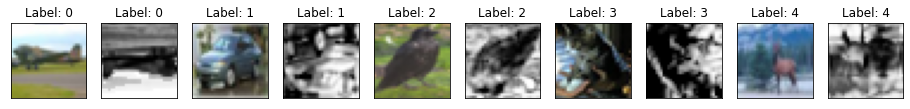

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


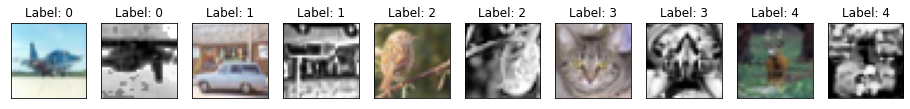

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


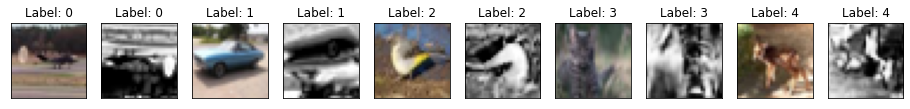

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


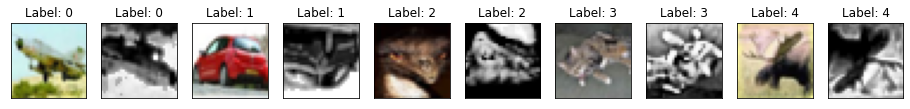

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5578176975250244  TestAcc: 0.4526999890804291
frog 0.737
ship 0.721
truck 0.505
horse 0.485
automobile 0.432
deer 0.431
cat 0.378
dog 0.357
airplane 0.328
bird 0.153


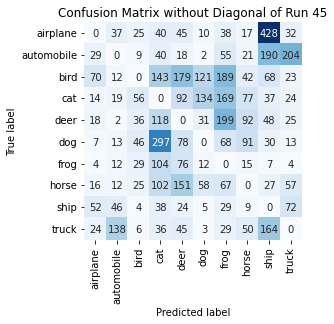

Summing down the rows, for Predictions of each Class that were wrong:  [234. 291. 236. 918. 708. 376. 843. 414. 999. 454.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  179.0 times
Summing across the columns, for total number of that True Class misidentified:  [672. 568. 847. 622. 569. 643. 263. 515. 279. 495.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  199.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46 on Dataset TrainB_Zipped

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )

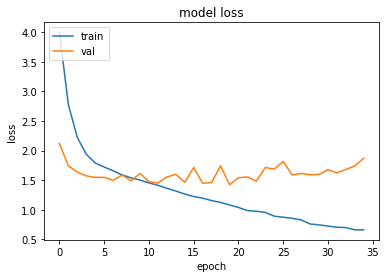

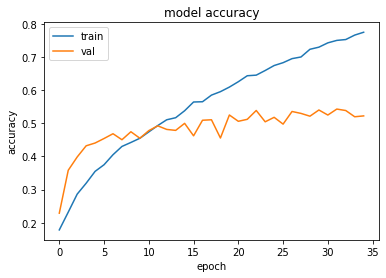

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.4243717193603516 , and Val Acc happened to be 0.5248000025749207
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5426999926567078 and Val Loss happened to be  1.6237236261367798
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


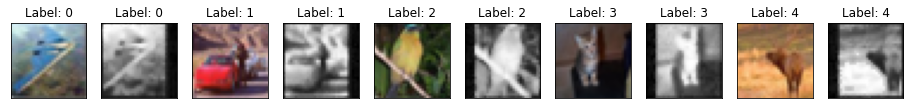

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


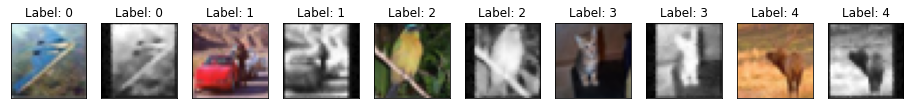

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


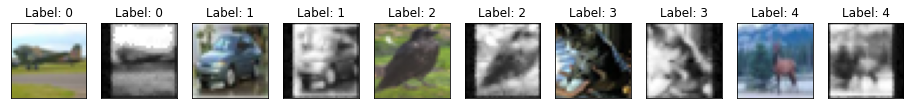

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


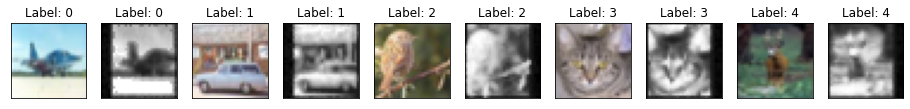

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


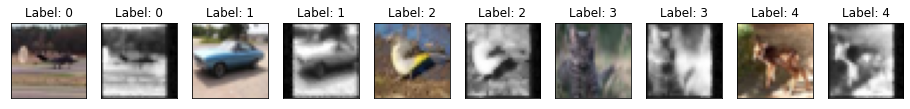

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


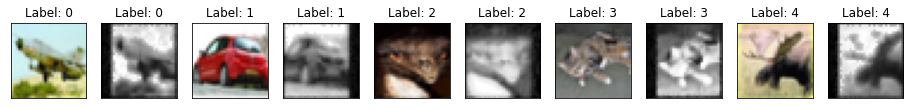

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3715475797653198  TestAcc: 0.5367000102996826
automobile 0.761
ship 0.673
truck 0.66
horse 0.627
dog 0.625
frog 0.61
airplane 0.517
deer 0.33
bird 0.324
cat 0.24


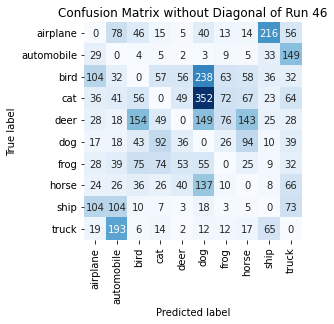

Summing down the rows, for Predictions of each Class that were wrong:  [ 389.  549.  430.  339.  246. 1004.  284.  428.  425.  539.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  56.0 times
Summing across the columns, for total number of that True Class misidentified:  [483. 239. 676. 760. 670. 375. 390. 373. 327. 340.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  154.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47 on Dataset TrainB_Zipped

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOu

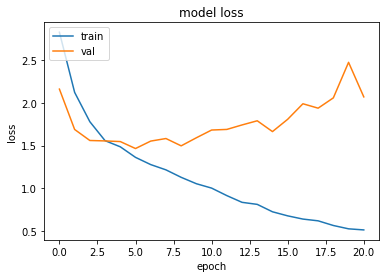

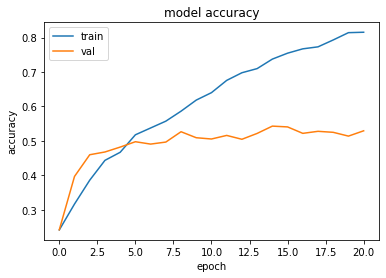

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.4652767181396484 , and Val Acc happened to be 0.4975000023841858
Additionally, the best val acc epoch happened to be  14 when val acc was:  0.5428000092506409 and Val Loss happened to be  1.663082242012024
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


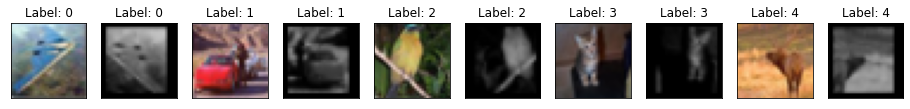

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


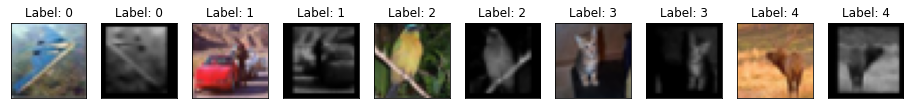

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


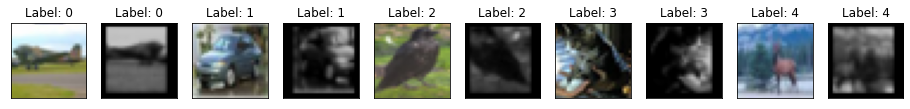

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


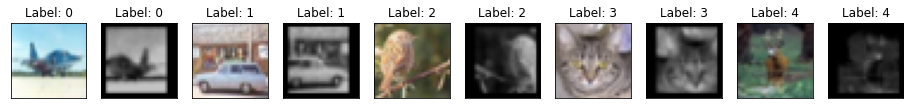

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


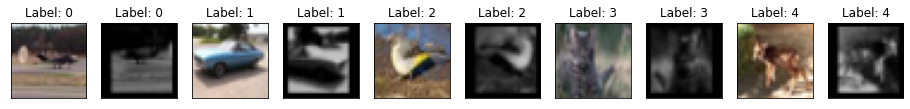

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


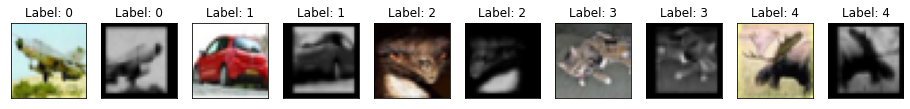

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4375965595245361  TestAcc: 0.4999000132083893
ship 0.726
frog 0.618
truck 0.618
automobile 0.563
horse 0.526
airplane 0.484
cat 0.445
dog 0.388
bird 0.364
deer 0.267


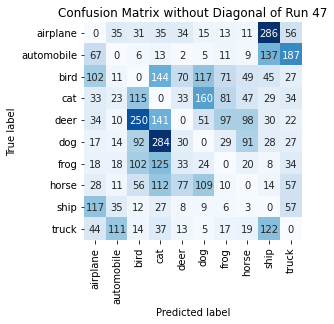

Summing down the rows, for Predictions of each Class that were wrong:  [460. 268. 678. 918. 300. 495. 335. 347. 699. 501.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  77.0 times
Summing across the columns, for total number of that True Class misidentified:  [516. 437. 636. 555. 733. 612. 382. 474. 274. 382.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  250.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48 on Dataset TrainB_Zipped

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
Zo

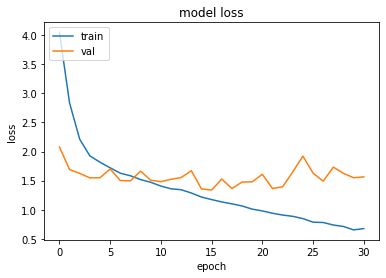

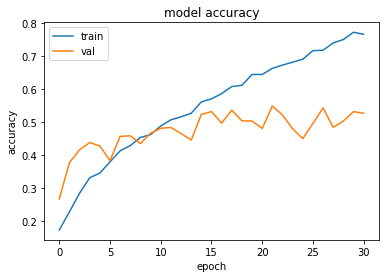

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.3378936052322388 , and Val Acc happened to be 0.5313000082969666
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.5480999946594238 and Val Loss happened to be  1.3636642694473267
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


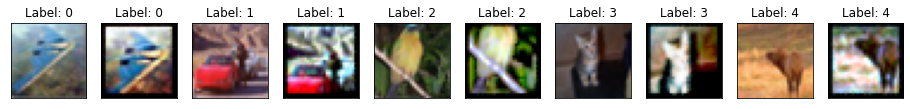

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


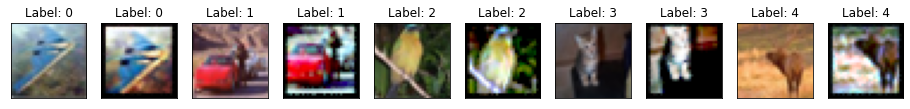

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


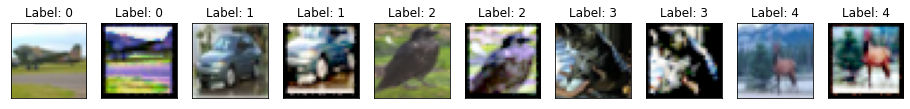

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


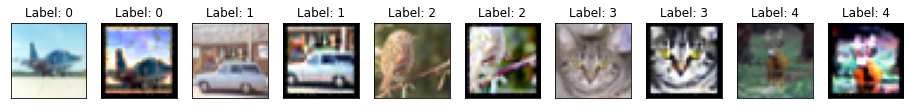

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


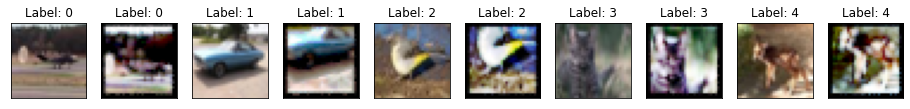

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


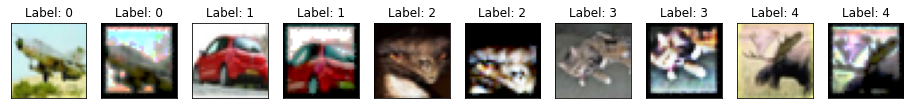

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.315181016921997  TestAcc: 0.5304999947547913
frog 0.707
automobile 0.677
ship 0.673
dog 0.642
truck 0.623
horse 0.591
airplane 0.454
deer 0.42
bird 0.265
cat 0.253


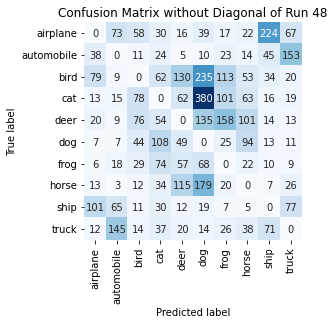

Summing down the rows, for Predictions of each Class that were wrong:  [ 289.  344.  333.  453.  466. 1079.  490.  412.  434.  395.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  130.0 times
Summing across the columns, for total number of that True Class misidentified:  [546. 323. 735. 747. 580. 358. 293. 409. 327. 377.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  158.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49 on Dataset TrainB_Zipped

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 

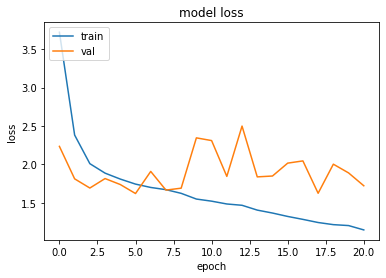

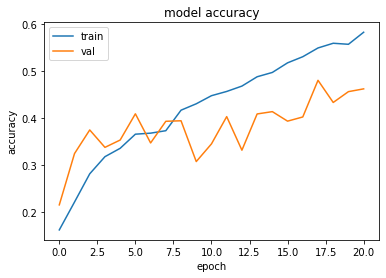

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.6197041273117065 , and Val Acc happened to be 0.4090999960899353
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.48030000925064087 and Val Loss happened to be  1.623247742652893
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


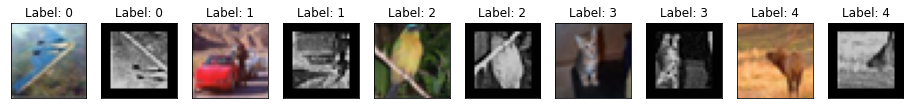

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


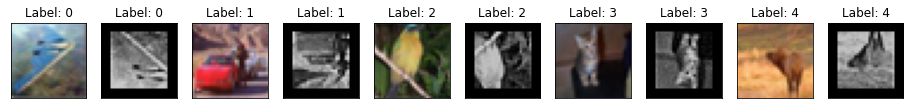

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


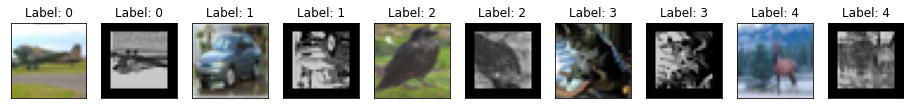

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


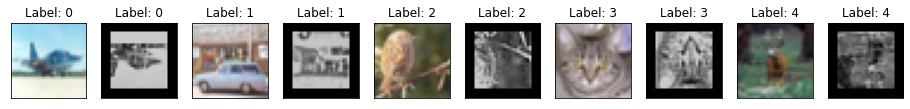

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


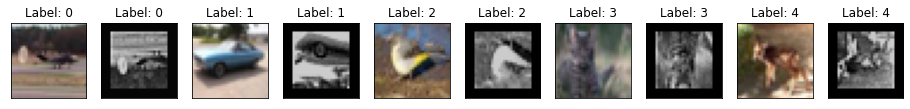

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


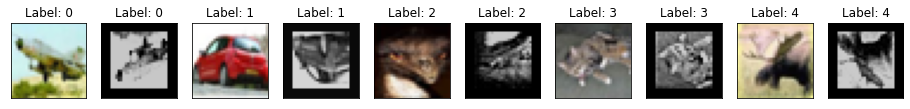

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5891602039337158  TestAcc: 0.41819998621940613
frog 0.891
automobile 0.593
ship 0.593
truck 0.517
airplane 0.386
deer 0.369
horse 0.351
dog 0.327
cat 0.088
bird 0.067


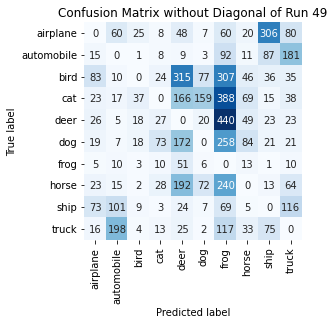

Summing down the rows, for Predictions of each Class that were wrong:  [ 283.  423.  117.  194. 1002.  353. 1971.  330.  577.  568.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  315.0 times
Summing across the columns, for total number of that True Class misidentified:  [614. 407. 933. 912. 631. 673. 109. 649. 407. 483.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  440.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50 on Dataset TrainB_Zipped

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -

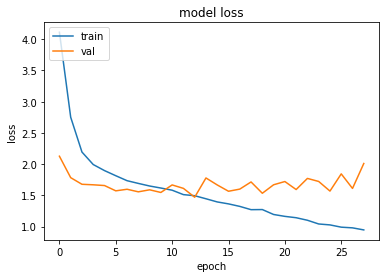

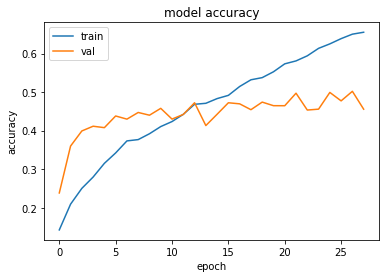

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4698554277420044 , and Val Acc happened to be 0.4724000096321106
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5020999908447266 and Val Loss happened to be  1.6107420921325684
num: 250
********************            Whole dataset first 10 images (not batched)            ********************


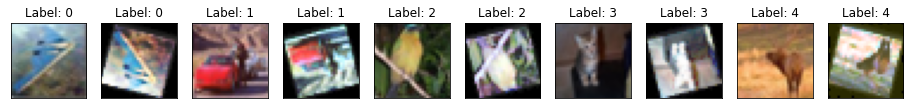

Total:  250  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


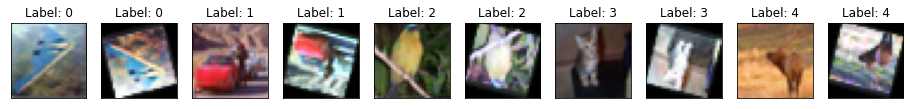

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


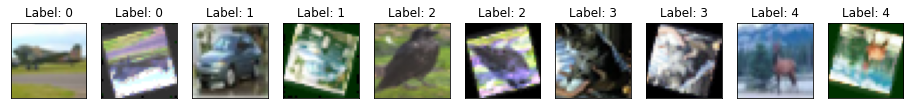

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


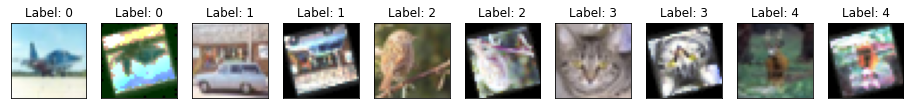

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


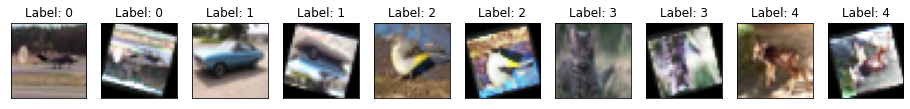

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


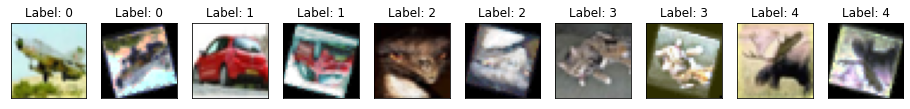

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4380749464035034  TestAcc: 0.48010000586509705
truck 0.642
dog 0.627
frog 0.56
automobile 0.545
airplane 0.528
ship 0.525
bird 0.512
horse 0.429
deer 0.247
cat 0.186


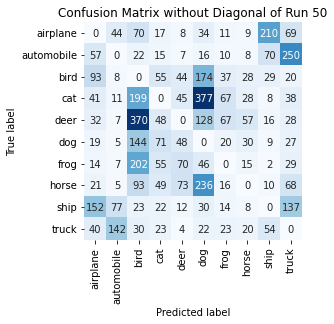

Summing down the rows, for Predictions of each Class that were wrong:  [ 469.  306. 1153.  355.  311. 1063.  265.  203.  408.  666.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  73.0 times
Summing across the columns, for total number of that True Class misidentified:  [472. 455. 488. 814. 753. 373. 440. 571. 475. 358.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  370.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Wed, 17 November 2021 06:42:28  (subtract ~5-hours for local Hour), and file is called  runs_GroupTrainB_Zipped_final.pkl


In [188]:
run_through_runs(ds=trainB_combined, ds_noalb=trainB_combined_noalb, dstitle = "TrainB_Zipped", showpictures=True)

In [189]:
run_through_runs(ds=trainA_combined, ds_noalb=trainA_combined_noalb, dstitle = "TrainA_Zipped", showpictures=True)

NameError: ignored

In [ ]:
run_through_runs(ds=trainD_combined, ds_noalb=trainD_combined_noalb, dstitle = "TrainD_Zipped", showpictures=True)

# Part 2 of  Testing:

Merged Groups of 2 
1. Group1_A_B
2. Group2_C_D
3. Group3_E_F
4. Group4_G_H

then later.. 

Merged Groups of 4
1. Group1_a_b_c_d
2. Group2_e_f_g_h

and finally

1. Group_all



num: 2500
Total:  2500  images in this dataset 
Total Class Count: (250, 250, 250, 250, 250, 250, 250, 250, 250, 250) 

********************            Whole dataset first 10 images (not batched)            ********************


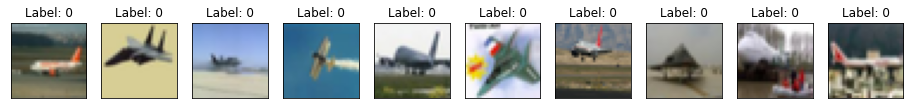

**********************************************************************************************


In [65]:
# train_A_noalb + train_B_noalb
# combine datasets I believe I need to add train_A_noalb, and train_B_noalb or just train_A+train_B and then send through no_augmentations...

# train_A = make_unbatched(train_A)
pretty_display_of_dataset(train_A, "A")
pretty_display_of_dataset(train_B, "B")
# pretty_display_of_dataset(train_C, "C")
train_AB = train_A.concatenate(train_B)
count_images(train_AB, "AB") #yes 5000 images total so I should shuffle 10000 once augmneted and then batch.... and then shuffle again for next "iteration"... i think... 
pretty_display_of_dataset(train_AB, "AB")


# ~~~~~~~~~~ No Augment Versions: ~~~~~~~~~~~~~~~~~~~~~~
train_AB_noalb = make_noalb(train_AB, "AB")



# Uncomment when ready to run
# train_CD = train_C.concatenate(train_D)
# train_EF = train_E.concatenate(train_F)
# train_GH = train_G.concatenate(train_H)
# Uncomment when ready to run
# train_CD_noalb = make_noalb(train_CD, "CD")
# train_EF_noalb = make_noalb(train_EF, "EF")
# train_GH_noalb = make_noalb(train_GH, "GH")



# # ---  Larger Groups of Four Single Groups ---
# train_ABCD = train_AB.concatenate(train_CD)
# train_EFGH = train_EF.concatenate(train_EF)

# # ~~~~~~~~~~ No Augment Versions: ~~~~~~~~~~~~~~~~~~~~~~
# train_ABCD_noalb = make_noalb(train_ABCD, "ABCD")
# train_EFGH_noalb = make_noalb(train_EFGH, "EFGH")

# # --- Largest Groups of Eight single Groups ---
# train_ALL = train_ABCD.concatenate(train_EFGH, "ABCDEFGH")
# train_ALL_noalb = make_noalb(train_ALL, "ABCDEFGH")


ds _input_dataset_class_name:  _UnbatchDataset
ds.class.name:  ConcatenateDataset
Train_AB_noalb_input_dataset_class_name:  MapDataset
Train_AB_noalb.class.name:  MapDataset
filename will be:  runs_GroupAB .pkl

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.2 , 0.2 )
Bright:   ( 0.2 , 0.2 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          1
pFancyPCA:          1
pChannelShuffle:    1
pElasticTransform:  1
pToGray:            

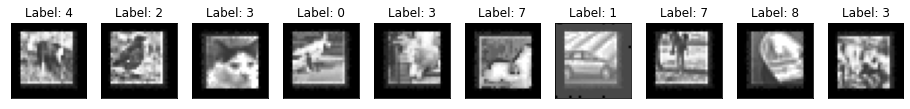

**********************************************************************************************
num: 2000
Total:  2000  batches in this dataset: 


 
Showing first 10 images of the first five batches
********************            Batch1 of newTrainX not batched            ********************


IndexError: ignored

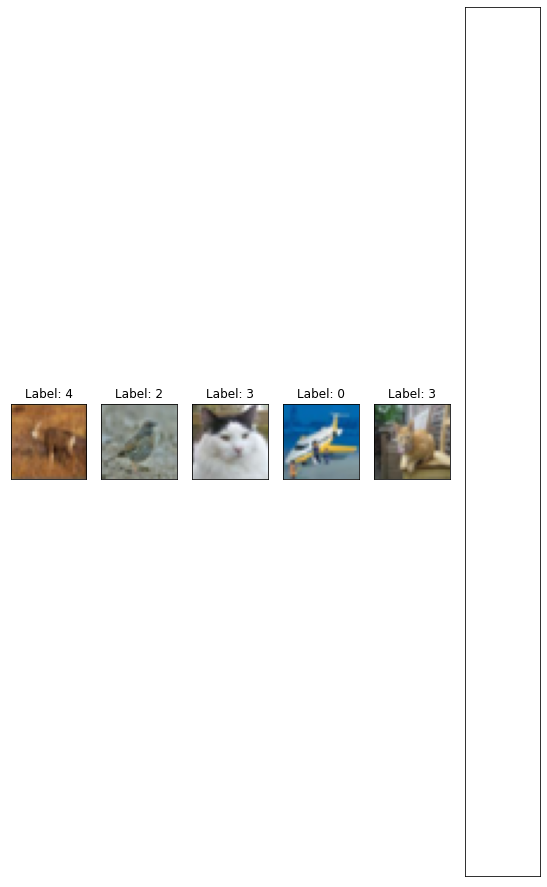

In [60]:
#@title Group AB: 51 Run Results { form-width: "80px" }
 
# run_through_runs(ds=make_unbatched(train_AB),  ds_noalb= train_AB_noalb, dstitle="AB" , showpictures= True)

# The above should work, but doesn't, so troubleshooting by unrolling the run_through_run code below
 
ds      = make_unbatched(train_AB)
ds_noalb= train_AB_noalb

print("ds _input_dataset_class_name: ", ds._input_dataset.__class__.__name__)
print("ds.class.name: ", ds.__class__.__name__)


print("Train_AB_noalb_input_dataset_class_name: ", ds_noalb._input_dataset.__class__.__name__)
print("Train_AB_noalb.class.name: ", ds_noalb.__class__.__name__)



dstitle="AB"
showpictures= True 

filename = "runs_Group" + dstitle
print("filename will be: ", filename, ".pkl")
originalfilename = filename


# ---------------------------------------------------------------------------
# Create Training-Group-Specific Dictionary to collect important metrics at the end of all runs 
# ----------------------------------------------------------------------------
Group_X_Runs = {}   #dictionary
# Group_X_Runs[run] = {'TestAccuracy': 0}


# ---------------------------------------------------------------------------
# For Loop of Runs
# when running the full design matrix, ensure ENDRUNS = 51  (50 + baseline run)
# the for loop will go through each run like this: df_experimentalruns.loc[run, "WhateverFactors"]:
# ----------------------------------------------------------------------------

ENDRUNS = 5
# assert ENDRUNS == 51

for run in range(3,ENDRUNS): 
  filename = originalfilename  #reset so you dont get Downloading "runs_GroupA.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl"


  # run = run + 1  # commented out after I added a Do-Nothing Run, I now have a real index 0 in the test-run-matrix  
  print("\n", (str(run) + " ")*50)
  print("\n   Begin Run: ", run)
  print("\n", (str(run) + " ")*50, "\n")


  #Use my vanilla CNN model function to build a  model with a certain dropout level
  model = makemodel(DROPOUT=df_experimentalruns.loc[run,'dropout'])

  # ------------------------------------
  # Create Run-Specific Transformations 
  # ------------------------------------

  # build  Albumentations list of transformations by passing each run's required parameters 
  list_of_transforms = augmentfunction( df_experimentalruns, run )

  # pass the list of transforms to Albumentations Compose function
  global transforms 
  transforms = A.Compose(list_of_transforms)


  # ------------------------------------
  # Create Augmented Dataset train_A_alb 
  # ------------------------------------

  # Augment the unbatched Training_Group_A through the Process_Data Function to create train_A_alb (albu = albumentations/augmentations)
  train_X_alb = augment_data(dataset = ds, process= process_data, dataset_text = "Augmented Dataset", )
  # print("train_X_alb created")




  print("Train_AB_alb_input_dataset_class_name: ", train_X_alb._input_dataset.__class__.__name__)
  print("Train_AB_alb.class.name: ", train_X_alb.__class__.__name__)

  pretty_display_of_dataset(train_X_alb, "Augmentations")


  # # ------------------------------------
  # # Create Non-Augmented Dataset train_A_noalb 
  # # ------------------------------------

  # moved outside of for-loop because problems

  # ------------------------------------
  # Print the number of total images in each unbatched dataset train_A_alb, and train_A_noalb 
  # -----------------------------------
  # removed because counting the items in a dataset is insanely time-expensive, unfortunately

  train_X_alb = make_batched(train_X_alb, batchnum= 5)
  ds_noalb = make_batched(ds_noalb, batchnum=5)

  # ------------------------------------
  # Merge/Concatenate Augmented and Non-Augmented into dataset: NEW_TRAIN_A,  then return the total count of images 
  # ------------------------------------

  new_train_X = ds_noalb.concatenate(train_X_alb)
  # print("new_train_X created")
  # print(new_train_X)
  # print("new Concatenateed Train_AB_w/alb and noalb_input_dataset_class_name: ", new_train_X._input_dataset.__class__.__name__)
  # print("new Concatenated Train_AB_w/alb andnoalb.class.name: ", new_train_X.__class__.__name__)



  pretty_display_of_dataset(new_train_X, "newTrainX not batched")   #not batched

  # at 9pm I switched the order of these because I think I'm not seeing no_aug until the very last batches? I need to shuffle the batches....
  #pretty_display_of_dataset(new_train_A, "New Training Set A - Merged with the Augmented, and Non-Augmented", opttext = "before batching")


  # ------------------------------------
  # Batch Consolidated Dataset  
  # ------------------------------------
  new_train_X_batch = 1000  #  
  tot_new_train_X =   10000 # should be 250*10*2 = 5000  #for FIRST groups but not COMBINED GROUP RUNS

  new_train_X= cache_prefetch_group(new_train_X,  SHUFFLE=tot_new_train_X, batch=new_train_X_batch, SEED = seed)
  
  # print("Concatenated, prefetched, caches, shuffled new_train_ABs inputdataset_class_name is:", new_train_X._input_dataset.__class__.__name__)
  print("Concatenated, prefetched, caches, shuffled batched new_train_ABs just class_name is:", new_train_X.__class__.__name__)
 


  # print("new_train_X batched")

  # ------------------------------------
  # Send Consolidated Dataset through Model & View Model Training Statistics Output 
  # ------------------------------------
  # take the created model from passing dropout, and pass the training data through it
 
  print("Training Model... ")
  modeltrained = trainmodel(MODEL = model, TRAININGDATA= new_train_X)

  # ------------------------------------
  # See pictures that were sent through model, up to five batches
  # ------------------------------------
  if showpictures == True:
    pretty_display_of_dataset(new_train_X, dstitle, ) 


  # ------------------------------------
  # Test Statistics for Model 
  # ------------------------------------
  # Retrieve the TEst Loss and Accuracy after training is complete
  loss, acc = modeltrained.evaluate(x_test, verbose=0) 
  print("TestLoss: ", loss, " TestAcc:", acc)



  # ------------------------------------
  # Get Predictions from Test Set to use in Confusion Matrix
  # ------------------------------------

  #Get the predictions of Y_hat from passing X_Test into the model
  y_pred = modeltrained.predict(x_test)

  # The Y_Hats are y_pred of continuous probabilities into a 1-coded label vectors
  y_pred_1hot = np.argmax(y_pred, axis=1)
  cm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] ) 
  cm_norm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9], normalize ='true' ) 
  # disp = ConfusionMatrixDisplay(cm, display_labels=['airplane', 'automobile','bird','cat','deer','dog','frog','horse','ship','truck']).plot()
  make_accuracy_dictionary(cm_norm)

  # confusion_matrix(y_true = y_test, y_pred = y_pred_1hot )
  #def show_confusion_matrix_wo_diagonal(test_labels, predictions, CLASSES):
  show_confusion_matrix_wo_diagonal(y_test, y_pred_1hot, CLASSES = CLASSES, run=run)

  # ------------------------------------
  # Save every 10 runs and final file
  # ------------------------------------
  Group_X_Runs[run] = {'TestAccuracy': acc, 'TestLoss': loss, 'CM': cm, 'CM_norm': cm_norm}

  


So far in my effort to concatenate groupA and groupB and run it through the model, it's taken at least 20 minutes to just count the number of images in each class, display the images, and another 5 minutes to run Run0 through the CNN.   At ~25 minutes per run it would take about ~1275 minutes per Group.  There are 7 more groups, that's 8925 minutes, or 148 hours.  Obviously I cant display images for each run or that would take forever.  At 33 minutes I'm not even done running Run 1.

Looking for a faster way to count the dataset, SO, user says \\
`ds.map(lambda x: 1, num_parallel_calls=tf.data.experimental.AUTOTUNE).reduce(tf.constant(0), lambda x,_: x+1) `

In [ ]:
# ds.map(lambda x: 1, num_parallel_calls=AUTOTUNE).reduce(tf.constant(0), lambda x: 1)


# Post-Test: Process Results

After the 51 runs for the single groups have been run, its time to load the results into JMP to Fit the Definitive Screening Design and find which Main Effects have the most compeling effect.   

* I need to get my pickle files unloaded into a dataframe to put in a CSV.

* I had unintentionally created an effect that was captured by my blocking variable (early October?), but have since fixed it.  Original results here -- "[GroupA_Test1](https://github.com/RachelRamirez/CIFAR-10/blob/main/CollectionofTests/Test1GroupA.ipynb)" 



---



as of 11/11/21 its  ** ~9 hours** to run   9 Groups with 51 Runs, at about 45 epochs each.  If I ran it again with GroupA (10th GRoup) it would probably be about 10.5 hours total to this point.  Also note that is just training and capturing results, not diplaying any images thru augmentations, as displaying images and counting the number in each batch is extremely time consuming.  I think it makes one experimental run take at least 20 minutes, so  20times longer overall.

In [ ]:
import pickle
import numpy as np
import csv
# what does a flattened confuion matrix look like 


#define a list of the pickle files
list_of_pickle_file_names = ['runs_GroupB_final.pkl', 
                             'runs_GroupC_final.pkl', 
                             'runs_GroupD_final.pkl', 
                             'runs_GroupE_final.pkl', 
                             'runs_GroupF_final.pkl', 
                             'runs_GroupG_final.pkl', 
                             'runs_GroupH_final.pkl', 
                             'runs_GroupI_final.pkl', 
                             'runs_GroupJ_final.pkl']

list_of_group_names = ["B", "C", "D", "E", "F", "G", "H", "I", "J"]

# runsA, runsB, runsC, runsD, runsE, runsF, runsG, runsH, runsI, runsJ = {}, {} , {}, {}, {}, {}, {}, {}, {}, {} #is there a better way to define these many variables? 
# polease notice i left out runsA because I don't have the pickle file from the day B-G were run

runsA = runsB =  runsC = runsD = runsE = runsF =  runsG =  runsH =  runsI =  runsJ = []

# list_of_unpickled_names = [runsB, runsC, runsD, runsE, runsF, runsG, runsH, runsI, runsJ]
# Later? Create a dictionary by zipping together two lists itno tuples
# fields = ["Seed", "Group", "Run", "TestAcc", "TestLoss", "ConfusionMatrix"]
# values = [42, "Z", 999, 0.0, 0.0, [range(100)]]
# a_dict = dict(zip(fields, values))
# a_dict
 
ds = {}

#for enumerate () zip the 9 pickle files:
for Z, pkl, in zip(list_of_group_names, list_of_pickle_file_names): #list_of_unpickled_names):
  
  with open(pkl, 'rb') as fid:
     ds[Z] = pickle.load(fid)
  print("dataset", Z, " loaded from", pkl)

#To reference a Group say ds["Letter"][RunInt]["Metric"]
 
#can i just replace it Group , and each run, with this function? It'd be ice if i could map it.. versus a for loop of doomr
rows = []
for i in (list_of_group_names):
  for run in range(0,51):             #<!!---------------------------------------------------------------------------------- change back to 51
    cm_flat = (ds[i][run]["CM"]).flatten(order="C")
    # cm_norm_flat = (ds[i][run]["CM_norm"]).flatten(order="C")
    print(cm_flat)
    cm_flat_new = cm_flat.flatten()
    # print("new", cm_flat_new)
    # row = [i, run, ds[i][run]["CM"], ds[i][run]["CM_norm"] ]
    # rows.append(row)


print(rows)

#Check ds["B"][23]["CM_norm"] #yup
 
# -------------------------------------------------------------------------------------- 
# How to put information in a CSV file?
# Try this: https://www.tutorialspoint.com/How-to-save-a-Python-Dictionary-to-CSV-file
#
# --------------------------------------------------------------------------------------

counter = 0
import csv
# my dictionary is ds
with open('allgroups_allruns_seed42.csv', 'w') as f:
  for key in ds.keys():
    for key2 in ds[key].keys():
      (key3, key4, key5, key6)  = ds[key][key2].keys()
      


      # Working Code don't tinker wth!
      cm_flat = np.array(ds[key][key2][key5]).flatten()
      cm_norm_flat = np.array(ds[key][key2][key6]).flatten()
      csvwriter=csv.writer(f, delimiter="," )
      # the prob with below is it doesnt give each item in the cm its own column 
      # so i refere to SO and found this https://stackoverflow.com/questions/67125762/convert-an-array-column-into-multiple-columns-python
      csvwriter.writerow([key, key2, ds[key][key2][key3], ds[key][key2][key4],  cm_flat, cm_norm_flat   ])

# https://stackoverflow.com/questions/67125762/convert-an-array-column-into-multiple-columns-python


#to save space i need key3 to all print on one line, otherwise excel csv file will be 10*51*4*10*10 rows = ~20,000 rows? bc flatten hasnt yet worked on cm and cm_norm

# Create Data frame?

# import pandas as pd
# df_B = pd.DataFrame( data=ds['B'],   )
 
break



# new_dictionary = {'Group':                 
#                   {'Run': 
#                    {
#                   'TestAcc': 'Value',
#                   'TestLoss': 'Value',
#                   'CM': [],
#                   'CM_norm': []}}}

# new_dictionary['Group']
# new_dictionary_list_of_metrics = 'TestAcc', 'TestLoss', 'CM', 'CM_norm'
# ds["B"][3]




# my dictionary is ds
with open('allgroups_allruns_seed42.csv', 'w') as f:


counter = 0
new_dataframe = []

for key1_group in ds.keys():
    for key2_run in ds[key1_group].keys():
      for key3_metrics, newdict_metric in zip(ds[key1_group][key2_run].keys(), new_dictionary_list_of_metrics):
        # new_dictionary[key1_group][key2_run][newdict_metric] = ds[key1_group][key2_run][key3_metrics]
        counter +=1
        #ok now i realize i did things correctly after all because this is an exact replicate of what I already have... arrrrrrrrrggggggg
    print(counter)





#the first key of "key3" is TestAccuracy


# from collections import defaultdict
# d = defaultdict(list)
# for k, v in ds['B'].items():
#     d[v].append(k)
# printdict(d))

break

files.download("allgroups_allruns_seed42.csv")
# Desire the following format 1-SeedCol, 2-GroupCol, 3-RunCol, 4-TestAcc-Col, 5-TestLossCol, (6,105)100 Columns CM, (106, 205) 100 Columns CM_norm 
#[Seed#] [Group_Letter {A-J}] [Run#] [TestAccuracy] [TestLoss] [Flatten 10X10 Confusion Matrix into 1x100]
 
 #lets see how close... oh good lord that's ugly... 





  #this file originally saved 11-5-2021 from 1 each testset

# lastruns_groupA_loaded

# string_of_cm = " "
# y = {}

# # test
# # string_of_cm = string_of_cm + np.array2string(lastruns_groupA_loaded[0]["CM"][0][0]) + " "
# print("Run ,", "Test Accuracy ,", "Test Loss,", "Confusion Matrix Diagonals," "Normalized Confusion Matrix" )
 
# CM_digit = []

# for i in range(0,ENDRUNS):
#   for x in range(0,10):
#     #string_of_cm = string_of_cm + np.array2string(lastruns_groupA_loaded[i]["CM"][x][x]) + ", "
#     CM_digit = lastruns_groupA_loaded[i]["CM"][x][x] + CM_digit
#   y[i] = lastruns_groupA_loaded[i]['TestAccuracy'], lastruns_groupA_loaded[i]["TestLoss"], CM_digit 
#   print(y[i])
#   CM_digit = [] #clear?

# lastruns_groupA_loaded[1]["TestAccuracy"]
# lastruns_groupA_loaded[1]["CM"][:,0].sum()  #666 Predicted Class 0?
# lastruns_groupA_loaded[1]["CM"][0,:].sum()  #1000 True Class 0?
# lastruns_groupA_loaded[1]["CM"][1,:].sum()  #1000 True Class 1?

# sum_of_cm_diagonals = 0
# for i in range(10):
#   sum_of_cm_diagonals = sum_of_cm_diagonals + lastruns_groupA_loaded[1]["CM"][i,i]    

# print("Sum of Diagonals on Confusion Matrix of Run 1: ", sum_of_cm_diagonals) #checks with TestAccuracy


# #I want to find the area of greatest confusion

# #create a new matrix to not ruin previious CM
# confusion_matrix_wo_diagonal = lastruns_groupA_loaded[1]["CM"].copy()
 
# for i in range(10):
#   confusion_matrix_wo_diagonal[i,i] = 0 # set the diagonal equal to zero
# print(confusion_matrix_wo_diagonal)
# # for i in range(10):
# #   print(i, "is most often miscategorized as ", np.argmax(confusion_matrix_wo_diagonal[:,i]), " ", max(confusion_matrix_wo_diagonal[:,i]), " times")

# for i in range(10):
#   print("The algorithm predicted a ", np.argmax(confusion_matrix_wo_diagonal[i,:]),"instead of a ",  i, " ", max(confusion_matrix_wo_diagonal[i,:]), "times")



# print("Summing down the rows, for COLUMN total: ", confusion_matrix_wo_diagonal.sum(axis=0))
# print("Summing across the columns, for ROW total: ", confusion_matrix_wo_diagonal.sum(axis=1))

In [ ]:
# https://www.tutorialspoint.com/python-convert-list-of-nested-dictionary-into-pandas-dataframe
# Example
import pandas as pd


#print(list)
rows = []

# appending rows
for key in dictionary_fruit.keys():
   data_row = dictionary_fruit[key]
   n = data['Name']

   for row in data_row:
      row['Name'] = n
      rows.append(row)

   # using data frame
df = pd.DataFrame(rows)

df = df.pivot_table(index='Name', columns=['Quality'],
               values=['Price']).reset_index()
print(df)


something weird about the above code.  My confusion matrix looks like its lost the diagonals. I think copying to confusion_matrix_wo_diagonal didn't do a separate copy, it is just linked, so when I cleared the diagonal of confusion_matrix_wo_diagonal, it also cleared it from lastruns_groupsA_loaded[1]["CM"]


In [ ]:
lastruns_groupA_loaded[0]["CM"]

In [ ]:
confusion_matrix_wo_diagonal.sum() + sum_of_cm_diagonals

In [ ]:
# string_of_cm = ""

# for i in range(1,2):  # goes through first n runs with CMs
#   for x in range(10): # goes through the n items in diagonal of each run.CM
#     string_of_cm = string_of_cm + np.array2string(lastruns_groupA_loaded[i]["CM"][x][x]) + ","
#     y[i] = lastruns_groupA_loaded[i]['TestAccuracy'], lastruns_groupA_loaded[i]["TestLoss"], string_of_cm 
#   print(y[i])
  

# lastruns_groupA_loaded[1]["TestAccuracy"]
# lastruns_groupA_loaded[1]["CM"][:,0].sum()  #666 Predicted Class 0
# lastruns_groupA_loaded[1]["CM"][0,:].sum()  #1000 True Class 0
# lastruns_groupA_loaded[1]["CM"][1,:].sum()  #1000 True Class 1

# sum_of_cm_diagonals = 0
# for i in range(10):
#   sum_of_cm_diagonals = sum_of_cm_diagonals + lastruns_groupA_loaded[1]["CM"][i,i]    

# print("Sum of Diagonals on Confusion Matrix of Run 1: ", sum_of_cm_diagonals) #checks with TestAccuracy


# #I want to find the area of greatest confusion

# #create a new matrix to not ruin previious CM
# confusion_matrix_wo_diagonal = lastruns_groupA_loaded[1]["CM"].copy()
 
# for i in range(10):
#   confusion_matrix_wo_diagonal[i,i] = 0 # set the diagonal equal to zero
# print(confusion_matrix_wo_diagonal)
# # for i in range(10):
# #   print(i, "is most often miscategorized as ", np.argmax(confusion_matrix_wo_diagonal[:,i]), " ", max(confusion_matrix_wo_diagonal[:,i]), " times")

# for i in range(10):
#   print("The algorithm predicted a ", np.argmax(confusion_matrix_wo_diagonal[i,:]),"instead of a ",  i, " ", max(confusion_matrix_wo_diagonal[i,:]), "times")



# print("Summing down the rows, for COLUMN total: ", confusion_matrix_wo_diagonal.sum(axis=0))
# print("Summing across the columns, for ROW total: ", confusion_matrix_wo_diagonal.sum(axis=1))



---



# All single Group' Results (Do Not Run)

This is Group A, Group B, Group C, ... through Group J results going throught the 50   + baseline augmentations

In [ ]:
break #!!!!!!!!!!!!!!!!!!
break #!!!!!!!!!!!!!!!!!!
break #!!!!!!!!!!!!!!!!!!

#APPARENTLY THIS DOESNT WORK :-( 

In [62]:
#@title Group A 51 Run Results
run_through_runs(ds=make_unbatched(train_A), ds_noalb=train_A_noalb, dstitle="A" , showpictures= True)  #Even though I ran this before, I'm curious if the images and augmentations are repeatable

filename will be:  runs_GroupA .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


Training Model... 


KeyboardInterrupt: ignored

Group B: 51 Run Results

In [63]:
#@title GroupB 51 Run Results
run_through_runs(ds=make_unbatched(train_B), ds_noalb=train_B_noalb, dstitle="B" , showpictures= True)


filename will be:  runs_GroupB .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


Training Model... 


KeyboardInterrupt: ignored

In [ ]:
#@title Group C: 51 Run Results
 
run_through_runs(ds=make_unbatched(train_C),  ds_noalb= train_C_noalb, dstitle="C" , showpictures= False)


In [ ]:
#@title Group D: 51 Run Results

run_through_runs(ds=make_unbatched(train_D),   ds_noalb=train_D_noalb,   dstitle="D" , showpictures= False)


In [ ]:
#@title Group E: 51 Run Results

run_through_runs(ds=make_unbatched(train_E),     ds_noalb=train_E_noalb,   dstitle="E" , showpictures= False)

In [ ]:
#@title Group F: 51 Run Results
 
run_through_runs(ds=make_unbatched(train_F),  ds_noalb=train_F_noalb, dstitle="F" , showpictures= False)

In [ ]:
#@title Group G: 51 Run Results
run_through_runs(ds=make_unbatched(train_G),    ds_noalb=train_G_noalb, dstitle="G" , showpictures= False)

In [ ]:
#@title Group H: 51 Run Results
run_through_runs(ds=make_unbatched(train_H),   ds_noalb= train_H_noalb, dstitle="H" , showpictures= False)

In [ ]:
#@title Group I: 51 Run Results
run_through_runs(ds=make_unbatched(train_I),   ds_noalb=train_I_noalb,   dstitle="I" , showpictures= False)

In [ ]:
#@title Group J: 51 Run Results
run_through_runs(ds=make_unbatched(train_J),  ds_noalb= train_J_noalb, dstitle="J" , showpictures= False)

## Time Required: 10 hours



In [ ]:
stop_testing = time.time()
print((stop_testing - tic) , "secs to  run everything start to end, or... ")
print((stop_testing - tic)/60, "minutes ... or ")
print((stop_testing - tic)/3600, "hours ")